In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
from scipy.interpolate import interp1d, interp2d
import sofi
import sofiism as si
from time import time
from scipy import signal
import pandas as pd
from gaussfitter_as import gaussfit
import cv2
import gaussfitter as gs
from scipy.optimize import curve_fit

In [42]:
s=np.load('5uw20mhz_3_7_bin_100ns_v2.npy')
print(np.min(s))

0


In [43]:
scans=np.zeros((1,s.shape[0],s.shape[1],s.shape[2],s.shape[3]+1))
scans[0,:,:,:,:-2]=np.concatenate((s[:,:,:,:14],s[:,:,:,15:]),axis=3)

In [44]:
del(s)

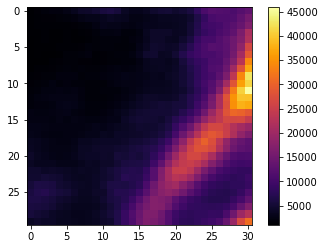

In [45]:
plt.imshow(scans.sum(axis=(0,1,4)))
plt.colorbar()

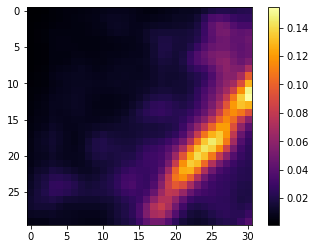

In [143]:
plt.imshow(si.ac1_image(scans,vx,vy))
plt.colorbar()

In [46]:
scans.shape

(1, 250000, 30, 31, 24)

In [16]:
scans=si.rebin(scans,1000)

ValueError: axes don't match array

25.82009375
0.0
0


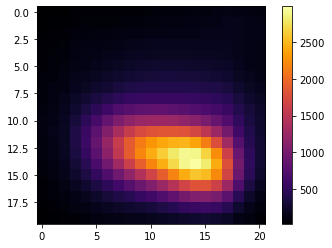

In [20]:
plt.imshow(si.ac1_image(scans,vx,vy))
plt.colorbar()
print(np.min(si.ac1_image(scans,vx,vy)))
print(np.min(scans))
print(np.min(s))


In [59]:
h=si.ac1_image(scans,va,vb)
centers=si.find_max_index(h)
res=photon_finder_gaussians(h, centers)

In [60]:
sigma=(abs(res['sx'][0])+abs(res['sy'][0]))/2

In [62]:
sigma*100

173.70619156735106

In [9]:
scans.shape

(1, 50, 30, 31, 24)

In [10]:
scans2=np.zeros((scans.shape[0],scans.shape[1],scans.shape[2]+10,scans.shape[3]+10,scans.shape[4]))
scans2[:,:,10:,10:,:]=scans

0


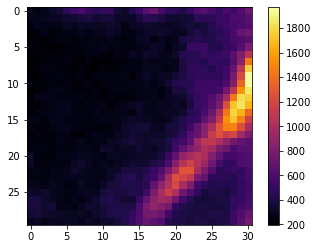

1


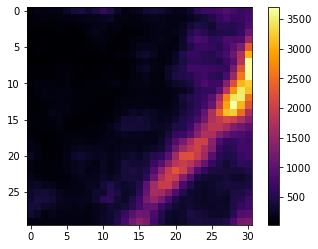

2


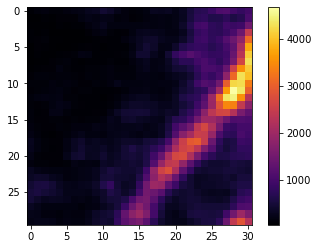

3


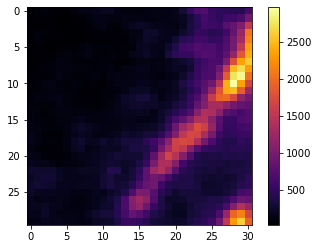

4


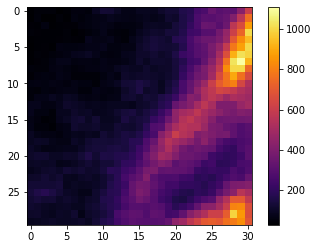

5


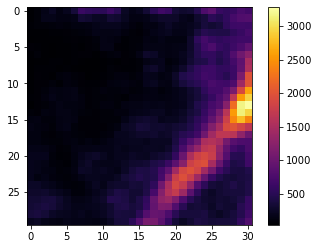

6


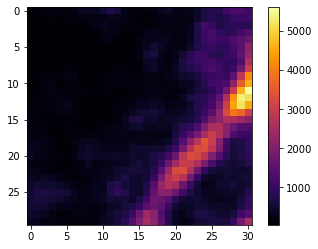

7


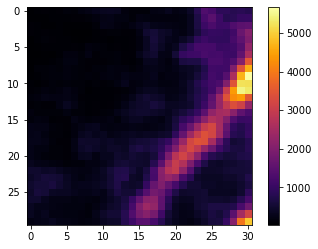

8


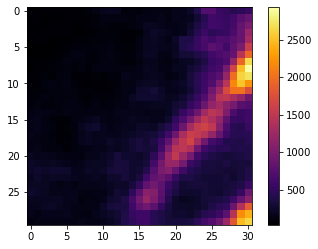

9


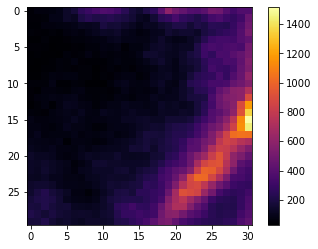

10


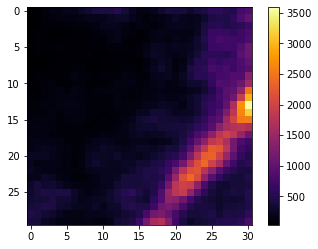

11


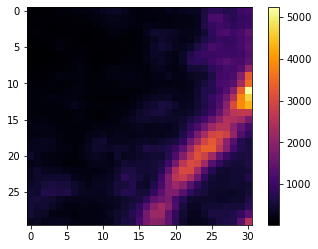

12


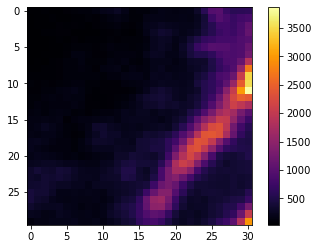

13


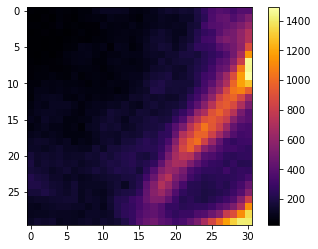

14


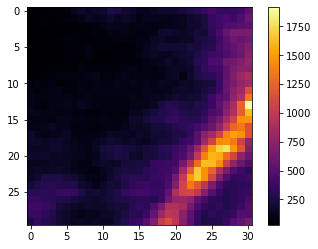

15


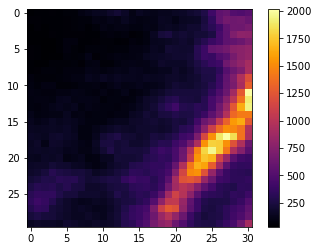

16


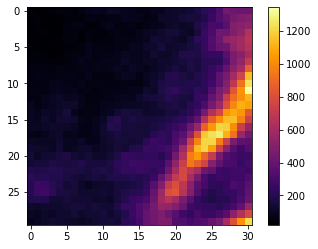

17


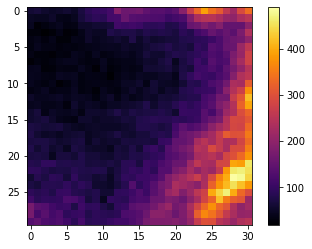

18


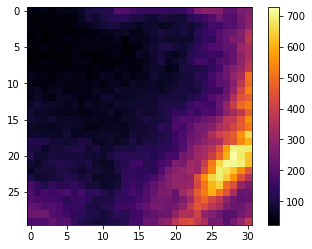

19


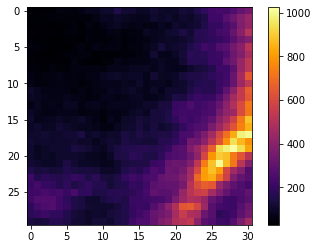

20


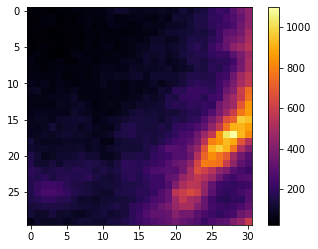

21


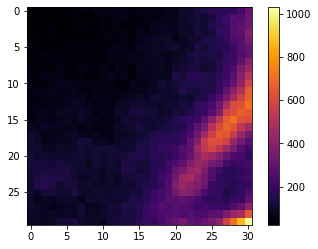

22


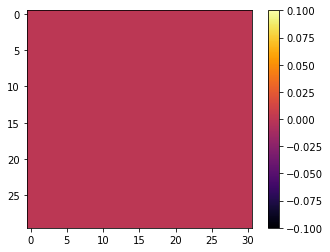

23


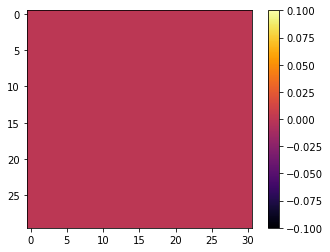

In [47]:
for i in range(scans.shape[-1]):
    plt.imshow(scans[0,:,:,:,i].sum(axis=(0)))
    print(i)
    plt.colorbar()
    plt.show()

In [8]:
scans.shape

(1, 250000, 30, 31, 24)

In [7]:
scans=scans[:,:,:,:,[0,1,2,3,4,5,6,7,8,9,10,11,12,13,15,16,17,18,19,20,21,22,23]]

IndexError: index 24 is out of bounds for axis 4 with size 24

In [ ]:
del(scans)

0


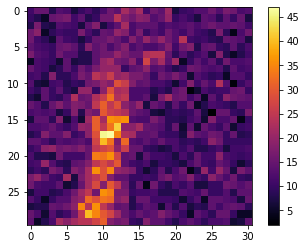

1


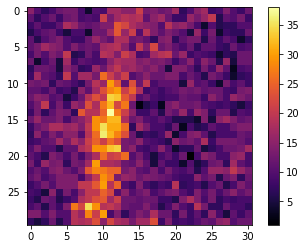

2


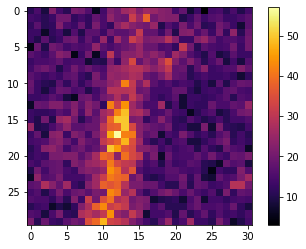

3


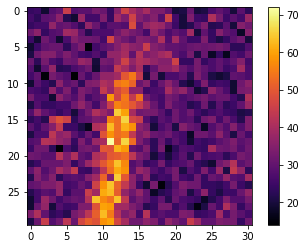

4


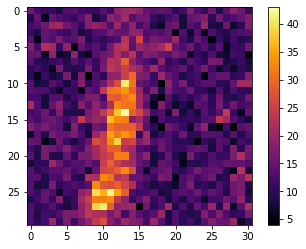

5


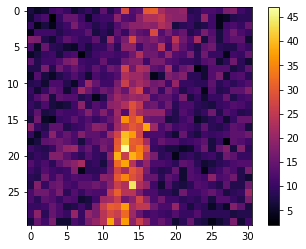

6


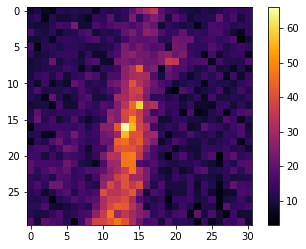

7


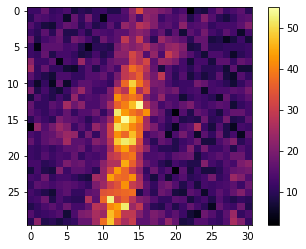

8


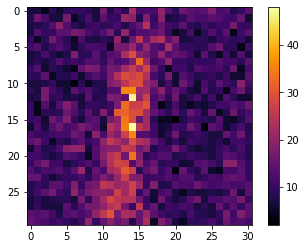

9


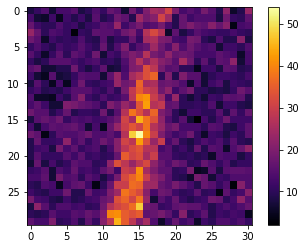

10


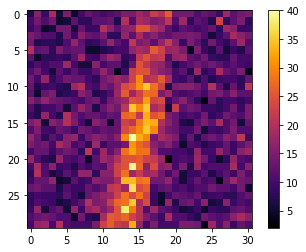

11


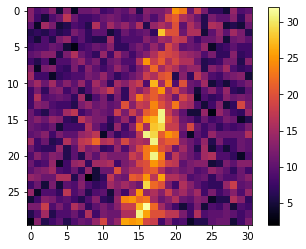

12


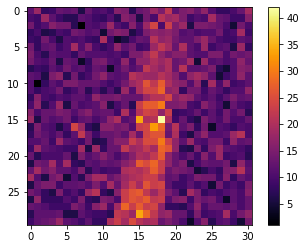

13


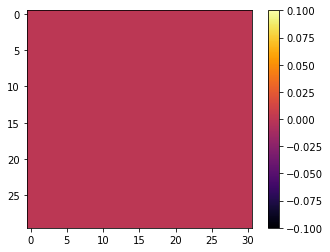

14


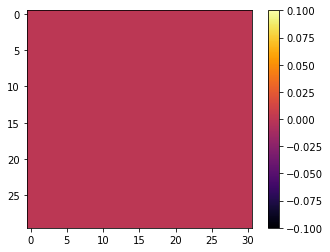

In [6]:
for i in range(scans2.shape[-1]):
    plt.imshow(scans2[0,:,:,:,i].sum(axis=(0)))
    print(i)
    plt.colorbar()
    plt.show()

In [7]:
scans3=si.rebin(scans2,100)

In [58]:
def find_shift_vectors(scans,PSF,itt=10,power=0.5):

    I=[]
    for i in range(scans.shape[-1]):
        #print(i)
        a=scans.sum(axis=(0,1))[:,:,i]
        I.append(a)
    I=np.array(I)
    I_f=np.fft.fft2(I)
    I_ff=np.fft.fftshift(I_f, axes=(1,2))
    S=PSF
    GF=np.zeros((scans.shape[2],scans.shape[3]))
    GF[:np.shape(S)[0],:np.shape(S)[1]]=S
    Gf=np.fft.fft2(GF)
    Imag=[]

    A=I_f[0,:,:]
    #A=np.fft.fft2(Aa)
    for k in range(itt):
        for i in range(I_ff.shape[0]-2):
            #print(i)
            B=I_f[i,:,:]
            Imag.append(np.abs(np.fft.ifft2(B/(A/(Gf)))))
        vxxx=np.zeros((scans.shape[-1]-2))
        vyyy=np.zeros((scans.shape[-1]-2))
        for i in range(scans.shape[-1]-2):
            #print(i)
            h=(Imag[i])**power
            u=find_max_index(h)
            res=photon_finder_gaussians(h, u)
            vxxx[i]=(res['xo'][0])
            vyyy[i]=(res['yo'][0])
        vxx=vxxx-vxxx.mean()
        vyy=vyyy-vyyy.mean()
        Aa=ac1_image(scans[:,:,:,:,:],-vyy,-vxx)
        A=np.fft.fft2(Aa)
    vx=-vyy
    vy=-vxx
    
    return vx, vy

def find_PSF(scans,TH=0.045):
    I=scans.sum(axis=(0,1))
    I=I.transpose(2,0,1)
    I_f=np.fft.fft2(I)
    I_ff=np.fft.fftshift(I_f, axes=(1,2))
    ll=0
    for i in range(I_ff.shape[0]-2):
        #print(i)
        B=I_f[i,:,:]
        M=np.zeros((B.shape[0],B.shape[1]))
        for i in range (B.shape[0]):
            for j in range(B.shape[1]):
                if np.abs(B[i,j])>TH*B.max():
                    M[i,j]=1
        plt.imshow(np.fft.fftshift(M))
        plt.show()
        l=M.sum()
        ll+=l
        
    kmax=np.sqrt((ll/(I_ff.shape[0]-2))/np.pi)
    d=np.shape(scans)[2]
    d2=np.shape(scans)[3]
    sss=2*d*0.225/kmax
    G2=np.zeros((d,d2))

    for x in range(d):
        for y in range(d2):
            G2[x,y]=np.exp(-((x-d//2)**2+(y-d2//2)**2)/(2*sss**2))
    return G2
def ac1_image(scans, vx, vy,):
    scan_n, N = scans.shape[0], scans.shape[1]
    ac5 = np.array([[np.mean(scans[j,:,:,:,i], axis=0) for i in range(scans.shape[4]-2)] for j in range(scan_n)])
    for which_scan in range(scan_n):
        ac5_sum = si.sum_img_t(ac5[which_scan,:,:,:], vx, vy)
    return ac5_sum
def find_max_index(img):
        m=np.max(img)
        for i in range(np.shape(img)[0]):
            for j in range (np.shape(img)[1]):
                if img[i,j]==m:
                    return [(float(i), float(j))]
def photon_finder_gaussians(image, centers):
    
    #commented for circle=1
    
    param_names = ['angle', 'd_angle', 'offset', 'd_offset', 'amplitude', 'd_amplitude', 'xo', 'd_xo', 
                   'yo', 'd_yo', 'sx', 'd_sx', 'sy', 'd_sy']
    res = {name: [] for name in param_names}
    
    for c in centers:
        xo, yo = tuple(map(int, c))
        fit, cov_p, infodict, errmsg = sofi.gaussfit(image, circle=0, return_all=1)
        N = np.size(image)
        n = len(fit)
        s_sq = (infodict['fvec']**2).sum()/ (N-n) # infodict already contains f(x)-y, which is needed
        cov = cov_p * s_sq
        stds = [np.sqrt(cov[i][i]) for i in range(len(fit))]
        #params = dict(zip(param_names, np.round(fit, 6)))
        params = dict(zip(param_names, np.round(fit, 7)))
        #const, amp, x, y, s, angle = fit
        const, amp, x, y, sx, sy, angle = fit
        #x +=5
        #y +=5
        res['offset'].append(const)
        res['amplitude'].append(amp)
        res['xo'].append(x)
        res['yo'].append(y)
        #res['s'].append(s)
        res['sy'].append(sy)
        res['sx'].append(sx)
        res['angle'].append(angle)
        res['d_offset'].append(stds[0])
        res['d_amplitude'].append(stds[1])
        res['d_xo'].append(stds[2])
        res['d_yo'].append(stds[3])
        res['d_sx'].append(stds[4])
        res['d_sy'].append(stds[5])
        res['d_angle'].append(stds[6])
        
        
    #fits = pd.DataFrame(res)
    #positions = pd.DataFrame(centers, columns=['xo', 'yo'])
        
    return res             

In [40]:
def get_transition_matrix_2(vx, vy, x, y, mask):
    vx, vy = vy, vx #to change swap them as it is needed for proper calculation

    det = mask.shape[0]
    zeros_to_concat = np.zeros(
        (det, det-1 , 1, 2), dtype=np.float64)

    vvx = (vx[:, np.newaxis] + vx[np.newaxis,:] ) / 2

    vvx = vvx + x

    vvy = (vy[:, np.newaxis, ] + vy[np.newaxis,:]) / 2
    vvy = vvy + y

    vvx = vvx[mask].reshape(det, det-1 )
    vvy = vvy[mask].reshape(det, det -1)

    vvx = vvx[:, :, np.newaxis, np.newaxis]
    vvy = vvy[:, :, np.newaxis, np.newaxis]

    vvvx = np.concatenate((zeros_to_concat, vvx), axis=3)
    vvvy = np.concatenate((zeros_to_concat, vvy), axis=3)

    vvvx[:, :, :, 0] = 1
    vvvy[:, :, :, 1] = 1

    # this is a translation matrix
    return np.concatenate((vvvx, vvvy), axis=2)


def get_image_2(d, translation_matrix, w, h):
    #t1=time.time()
    im = np.sum([[cv2.warpAffine(d[i, j], translation_matrix[i, j], (w, h)) for i in range(
                d.shape[0])] for j in range(d.shape[1])] , axis=(0, 1))
    #t2=time.time()
    #print(f'Img calculation took {t2-t1} seconds\n')
    return im


def get_xc2_cross(film, vx, vy, lag1=0):
    det = film.shape[3] - 2  # number of detectors
    w, h = film.shape[2], film.shape[1]  # shape im img
    N = film.shape[0]  # Number of frames
    im_t = np.zeros((h, w))  # our image (in future)
    M=[[i!=j for i in range(film.shape[-1]-2)]for j in range(film.shape[-1]-2)]
    M=np.array(M)
    mask = M
 
    #zeros_to_concat = np.zeros(
     #   (det, det, 1, 2), dtype=np.float64)

    if lag1 == 0:

        for x in range(h):  # loop over x positions
            for y in range(w):  # loop over y positions
                #print(f'Calculation for x={x} and y={y}')
                #t1 = time.time()
                data = film[:, x, y, :-2]
                data = data - np.mean(data, axis=0)
                d = data[:, :, np.newaxis] * data[:, np.newaxis, :] 
                d = d.mean(axis=0)
                d = d[mask]
                d = d.reshape(det, det-1)

                translation_matrix = get_transition_matrix_2(
                    vx, vy, x, y, mask)
                im_t = im_t + get_image_2(d, translation_matrix, w, h)
                #t2 = time.time()
                #print(f'took {t2-t1} seconds\n')

    if lag1!= 0:
        for x in range(h):  # loop over x positions
            for y in range(w):  # loop over y positions
               # print(
                #    f'Calculation for x={x}, y={y}, lag1={lag1} and lag2={lag2}')
                data = film[:, x, y, :-2]
                data = data - np.mean(data, axis=0)
                #t1_lag = time.time()
                d = data[lag1:, :, np.newaxis] * data[:N - lag1, np.newaxis, :]
                    
                d = d.mean(axis=0)
                d = d[mask]
                d = d.reshape(det, det-1 )
                translation_matrix = get_transition_matrix_2(vx, vy, x, y, mask)
                im_t = im_t + \
                    get_image_2(d, translation_matrix, w, h)
               # t2_lag = time.time()
                #print(f'took {t2_lag - t1_lag} seconds\n')
    return im_t

                

In [138]:
def get_transition_matrix_2(vx, vy, x, y, mask):
    vx, vy = vy, vx #to change swap them as it is needed for proper calculation

    det = mask.shape[0]
    zeros_to_concat = np.zeros(
        (det, det , 1, 2), dtype=np.float64)

    vvx = (vx[:, np.newaxis] + vx[np.newaxis,:] ) / 2

    vvx = vvx + x

    vvy = (vy[:, np.newaxis, ] + vy[np.newaxis,:]) / 2
    vvy = vvy + y

    vvx = vvx[mask].reshape(det, det )
    vvy = vvy[mask].reshape(det, det )

    vvx = vvx[:, :, np.newaxis, np.newaxis]
    vvy = vvy[:, :, np.newaxis, np.newaxis]

    vvvx = np.concatenate((zeros_to_concat, vvx), axis=3)
    vvvy = np.concatenate((zeros_to_concat, vvy), axis=3)

    vvvx[:, :, :, 0] = 1
    vvvy[:, :, :, 1] = 1

    # this is a translation matrix
    return np.concatenate((vvvx, vvvy), axis=2)


def get_image_2(d, translation_matrix, w, h):
    #t1=time.time()
    im = np.sum([[cv2.warpAffine(d[i, j], translation_matrix[i, j], (w, h)) for i in range(
                d.shape[0])] for j in range(d.shape[1])] , axis=(0, 1))
    #t2=time.time()
    #print(f'Img calculation took {t2-t1} seconds\n')
    return im


def get_xc2_timelags(film, vx, vy, lag1=0):
    det = film.shape[3] - 2  # number of detectors
    w, h = film.shape[2], film.shape[1]  # shape im img
    N = film.shape[0]  # Number of frames
    im_t = np.zeros((h, w))  # our image (in future)

    mask = np.ones((det, det), dtype=bool)
 
    zeros_to_concat = np.zeros(
        (det, det, 1, 2), dtype=np.float64)

    if lag1 == 0:

        for x in range(h):  # loop over x positions
            for y in range(w):  # loop over y positions
                #print(f'Calculation for x={x} and y={y}')
                #t1 = time.time()
                data = film[:, x, y, :-2]
                data = data - np.mean(data, axis=0)
                d = data[:, :, np.newaxis] * data[:, np.newaxis, :] 
                d = d.mean(axis=0)
                d = d[mask]
                d = d.reshape(det, det)

                translation_matrix = get_transition_matrix_2(
                    vx, vy, x, y, mask)
                im_t = im_t + get_image_2(d, translation_matrix, w, h)
                #t2 = time.time()
                #print(f'took {t2-t1} seconds\n')

    if lag1!= 0:
        for x in range(h):  # loop over x positions
            for y in range(w):  # loop over y positions
               # print(
                #    f'Calculation for x={x}, y={y}, lag1={lag1} and lag2={lag2}')
                data = film[:, x, y, :-2]
                data = data - np.mean(data, axis=0)
                #t1_lag = time.time()
                #d = data[lag1:, :, np.newaxis] * data[:N - lag1, np.newaxis, :]
                d=np.zeros((lag1+1,det,det))
                for t in range(det):
                    for s in range(det):
                        print(t)
                        print(s)
                        
                        d[:,t,s] = signal.fftconvolve(data[lag1:, t] [::-1], data[:, s],mode='valid',axes=0)/(data.shape[0]-lag1)
                        
                d = (d[1:,:,:]).mean(axis=0)
                print(d.shape)
                print(mask.shape)
                d = d[mask]
                d = d.reshape(det, det )
                translation_matrix = get_transition_matrix_2(vx, vy, x, y, mask)
                im_t = im_t + \
                    get_image_2(d, translation_matrix, w, h)
               # t2_lag = time.time()
                #print(f'took {t2_lag - t1_lag} seconds\n')
    return im_t

def fft_cov(list1, list2, lag=0):
    N=np.shape(list2)[0]
    if lag==0:
        cov=signal.fftconvolve(list1, list2[::-1], mode='valid')/len(list2)-np.array(signal.fftconvolve(list1,np.ones(len(list2)), mode='valid'))*np.array(signal.fftconvolve(np.ones(len(list1)),list2[::-1], mode='valid'))/(len(list1)**2)
    else:
        cov=np.array(signal.fftconvolve(list1, list2[:N-(lag+1)][::-1], mode='valid')[1:lag+1])/(len(list2[:N-(lag+1)]))-np.array(signal.fftconvolve(list1,np.ones(len(list2[:N-(lag+1)])), mode='valid'))[1:lag+1]*np.array(signal.fftconvolve(np.ones(len(list1)),list2[:N-(lag+1)][::-1], mode='valid'))[1:lag+1]/(len(list2[:N-(lag+1)])**2)
        
    return cov            

In [99]:
fft_cov(np.arange(1000), np.arange(1000)[::-1], lag=6)

array([-82170.66666667, -82170.66666667, -82170.66666667, -82170.66666667,
       -82170.66666667, -82170.66666667])

In [114]:
signal.fftconvolve(np.arange(100), np.arange(99)[::-1],mode='valid')

array([318549., 323400.])

In [109]:
iii=np.zeros((10,1000))
for i in range(10):
    iii[i,:]=np.arange(1000)*i

In [111]:
iii.shape

(10, 1000)

In [112]:
iii[:,::-1]

array([[0.000e+00, 0.000e+00, 0.000e+00, ..., 0.000e+00, 0.000e+00,
        0.000e+00],
       [9.990e+02, 9.980e+02, 9.970e+02, ..., 2.000e+00, 1.000e+00,
        0.000e+00],
       [1.998e+03, 1.996e+03, 1.994e+03, ..., 4.000e+00, 2.000e+00,
        0.000e+00],
       ...,
       [6.993e+03, 6.986e+03, 6.979e+03, ..., 1.400e+01, 7.000e+00,
        0.000e+00],
       [7.992e+03, 7.984e+03, 7.976e+03, ..., 1.600e+01, 8.000e+00,
        0.000e+00],
       [8.991e+03, 8.982e+03, 8.973e+03, ..., 1.800e+01, 9.000e+00,
        0.000e+00]])

In [107]:
(np.arange(99)*np.arange(100)[1:]).sum()

323400

In [115]:
(np.arange(99)*np.arange(100)[:-1]).sum()

318549

In [74]:
((np.arange(10)-np.arange(10).mean())[2:]*(np.arange(10)[::-1]-(np.arange(10)).mean())[:-2]).mean()

-4.25

In [92]:
k=0
for i in range(6):
    kk=((np.arange(100)-np.arange(100).mean())[i:]*(np.arange(100)[::-1]-(np.arange(100)).mean())[:100-i]).mean()
    k+=kk
    print(kk)

-833.25
-816.4166666666666
-799.25
-781.75
-763.9166666666666
-745.75


In [97]:
k=0
for i in range(1,7):
    kk=((np.arange(1000)-np.arange(1000).mean())[i:]*(np.arange(1000)[::-1]-(np.arange(1000)).mean())[:1000-i]).mean()
    k+=kk
    print(kk)

-83166.41666666667
-82999.25
-82831.75
-82663.91666666667
-82495.75
-82327.25


In [98]:
k/6

-82747.38888888889

In [65]:
np.arange(10)[::-1]

array([9, 8, 7, 6, 5, 4, 3, 2, 1, 0])

In [66]:
np.arange(10)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [139]:
xc2_sum=get_xc2_timelags(scans[0,:,:,:,:], vx, vy, lag1=100)

0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(10

(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12


17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,

4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(10

13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21

(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
1

8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101

(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
2

9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101

(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101

21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)


9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(

(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)


(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)

13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21

(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16


(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12


(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,

(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)

13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)

21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9


8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12

(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)

3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(10

12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)


(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3


8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12

17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)

(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7

12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)

(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,

8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(

16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)


(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7

12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2


(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(10

(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)

16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(

3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(1

(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
1

(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2

(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9


16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(

(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6

11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)


20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,

(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(

(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13


2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(10

(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15


(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)

(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,

15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)


(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)

11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1

19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14


6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10

15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101

(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)

11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20


19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1

(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
1

(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101

2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(10

11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101

(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)

(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10


15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20


1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(10

(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12


(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2


(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10


(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)

(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5

10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)


(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1


6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10

(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14

1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(10

10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,

19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(10

(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,

14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)


(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5

10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,

19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(10

6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(10

14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)


(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)

(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,

18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(1

(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9

14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(10

(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)

10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20


18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9

5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(10

(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,

0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(10

10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,

(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101

(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)


(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,

0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(10

(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
1

(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101

(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)

14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(

(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4

10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)


(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(1

(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)

14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(10

(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4

9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13

18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21

5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(1

(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14

0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(10

9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8

(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
2

(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8

(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9


0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(1

(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101

(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13


(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8

13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(1

(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(1

(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(10

(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8

(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)


(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101

(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(

(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,

17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(1

4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(1

(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,

(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15

8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101

(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)


4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(1

(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
1

(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)


8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12

(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,

(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7

13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)


21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3


8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12

17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101

3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(10

12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)


21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(10

(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(1

17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101

(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7

12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)


(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)


8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12

(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
1

3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(10

12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)


(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3


(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(1

17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,

(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7

12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,

21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0


(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(10

16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)


3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(10

12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(10

21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20

(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)

16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)


3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(10

(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
1

21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20

8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(

16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)


(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7

12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,

(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101

8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(

(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10


(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)


(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101

20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2


7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(

(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)

(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)

(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
1

(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2

(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11


16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0

3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(1

12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)

20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7


(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10

(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101

(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6

(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14

20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,

(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6


(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19


2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(10

(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15


(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)

7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(1

15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)


(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6

11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(1

(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)

6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10

(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19


2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(1

(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101

(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,

(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(

15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,

(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)

(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101

(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101

(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101

15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(

2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(1

11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,

19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5


(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10


15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(1

(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5

(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10


19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(10

(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101

15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)


1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(10

10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,

(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0

(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)

(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11


(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)

10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(

(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0

(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9

(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18

(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)

(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,

(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(

(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9

(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)

0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(10

(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
1

18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101

5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(10

(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,

(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4

(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13


18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)


5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(1

14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(10

0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(10

(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101

18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(1

5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(1

(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13


0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(1

9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7

(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)


5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(1

13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)


0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(1

9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4

18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,

4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(10

(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8

(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)

(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)

(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9


(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8

13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21

(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15

(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12

(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,

4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(1

(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16

(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101

(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(1

17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(1

(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7

13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)


(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(1

(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(1

(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
1

3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(10

12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)


(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)


8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12


(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13


(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7

12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101

(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101

(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19

(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20


3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(1

(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101

20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2

(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
1

(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101

3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(10

(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14

(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101

(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9


(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
1

(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6

11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)


(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(1

7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)


16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(1

(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6

(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11


20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101

(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(

(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
1

2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(10

(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8

(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)

(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(10

15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)


(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6

11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101

20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(

7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(1

15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)


2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(10

11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101

(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)

7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(

15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)


(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6

11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(1

(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)

6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10

(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
1

2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(1

(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)

19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1

(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)


(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)

2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(1

11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(1

(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8

(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10


15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20


(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5

11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101

(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1

(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
1

15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21

(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5

(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14

19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)


(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10


(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
1

(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5

(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12


(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0

6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2

15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)

(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5

10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101

19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(10

6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1


14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)


(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)

(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)


19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(10

5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(10

(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10


1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(1

(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)


19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(10

(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9

(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8

(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)

10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(1

(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0

5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(10

(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18

1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(1

(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,

18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9

(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9

(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18

(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)

(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)


(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(10

5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(10

(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101

(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4

10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101

(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101

5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(1

14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20


0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(10

9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13


18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22,

(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)

14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,

(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4

(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101

(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
2

5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(10

(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10


0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(1

9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3

17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)


4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(10

13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101

(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)

(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
1

17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)


(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8

(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101

(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16


9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(10

(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)

4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(1

13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(10

21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(

(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(

(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)

(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)


12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)


(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3


(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(1

(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14

3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(10

12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101

21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20

(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
1

(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10


(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7

12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(1

(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101

8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101

16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)


3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(10

12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(

(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(10

7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16


16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(1

(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)

12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(

20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,

(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11


(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,

3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(1

12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(10

(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
1

(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
1

(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101

(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)

(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15


(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101

(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8


16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(

2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(10

(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11


20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(10

(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(1

15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)


2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(10

11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,

20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(

(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)

(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10


2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(1

(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)


20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(

(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(

15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,

2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(1

(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101

19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13

6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10


(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19

(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)

(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101

(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101

(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,

15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2


2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(10

(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
1

(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(

6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(

15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0

(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5

(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14

(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2


6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)

(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18

(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5

10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)


(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0

6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2

(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11


1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(1

10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(1

19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(10

(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9

(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18

1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(1

(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)

18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9

5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(10

(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,

(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)


10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(

18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101

5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(10

(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)

0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(10

9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13

18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21

(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)

(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13


(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4

(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101

(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)

(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)

14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)


0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(1

(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101

18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(10

(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8

(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9


(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)

(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,

(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12


(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8

(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)

(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(1

9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12


17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101

(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)

(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)


21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(1

8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)

(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101

4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(1

12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)


21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101

(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(1

17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,

3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(10

(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8

(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101

(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,

(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10


3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(10

12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(1

(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101

(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(10

16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,

3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(1

(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,

20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)


7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(10

16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2


3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(1

(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15

(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2

(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9


(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)


2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(10

(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10


(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)


(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101

(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13


2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(10

11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(1

20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(

7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)

(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19


(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)

(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)

(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8

(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)


15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2


(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5

11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101

19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(1

(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10

15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20


(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5

10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)


(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0

(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,

(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11


(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)

(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)

(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)


5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(10

(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18

(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)

10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(

18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)

(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9

(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101

0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(10

(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
1

(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(1

5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(1

(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
1

0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(10

9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13

(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)


5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(1

14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101

0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(10

9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8

18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(10

(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)


(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10


0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(1

(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101

17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)


4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(10

(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
1

0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(1

9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101

(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8

(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)


7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(10

21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101

(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
1

17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0

4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(1

13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,)
16
16
(101

(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101

8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12

17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,)
20
21

4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101,)
8
0
(101,)
8
1
(1

13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12
(101,)
16
13
(101,)
16
14
(101,)
16
15
(101,

(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(101,)
3
4
(101,)
3
5
(101,)
3
6
(101,)
3
7
(101,)
3
8
(101,)
3
9
(101,)

(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12
5
(101,)
12
6
(101,)
12
7
(101,)
12
8
(101,)
12
9
(101,)
12
10
(

(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
15
(101,)
20
16
(101,)
20
17
(101,)
20
18
(101,)
20
19
(101,)
20
20
(101,

1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7
14
(101,)
7
15
(101,)
7
16
(101,)
7
17
(101,)
7
18
(101,)
7
19
(101,)
7
20
(101,)
7
21
(101

(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16
6
(101,)
16
7
(101,)
16
8
(101,)
16
9
(101,)
16
10
(101,)
16
11
(101,)
16
12


21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101,)
2
20
(101,)
2
21
(101,)
3
0
(101,)
3
1
(101,)
3
2
(101,)
3
3
(10

8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(101,)
12
0
(101,)
12
1
(101,)
12
2
(101,)
12
3
(101,)
12
4
(101,)
12

(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10
(101,)
20
11
(101,)
20
12
(101,)
20
13
(101,)
20
14
(101,)
20
1

(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)
7
9
(101,)
7
10
(101,)
7
11
(101,)
7
12
(101,)
7
13
(101,)
7

(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)
16
3
(101,)
16
4
(101,)
16
5
(101,)
16

(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18
(101,)
2
19
(101

8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(101,)
11
19
(101,)
11
20
(101,)
11
21
(1

(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20
7
(101,)
20
8
(101,)
20
9
(101,)
20
10


(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)
7
7
(101,)
7
8
(101,)


(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101,)
16
0
(101,)
16
1
(101,)
16
2
(101,)

21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)
0
0
(101,)
0
1
(101,)
0
2
(101,)
0
3
(101,)
0
4
(101,)
0
5
(101,)
0
6
(101,)
0
7
(101,)
0
8
(101,)
0
9
(101,)
0
10
(101,)
0
11
(101,)
0
12
(101,)
0
13
(101,)
0
14
(101,)
0
15
(101,)
0
16
(101,)
0
17
(101,)
0
18
(101,)
0
19
(101,)
0
20
(101,)
0
21
(101,)
1
0
(101,)
1
1
(101,)
1
2
(101,)
1
3
(101,)
1
4
(101,)
1
5
(101,)
1
6
(101,)
1
7
(101,)
1
8
(101,)
1
9
(101,)
1
10
(101,)
1
11
(101,)
1
12
(101,)
1
13
(101,)
1
14
(101,)
1
15
(101,)
1
16
(101,)
1
17
(101,)
1
18
(101,)
1
19
(101,)
1
20
(101,)
1
21
(101,)
2
0
(101,)
2
1
(101,)
2
2
(101,)
2
3
(101,)
2
4
(101,)
2
5
(101,)
2
6
(101,)
2
7
(101,)
2
8
(101,)
2
9
(101,)
2
10
(101,)
2
11
(101,)
2
12
(101,)
2
13
(101,)
2
14
(101,)
2
15
(101,)
2
16
(101,)
2
17
(101,)
2
18

(101,)
8
2
(101,)
8
3
(101,)
8
4
(101,)
8
5
(101,)
8
6
(101,)
8
7
(101,)
8
8
(101,)
8
9
(101,)
8
10
(101,)
8
11
(101,)
8
12
(101,)
8
13
(101,)
8
14
(101,)
8
15
(101,)
8
16
(101,)
8
17
(101,)
8
18
(101,)
8
19
(101,)
8
20
(101,)
8
21
(101,)
9
0
(101,)
9
1
(101,)
9
2
(101,)
9
3
(101,)
9
4
(101,)
9
5
(101,)
9
6
(101,)
9
7
(101,)
9
8
(101,)
9
9
(101,)
9
10
(101,)
9
11
(101,)
9
12
(101,)
9
13
(101,)
9
14
(101,)
9
15
(101,)
9
16
(101,)
9
17
(101,)
9
18
(101,)
9
19
(101,)
9
20
(101,)
9
21
(101,)
10
0
(101,)
10
1
(101,)
10
2
(101,)
10
3
(101,)
10
4
(101,)
10
5
(101,)
10
6
(101,)
10
7
(101,)
10
8
(101,)
10
9
(101,)
10
10
(101,)
10
11
(101,)
10
12
(101,)
10
13
(101,)
10
14
(101,)
10
15
(101,)
10
16
(101,)
10
17
(101,)
10
18
(101,)
10
19
(101,)
10
20
(101,)
10
21
(101,)
11
0
(101,)
11
1
(101,)
11
2
(101,)
11
3
(101,)
11
4
(101,)
11
5
(101,)
11
6
(101,)
11
7
(101,)
11
8
(101,)
11
9
(101,)
11
10
(101,)
11
11
(101,)
11
12
(101,)
11
13
(101,)
11
14
(101,)
11
15
(101,)
11
16
(101,)
11
17
(101,)
11
18
(

(101,)
16
16
(101,)
16
17
(101,)
16
18
(101,)
16
19
(101,)
16
20
(101,)
16
21
(101,)
17
0
(101,)
17
1
(101,)
17
2
(101,)
17
3
(101,)
17
4
(101,)
17
5
(101,)
17
6
(101,)
17
7
(101,)
17
8
(101,)
17
9
(101,)
17
10
(101,)
17
11
(101,)
17
12
(101,)
17
13
(101,)
17
14
(101,)
17
15
(101,)
17
16
(101,)
17
17
(101,)
17
18
(101,)
17
19
(101,)
17
20
(101,)
17
21
(101,)
18
0
(101,)
18
1
(101,)
18
2
(101,)
18
3
(101,)
18
4
(101,)
18
5
(101,)
18
6
(101,)
18
7
(101,)
18
8
(101,)
18
9
(101,)
18
10
(101,)
18
11
(101,)
18
12
(101,)
18
13
(101,)
18
14
(101,)
18
15
(101,)
18
16
(101,)
18
17
(101,)
18
18
(101,)
18
19
(101,)
18
20
(101,)
18
21
(101,)
19
0
(101,)
19
1
(101,)
19
2
(101,)
19
3
(101,)
19
4
(101,)
19
5
(101,)
19
6
(101,)
19
7
(101,)
19
8
(101,)
19
9
(101,)
19
10
(101,)
19
11
(101,)
19
12
(101,)
19
13
(101,)
19
14
(101,)
19
15
(101,)
19
16
(101,)
19
17
(101,)
19
18
(101,)
19
19
(101,)
19
20
(101,)
19
21
(101,)
20
0
(101,)
20
1
(101,)
20
2
(101,)
20
3
(101,)
20
4
(101,)
20
5
(101,)
20
6
(101,)
20


(101,)
3
9
(101,)
3
10
(101,)
3
11
(101,)
3
12
(101,)
3
13
(101,)
3
14
(101,)
3
15
(101,)
3
16
(101,)
3
17
(101,)
3
18
(101,)
3
19
(101,)
3
20
(101,)
3
21
(101,)
4
0
(101,)
4
1
(101,)
4
2
(101,)
4
3
(101,)
4
4
(101,)
4
5
(101,)
4
6
(101,)
4
7
(101,)
4
8
(101,)
4
9
(101,)
4
10
(101,)
4
11
(101,)
4
12
(101,)
4
13
(101,)
4
14
(101,)
4
15
(101,)
4
16
(101,)
4
17
(101,)
4
18
(101,)
4
19
(101,)
4
20
(101,)
4
21
(101,)
5
0
(101,)
5
1
(101,)
5
2
(101,)
5
3
(101,)
5
4
(101,)
5
5
(101,)
5
6
(101,)
5
7
(101,)
5
8
(101,)
5
9
(101,)
5
10
(101,)
5
11
(101,)
5
12
(101,)
5
13
(101,)
5
14
(101,)
5
15
(101,)
5
16
(101,)
5
17
(101,)
5
18
(101,)
5
19
(101,)
5
20
(101,)
5
21
(101,)
6
0
(101,)
6
1
(101,)
6
2
(101,)
6
3
(101,)
6
4
(101,)
6
5
(101,)
6
6
(101,)
6
7
(101,)
6
8
(101,)
6
9
(101,)
6
10
(101,)
6
11
(101,)
6
12
(101,)
6
13
(101,)
6
14
(101,)
6
15
(101,)
6
16
(101,)
6
17
(101,)
6
18
(101,)
6
19
(101,)
6
20
(101,)
6
21
(101,)
7
0
(101,)
7
1
(101,)
7
2
(101,)
7
3
(101,)
7
4
(101,)
7
5
(101,)
7
6
(101,)

(101,)
12
9
(101,)
12
10
(101,)
12
11
(101,)
12
12
(101,)
12
13
(101,)
12
14
(101,)
12
15
(101,)
12
16
(101,)
12
17
(101,)
12
18
(101,)
12
19
(101,)
12
20
(101,)
12
21
(101,)
13
0
(101,)
13
1
(101,)
13
2
(101,)
13
3
(101,)
13
4
(101,)
13
5
(101,)
13
6
(101,)
13
7
(101,)
13
8
(101,)
13
9
(101,)
13
10
(101,)
13
11
(101,)
13
12
(101,)
13
13
(101,)
13
14
(101,)
13
15
(101,)
13
16
(101,)
13
17
(101,)
13
18
(101,)
13
19
(101,)
13
20
(101,)
13
21
(101,)
14
0
(101,)
14
1
(101,)
14
2
(101,)
14
3
(101,)
14
4
(101,)
14
5
(101,)
14
6
(101,)
14
7
(101,)
14
8
(101,)
14
9
(101,)
14
10
(101,)
14
11
(101,)
14
12
(101,)
14
13
(101,)
14
14
(101,)
14
15
(101,)
14
16
(101,)
14
17
(101,)
14
18
(101,)
14
19
(101,)
14
20
(101,)
14
21
(101,)
15
0
(101,)
15
1
(101,)
15
2
(101,)
15
3
(101,)
15
4
(101,)
15
5
(101,)
15
6
(101,)
15
7
(101,)
15
8
(101,)
15
9
(101,)
15
10
(101,)
15
11
(101,)
15
12
(101,)
15
13
(101,)
15
14
(101,)
15
15
(101,)
15
16
(101,)
15
17
(101,)
15
18
(101,)
15
19
(101,)
15
20
(101,)
15
21
(101

20
19
(101,)
20
20
(101,)
20
21
(101,)
21
0
(101,)
21
1
(101,)
21
2
(101,)
21
3
(101,)
21
4
(101,)
21
5
(101,)
21
6
(101,)
21
7
(101,)
21
8
(101,)
21
9
(101,)
21
10
(101,)
21
11
(101,)
21
12
(101,)
21
13
(101,)
21
14
(101,)
21
15
(101,)
21
16
(101,)
21
17
(101,)
21
18
(101,)
21
19
(101,)
21
20
(101,)
21
21
(101,)
(22, 22)
(22, 22)


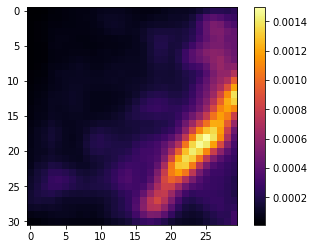

In [142]:
plt.imshow(xc2_sum.T)

plt.colorbar()
plt.show()

In [144]:
xc2_zero = get_xc2_timelags(scans[0,:,:,:,:], vx, vy, lag1=0)

In [149]:
xc2o = si.get_xc2(scans[0,:,:,:,:], vx, vy, lag1=1)

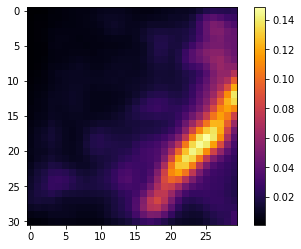

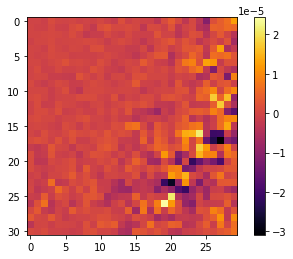

In [147]:
plt.imshow(xc2_zero.T)

plt.colorbar()
plt.show()
plt.imshow(-(xc2_zero.T/100)+xc2_sum.T)

plt.colorbar()
plt.show()

In [47]:
xc2xc=get_xc2_cross(scans[0,500:,:,:,:],va,vb,1)

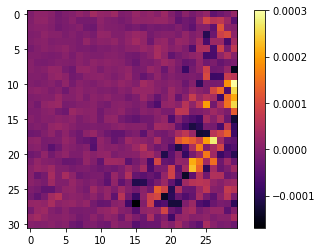

In [49]:
plt.imshow(-(xc2xc.T))
plt.colorbar()

In [ ]:
scans_a  = np.delete(scans,14,axis=4)

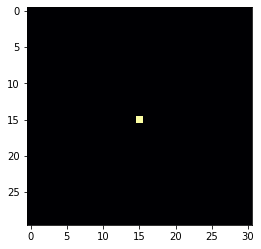

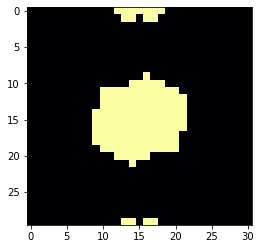

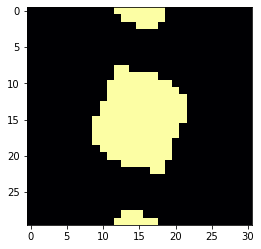

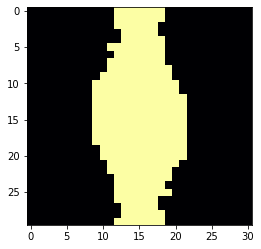

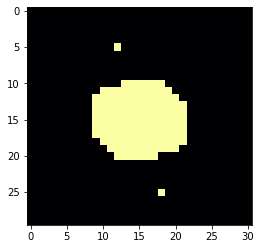

...

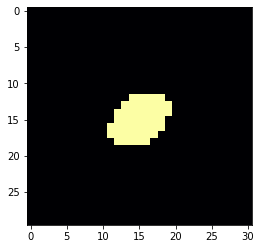

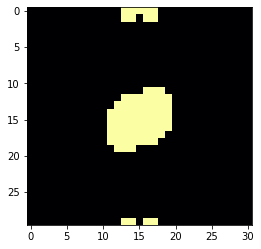

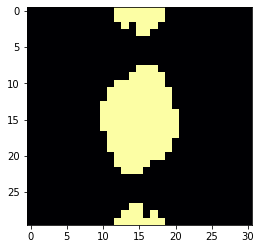

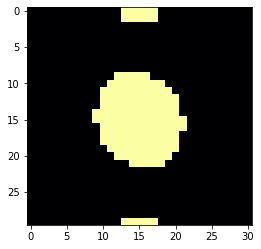

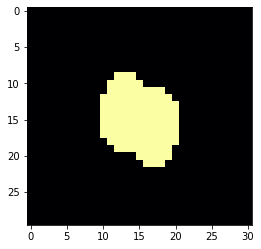

In [26]:
va,vb=si.find_shift_vectors(scans,si.find_PSF(scans,TH=0.045),itt=10,power=2)

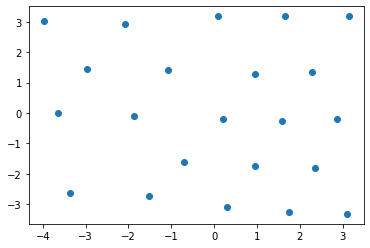

In [27]:
plt.plot(vb,va, 'o')

In [35]:
np.save('vx',va)
np.save('vy',vb)


In [5]:
vx=np.load('vx_06_07_2020.npy')

In [6]:
vy=np.load('vy_06_07_2020.npy')

In [8]:
va=vb=np.zeros((scans_a.shape[-1]-2))

In [45]:
xc2=si.get_xc2(scans[0,50:,:,:,:],va,vb,1)

In [40]:
xc2=si.get_xc2(scans[0,:,:,:,:],vx,vy,2)

In [19]:
xc2=si.get_xc2(si.rebin(scans,2)[0,:,:,:,:],va,vb,1)

NameError: name 'va' is not defined

In [35]:
xc2=si.get_xc2(scans[0,:,:,:,:],vx,vy,1).T
for i in range(3):
    xc2+=si.get_xc2(scans[0,:,:,:,:],vx,vy,2+i).T

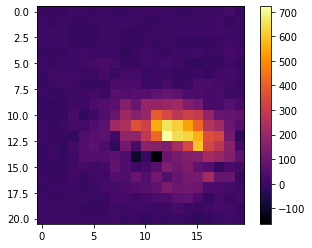

In [41]:
plt.imshow((xc2).T)
plt.colorbar()

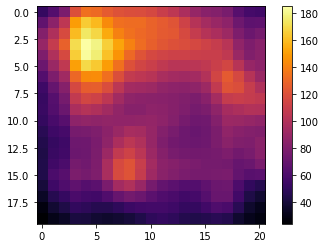

In [23]:
plt.imshow(si.ac1_image(scans,vx,vy))
plt.colorbar()

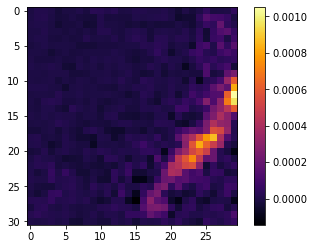

In [46]:
plt.imshow(-(xc2.T))
plt.colorbar()

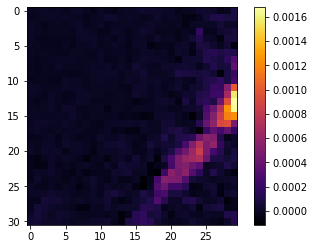

In [10]:
plt.imshow(-(xc2.T))
plt.colorbar()

In [15]:
scans.shape

(1, 250000, 30, 31, 24)

In [22]:
A=np.zeros((scans.shape[-1],scans.shape[-1],scans.shape[-3],scans.shape[-2]))
for i in range(scans.shape[-1]):
    for j in range(scans.shape[-1]):
        print(i)
        print(j)
        A[i,j,:,:]=((scans[0,1:,:,:,i]-scans[0,1:,:,:,i].mean(axis=0))*(scans[0,:-1,:,:,j]-scans[0,:-1,:,:,j].mean(axis=0))).mean(axis=0)

0
0
0
1
0
2
0
3
0
4
0
5
0
6
0
7
0
8
0
9
0
10
0
11
0
12
0
13
0
14
0
15
0
16
0
17
0
18
0
19
0
20
0
21
0
22
0
23
1
0
1
1
1
2
1
3
1
4
1
5
1
6
1
7
1
8
1
9
1
10
1
11
1
12
1
13
1
14
1
15
1
16
1
17
1
18
1
19
1
20
1
21
1
22
1
23
2
0
2
1
2
2
2
3
2
4
2
5
2
6
2
7
2
8
2
9
2
10
2
11
2
12
2
13
2
14
2
15
2
16
2
17
2
18
2
19
2
20
2
21
2
22
2
23
3
0
3
1
3
2
3
3
3
4
3
5
3
6
3
7
3
8
3
9
3
10
3
11
3
12
3
13
3
14
3
15
3
16
3
17
3
18
3
19
3
20
3
21
3
22
3
23
4
0
4
1
4
2
4
3
4
4
4
5
4
6
4
7
4
8
4
9
4
10
4
11
4
12
4
13
4
14
4
15
4
16
4
17
4
18
4
19
4
20
4
21
4
22
4
23
5
0
5
1
5
2
5
3
5
4
5
5
5
6
5
7
5
8
5
9
5
10
5
11
5
12
5
13
5
14
5
15
5
16
5
17
5
18
5
19
5
20
5
21
5
22
5
23
6
0
6
1
6
2
6
3
6
4
6
5
6
6
6
7
6
8
6
9
6
10
6
11
6
12
6
13
6
14
6
15
6
16
6
17
6
18
6
19
6
20
6
21
6
22
6
23
7
0
7
1
7
2
7
3
7
4
7
5
7
6
7
7
7
8
7
9
7
10
7
11
7
12
7
13
7
14
7
15
7
16
7
17
7
18
7
19
7
20
7
21
7
22
7
23
8
0
8
1
8
2
8
3
8
4
8
5
8
6
8
7
8
8
8
9
8
10
8
11
8
12
8
13
8
14
8
15
8
16
8
17
8
18
8
19
8
20
8
21
8
22
8
23
9
0
9
1
9


0 0


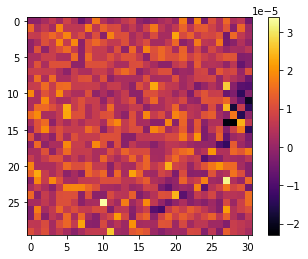

0 1


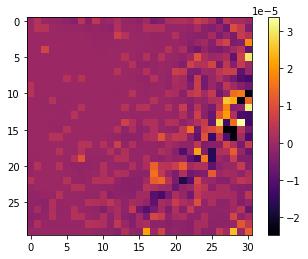

0 2


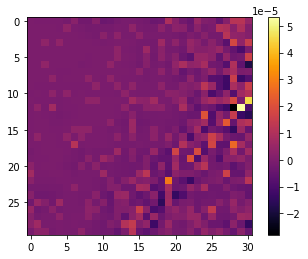

0 3


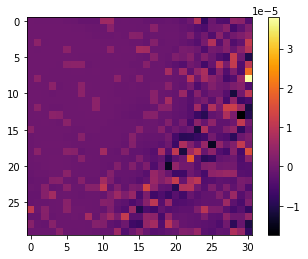

0 4


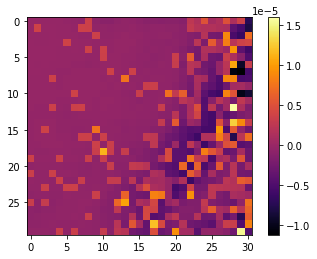

0 5


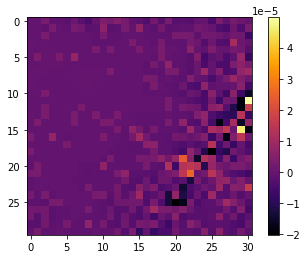

0 6


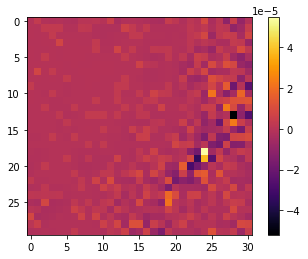

0 7


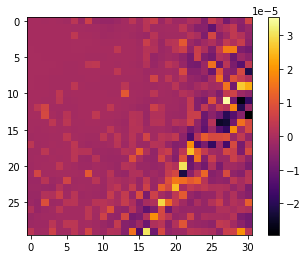

0 8


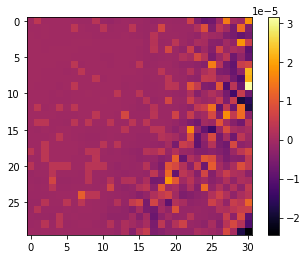

0 9


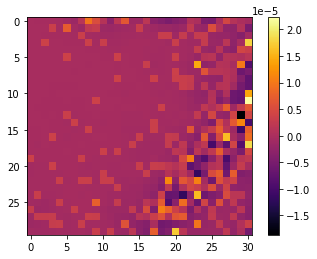

0 10


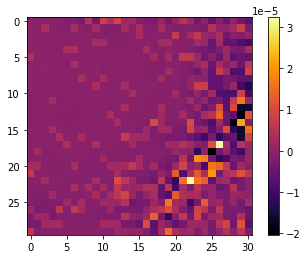

0 11


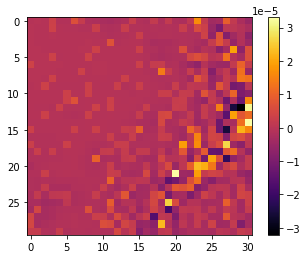

0 12


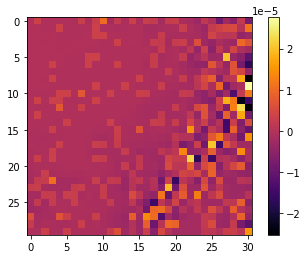

0 13


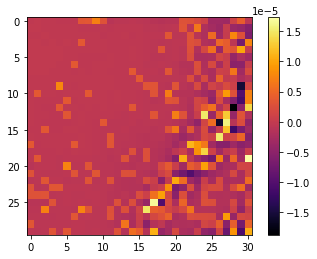

0 14


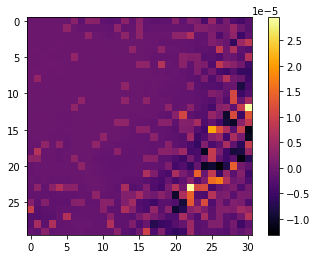

0 15


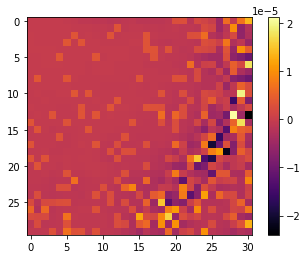

0 16


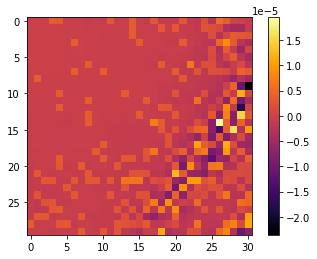

0 17


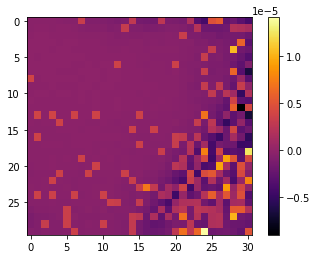

0 18


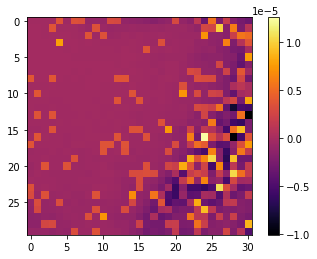

0 19


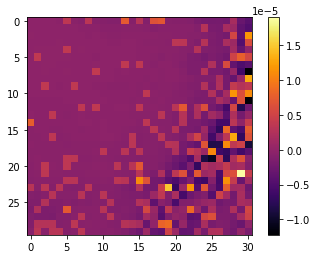

0 20


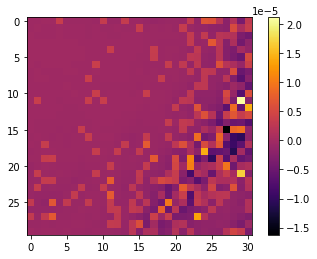

0 21


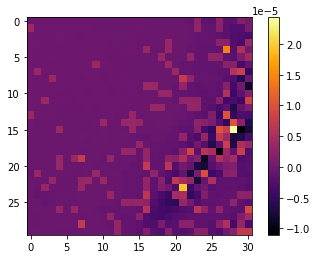

0 22


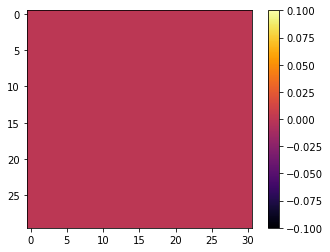

0 23


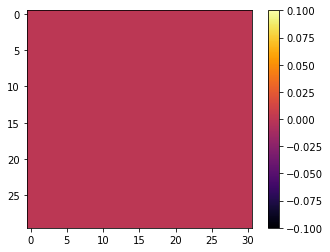

1 0


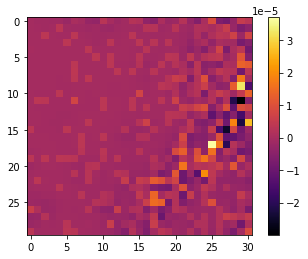

1 1


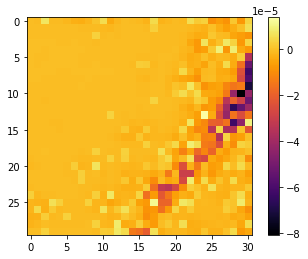

1 2


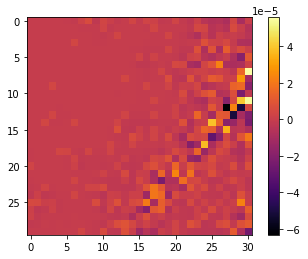

1 3


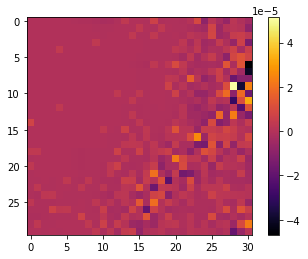

1 4


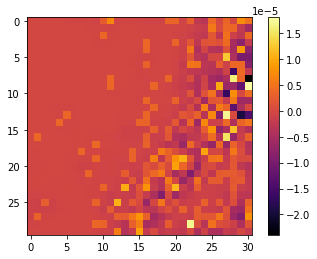

1 5


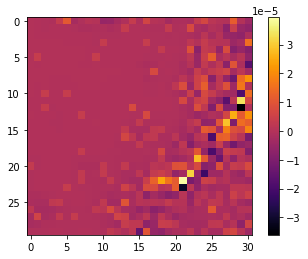

1 6


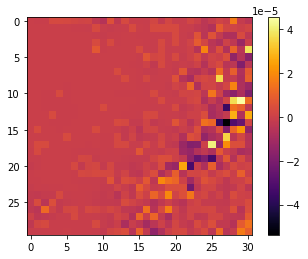

1 7


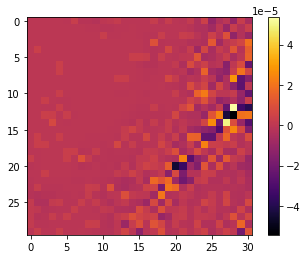

1 8


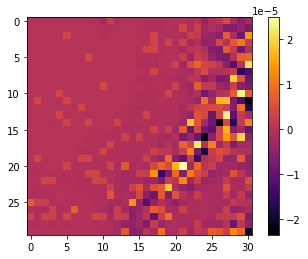

1 9


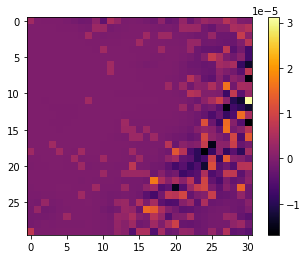

1 10


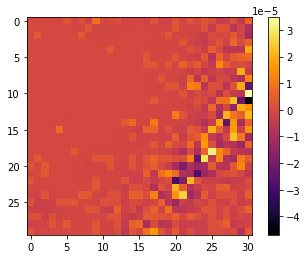

1 11


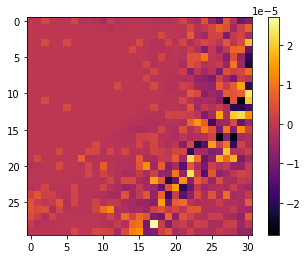

1 12


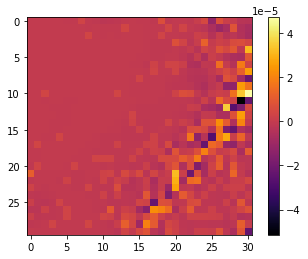

1 13


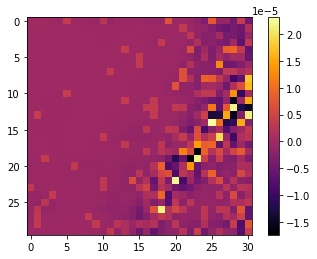

1 14


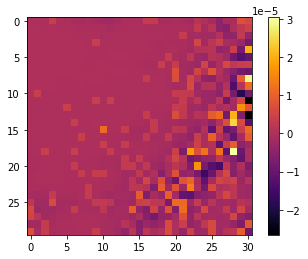

1 15


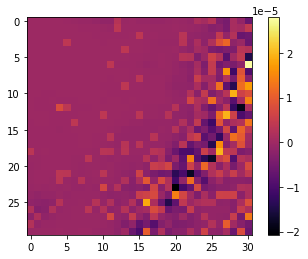

1 16


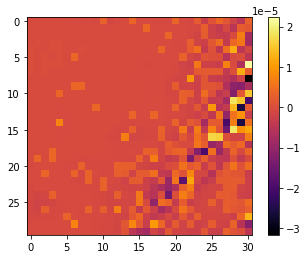

1 17


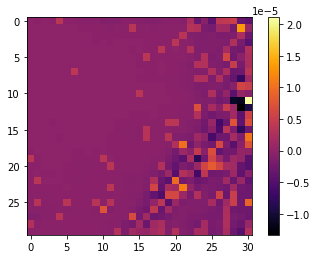

1 18


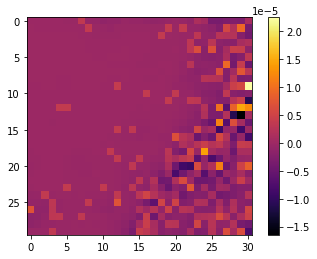

1 19


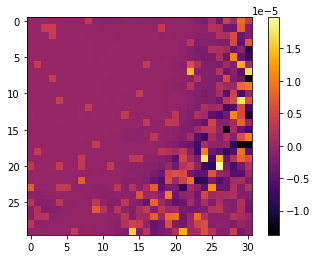

1 20


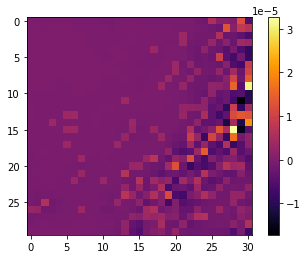

1 21


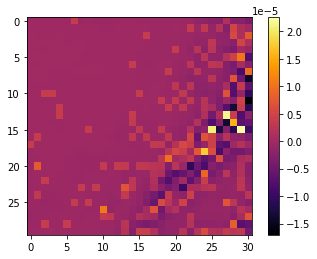

1 22


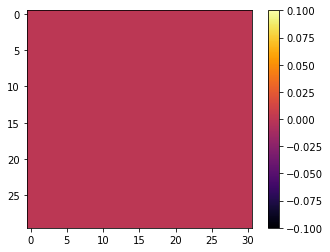

1 23


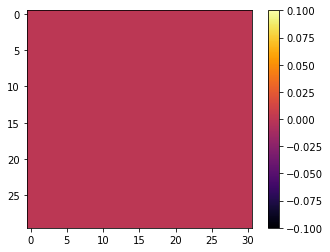

2 0


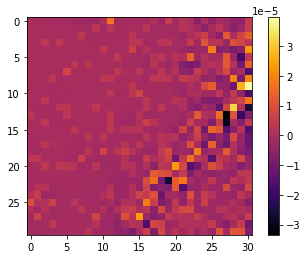

2 1


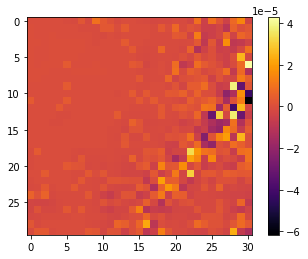

2 2


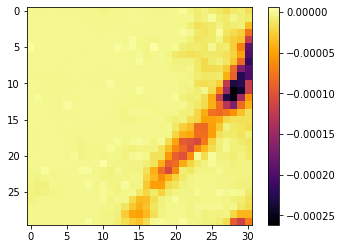

2 3


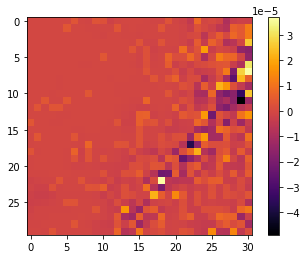

2 4


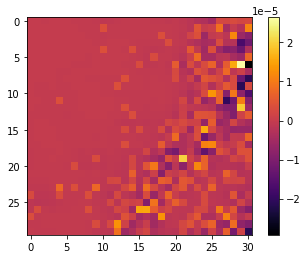

2 5


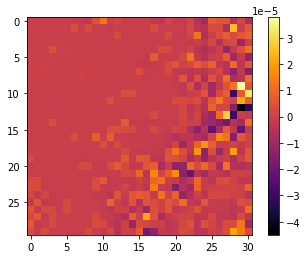

2 6


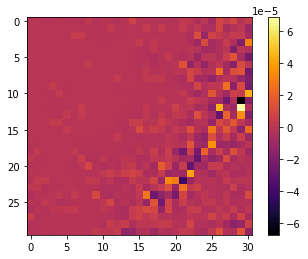

2 7


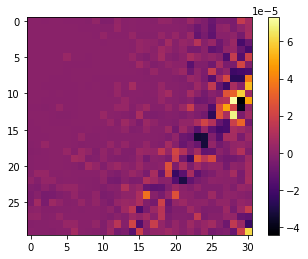

2 8


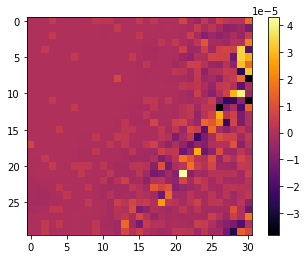

2 9


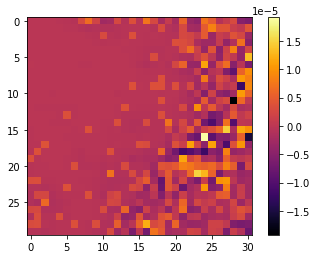

2 10


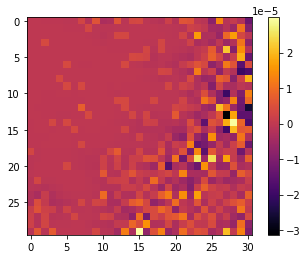

2 11


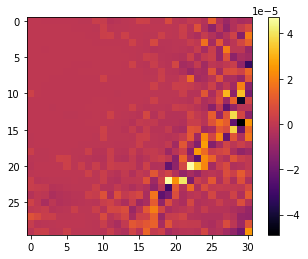

2 12


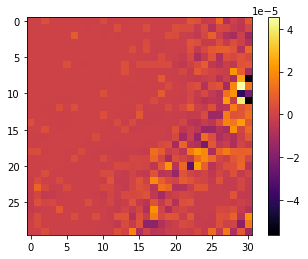

2 13


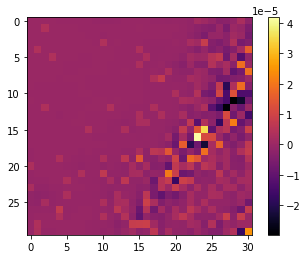

2 14


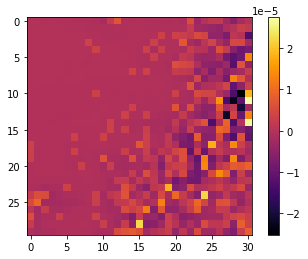

2 15


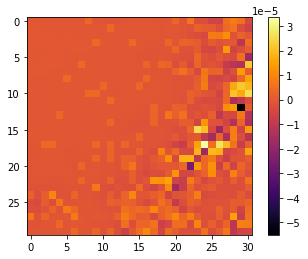

2 16


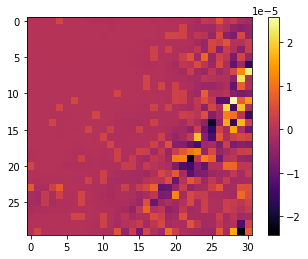

2 17


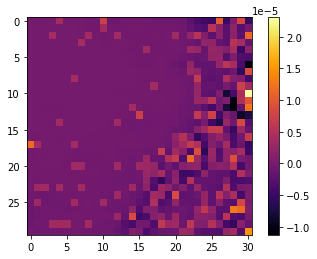

2 18


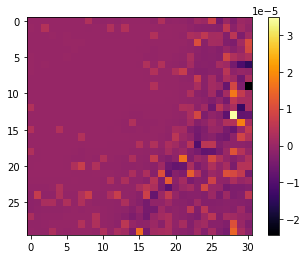

2 19


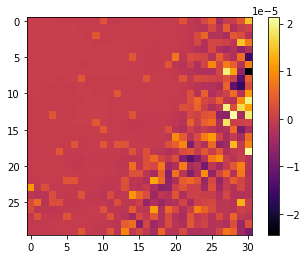

2 20


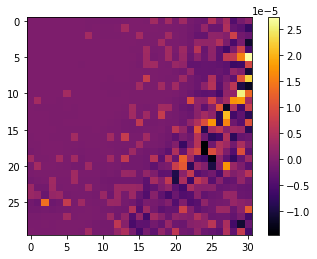

2 21


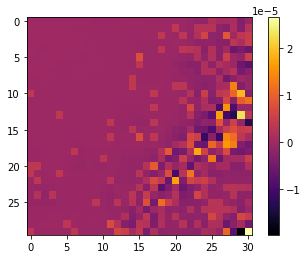

2 22


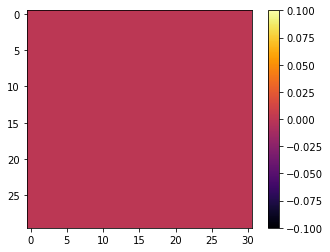

2 23


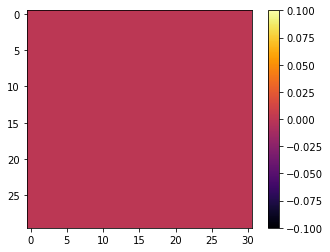

3 0


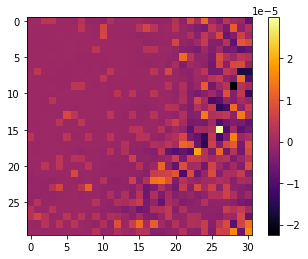

3 1


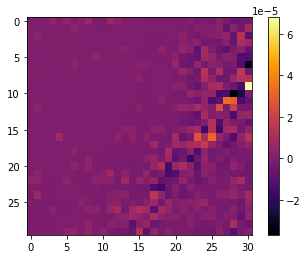

3 2


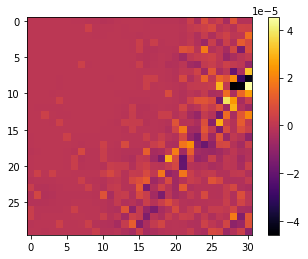

3 3


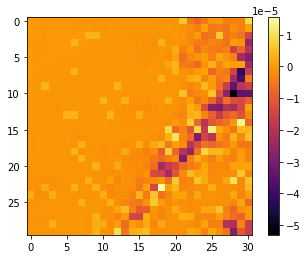

3 4


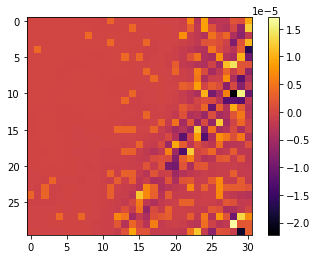

3 5


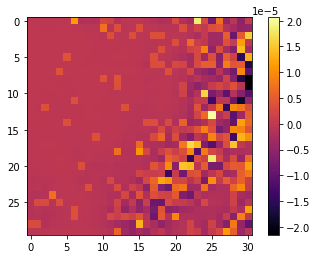

3 6


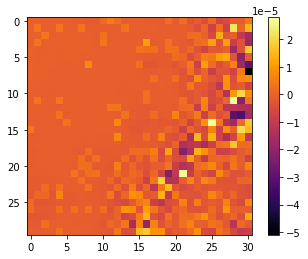

3 7


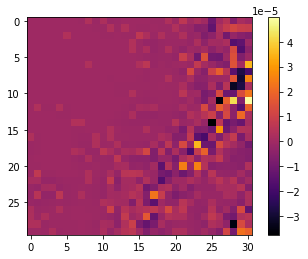

3 8


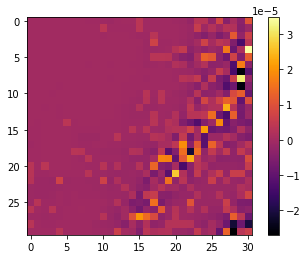

3 9


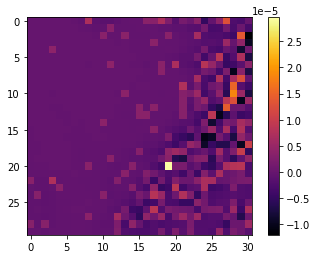

3 10


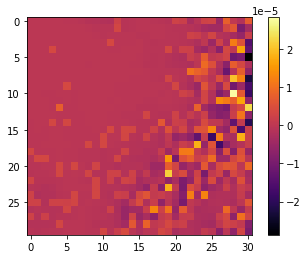

3 11


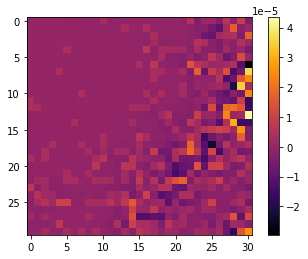

3 12


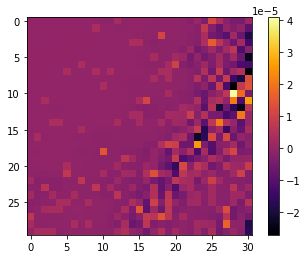

3 13


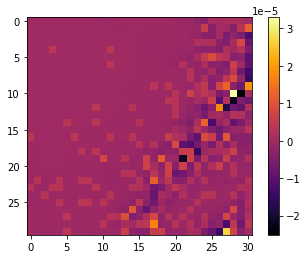

3 14


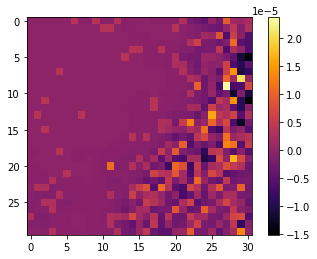

3 15


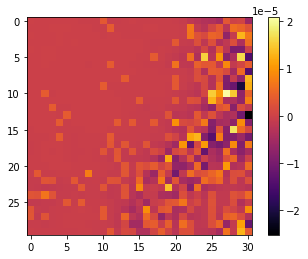

3 16


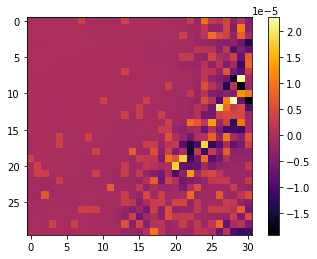

3 17


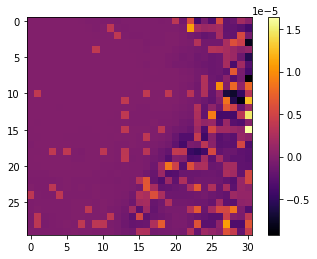

3 18


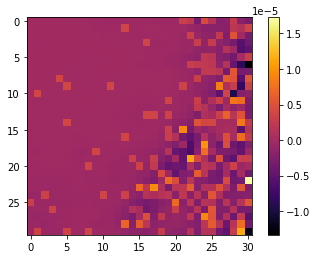

3 19


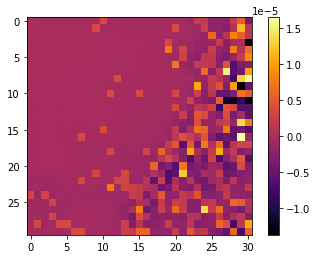

3 20


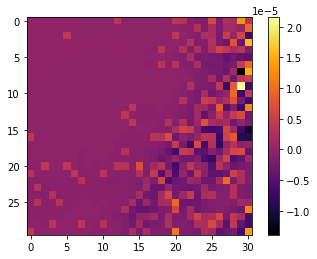

3 21


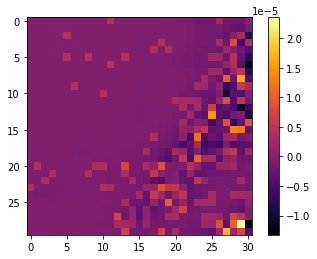

3 22


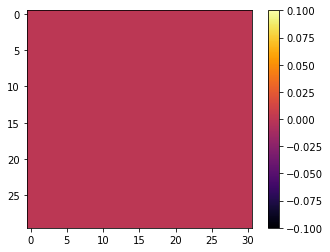

3 23


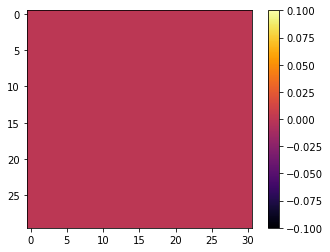

4 0


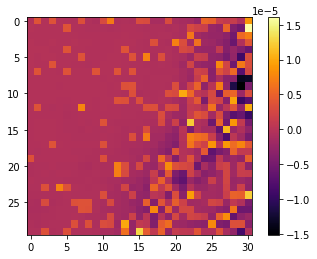

4 1


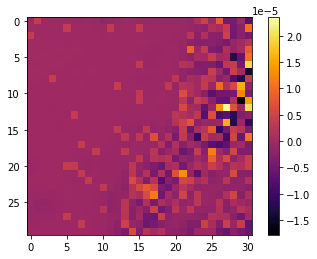

4 2


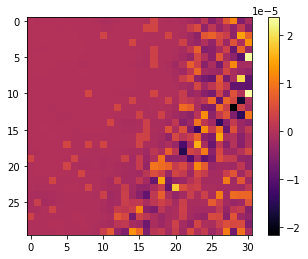

4 3


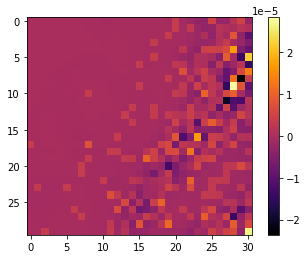

4 4


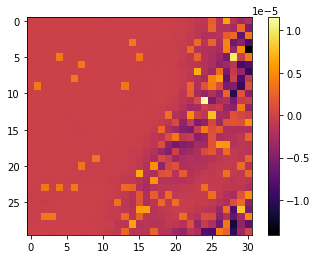

4 5


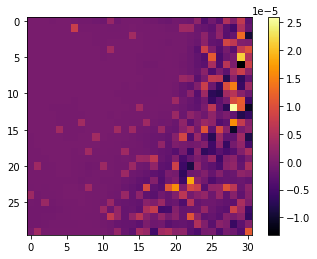

4 6


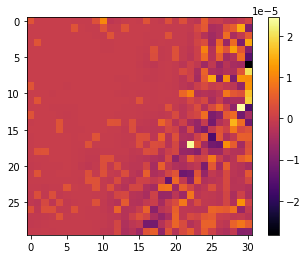

4 7


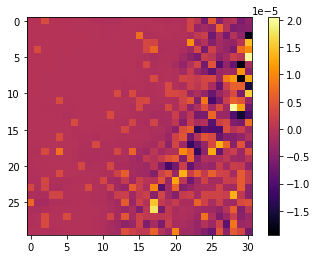

4 8


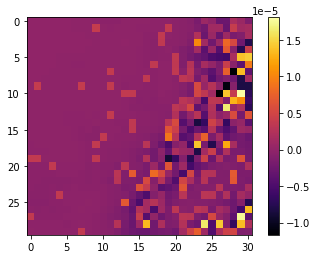

4 9


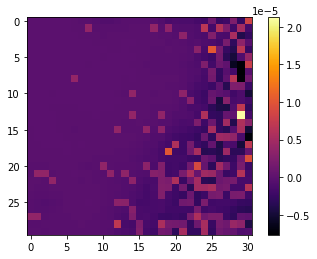

4 10


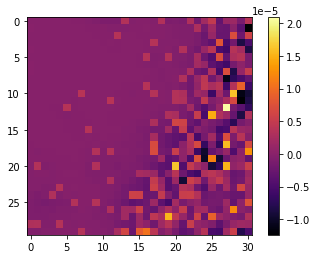

4 11


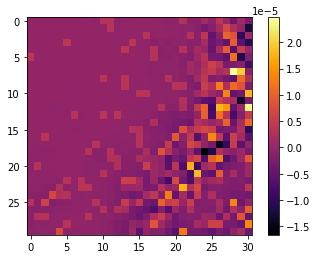

4 12


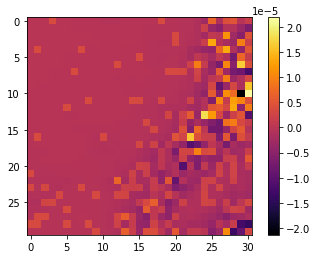

4 13


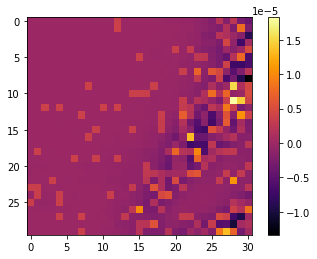

4 14


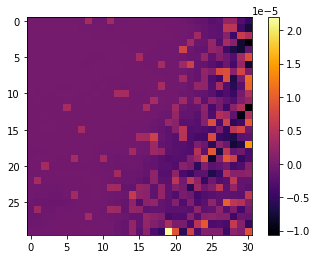

4 15


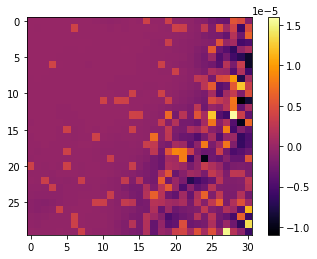

4 16


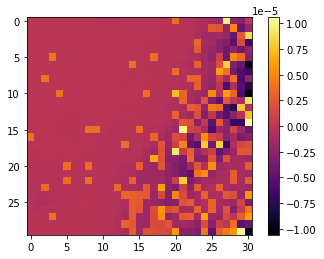

4 17


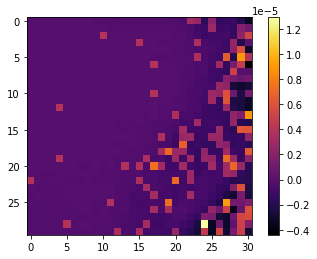

4 18


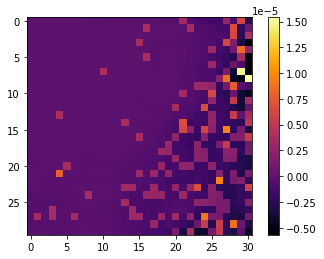

4 19


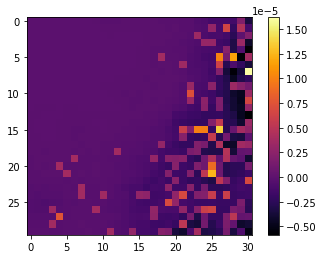

4 20


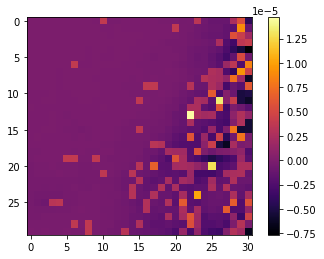

4 21


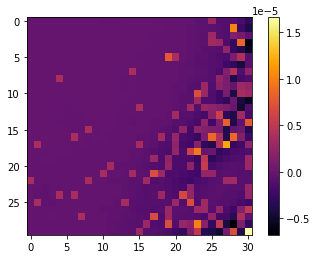

4 22


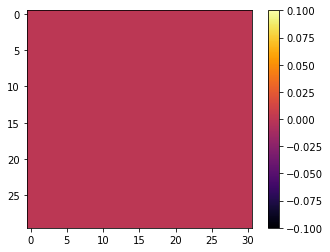

4 23


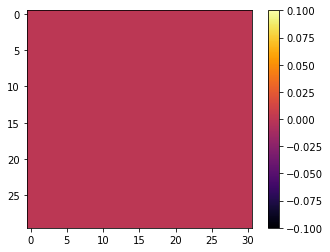

5 0


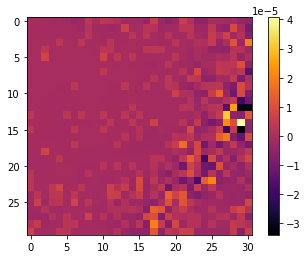

5 1


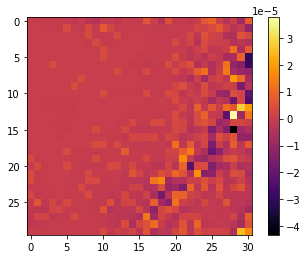

5 2


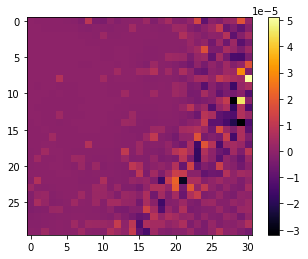

5 3


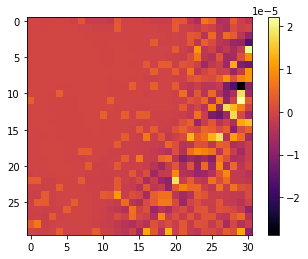

5 4


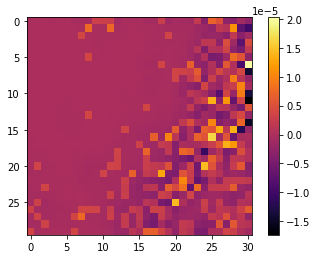

5 5


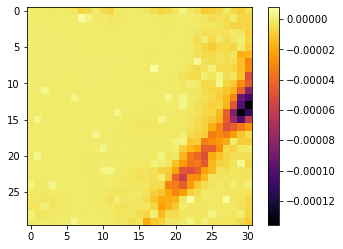

5 6


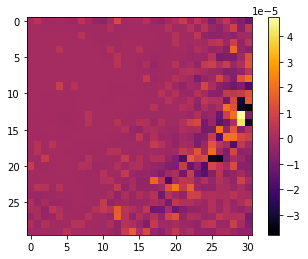

5 7


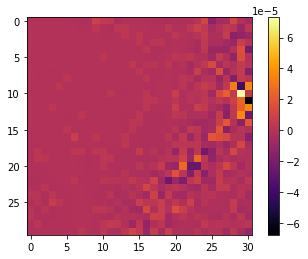

5 8


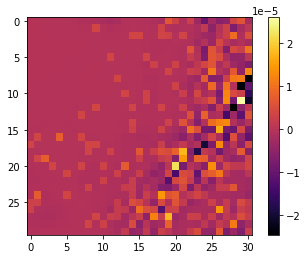

5 9


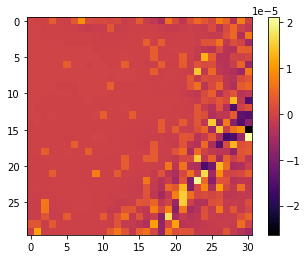

5 10


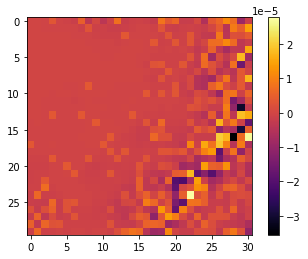

5 11


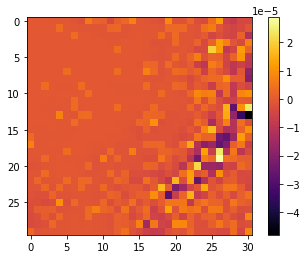

5 12


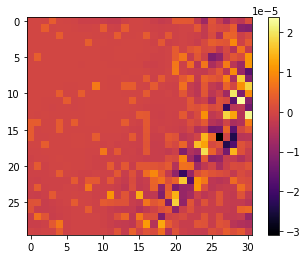

5 13


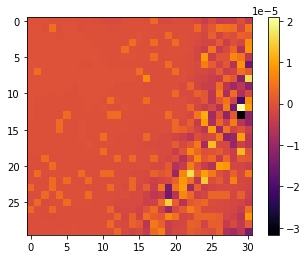

5 14


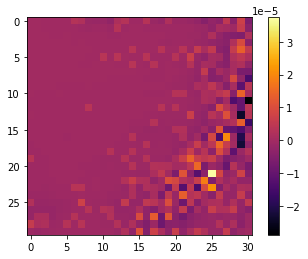

5 15


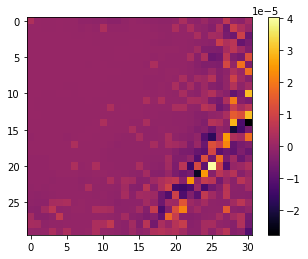

5 16


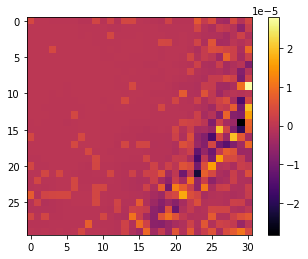

5 17


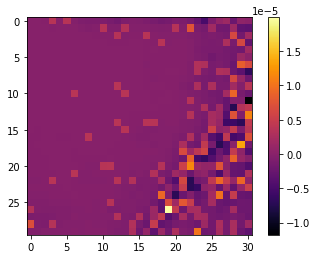

5 18


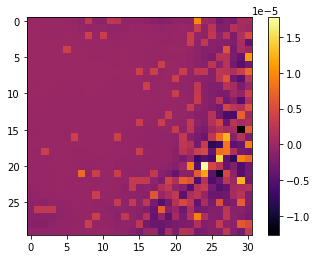

5 19


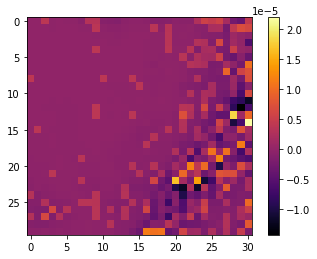

5 20


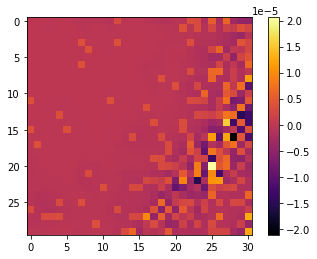

5 21


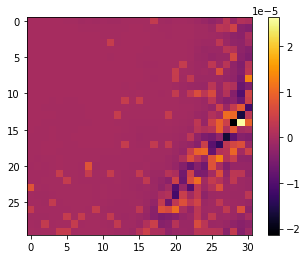

5 22


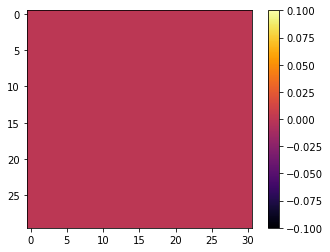

5 23


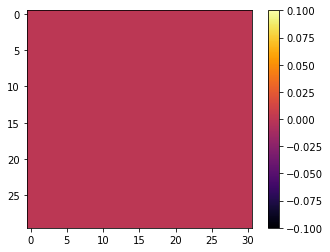

6 0


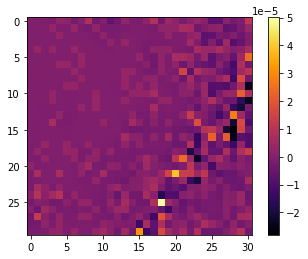

6 1


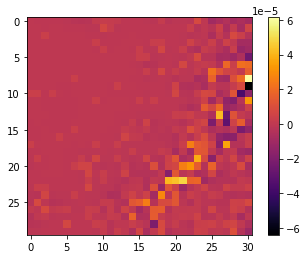

6 2


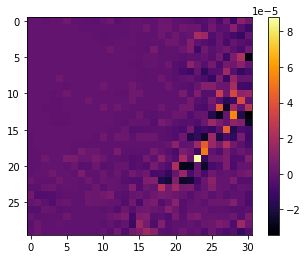

6 3


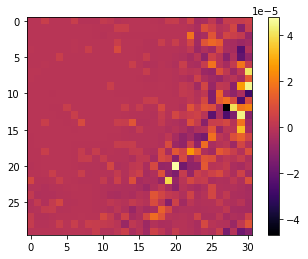

6 4


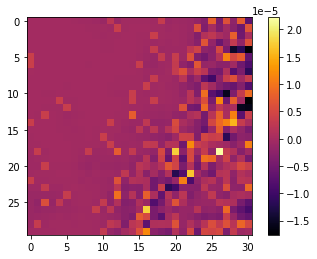

6 5


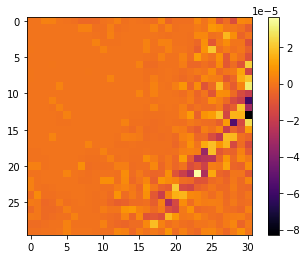

6 6


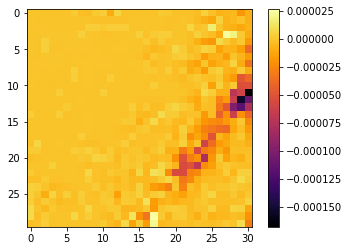

6 7


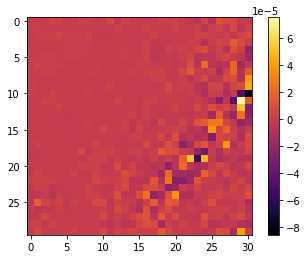

6 8


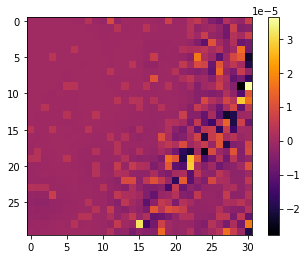

6 9


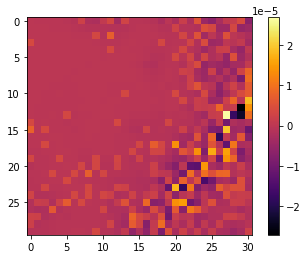

6 10


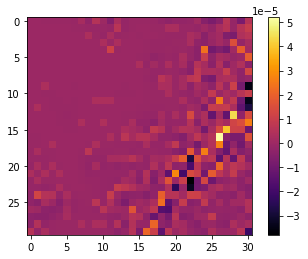

6 11


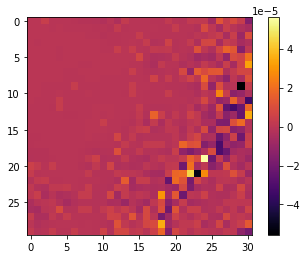

6 12


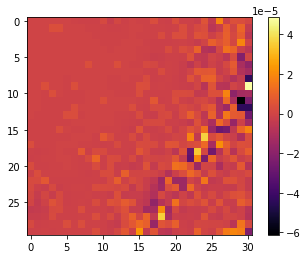

6 13


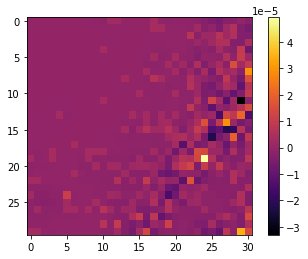

6 14


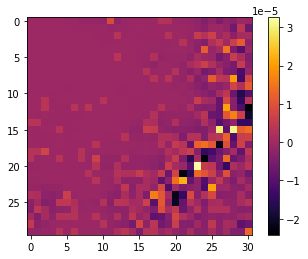

6 15


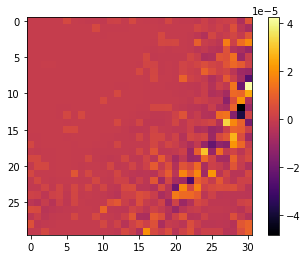

6 16


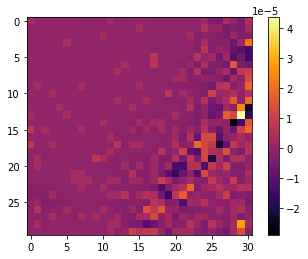

6 17


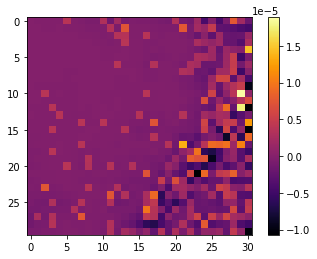

6 18


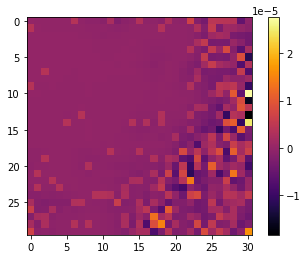

6 19


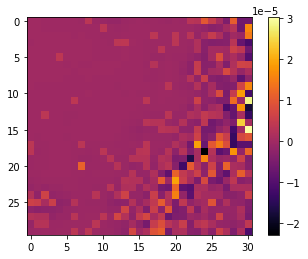

6 20


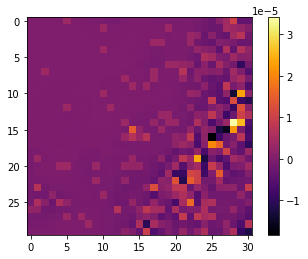

6 21


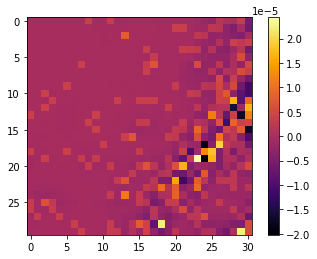

6 22


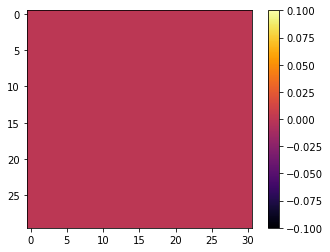

6 23


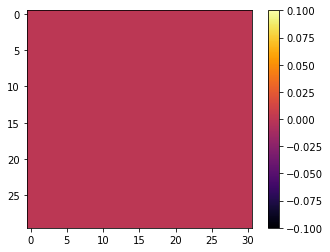

7 0


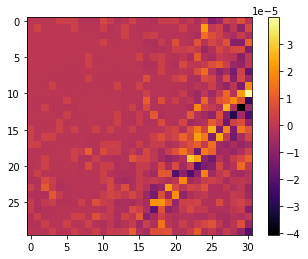

7 1


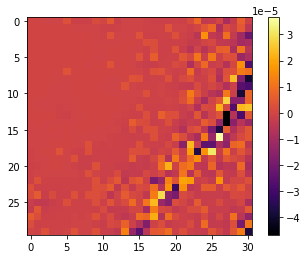

7 2


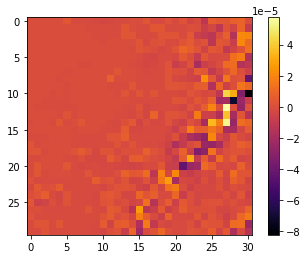

7 3


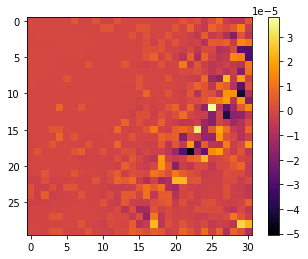

7 4


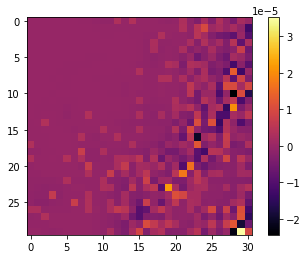

7 5


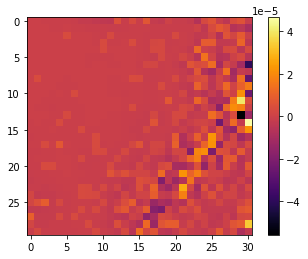

7 6


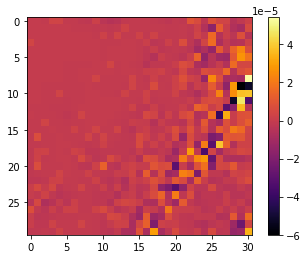

7 7


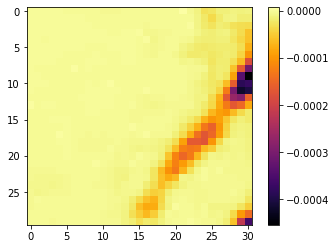

7 8


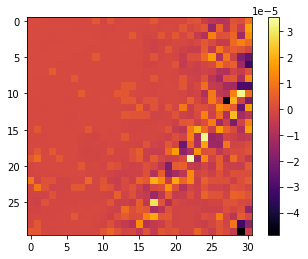

7 9


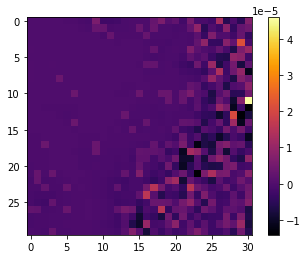

7 10


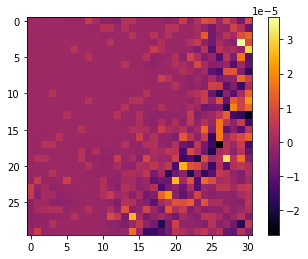

7 11


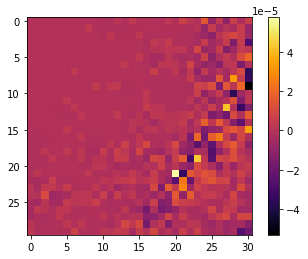

7 12


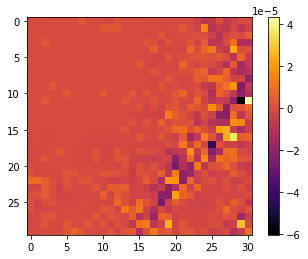

7 13


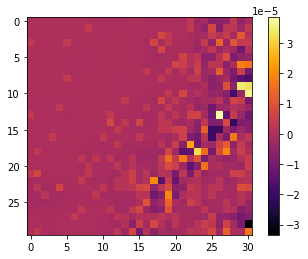

7 14


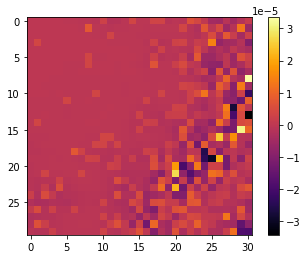

7 15


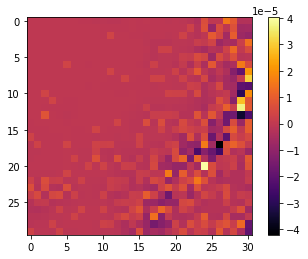

7 16


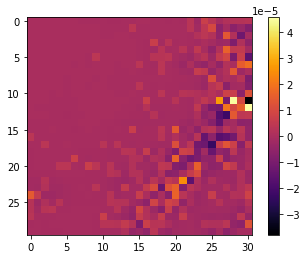

7 17


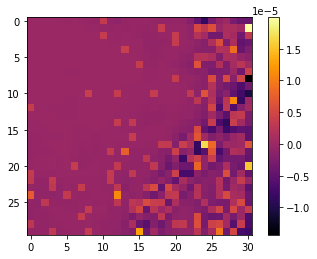

7 18


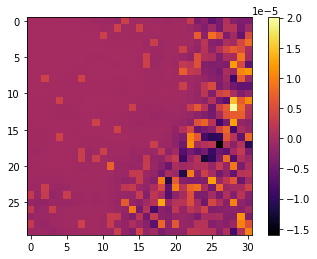

7 19


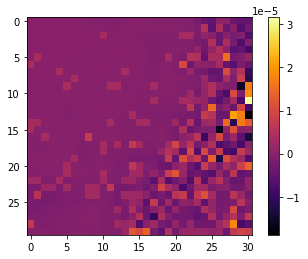

7 20


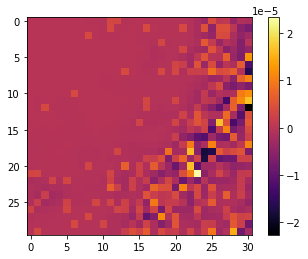

7 21


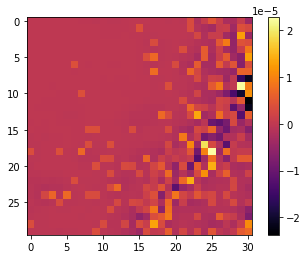

7 22


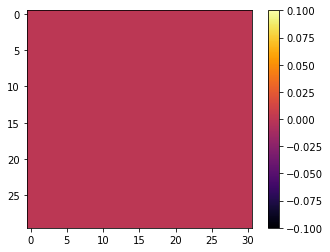

7 23


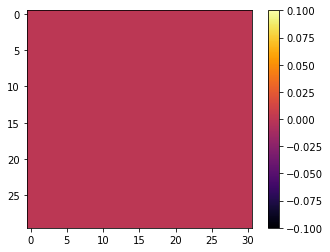

8 0


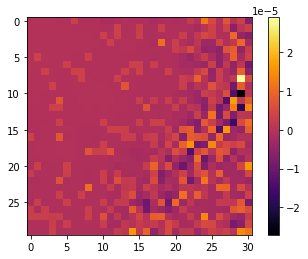

8 1


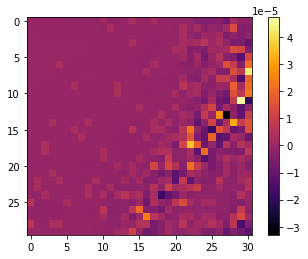

8 2


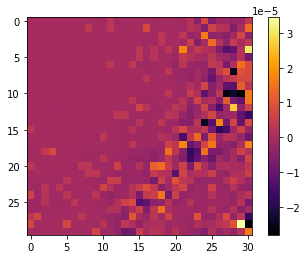

8 3


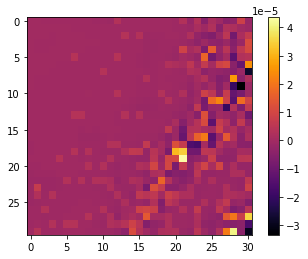

8 4


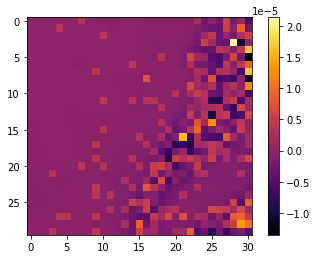

8 5


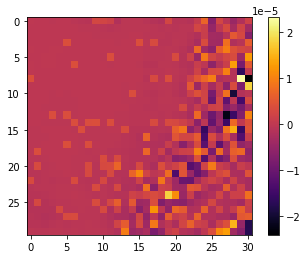

8 6


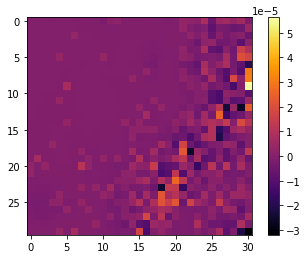

8 7


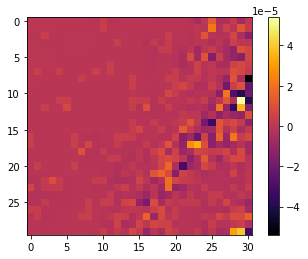

8 8


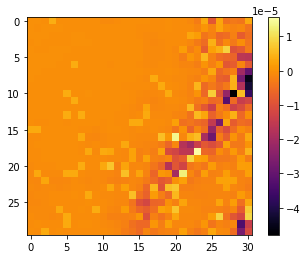

8 9


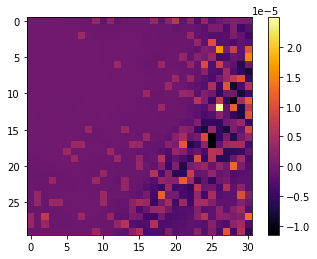

8 10


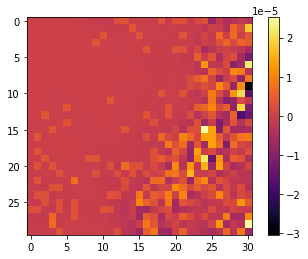

8 11


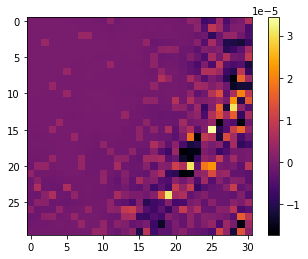

8 12


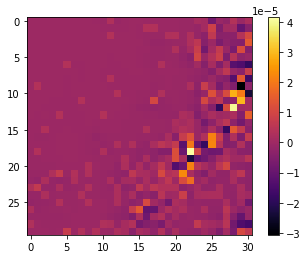

8 13


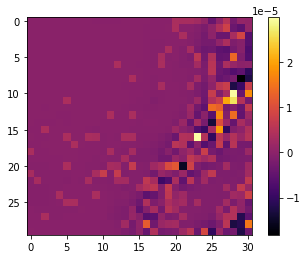

8 14


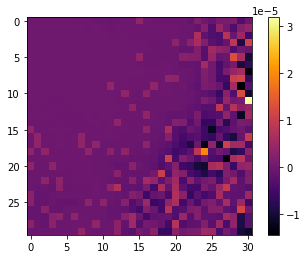

8 15


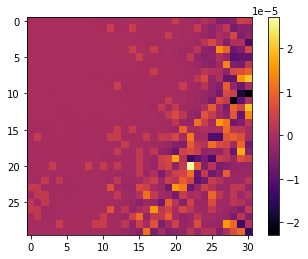

8 16


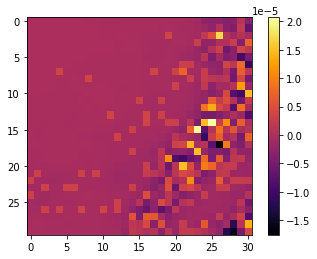

8 17


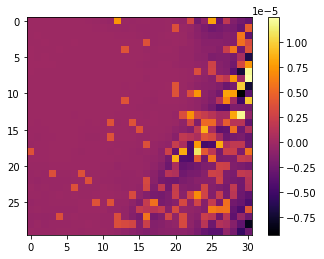

8 18


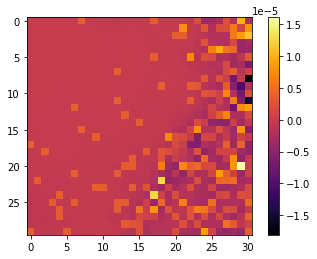

8 19


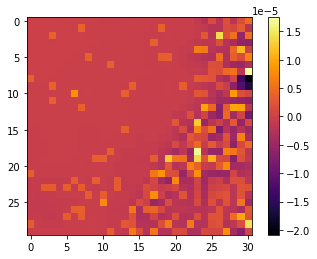

8 20


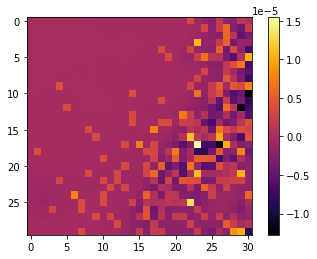

8 21


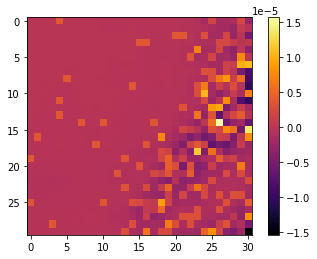

8 22


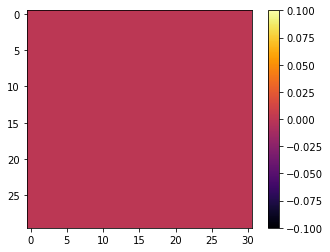

8 23


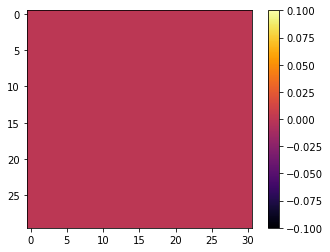

9 0


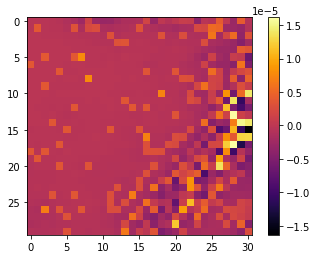

9 1


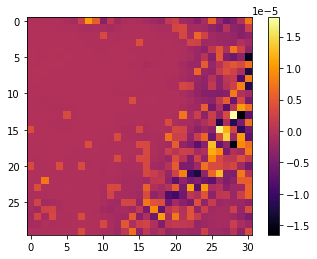

9 2


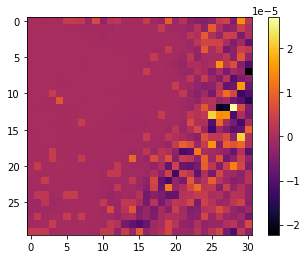

9 3


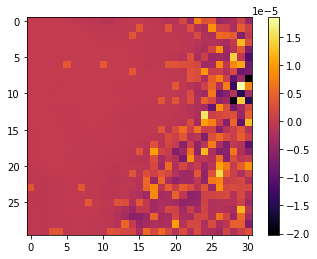

9 4


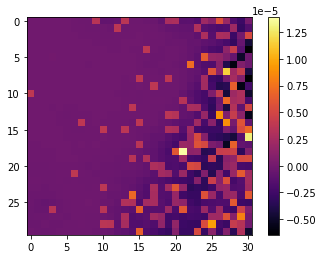

9 5


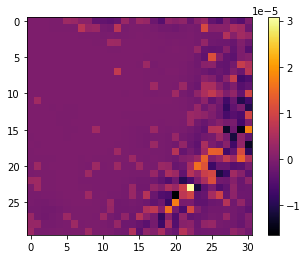

9 6


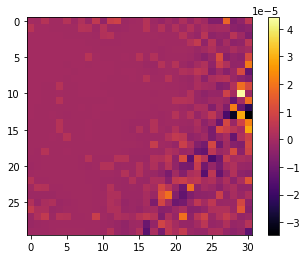

9 7


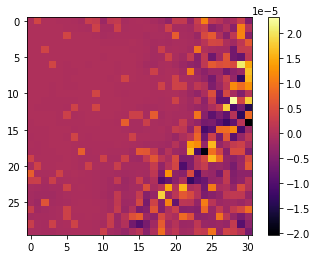

9 8


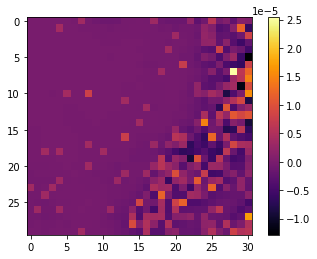

9 9


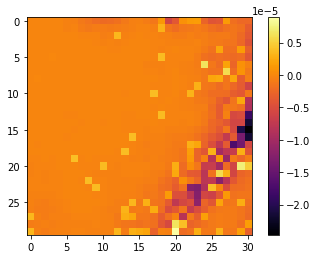

9 10


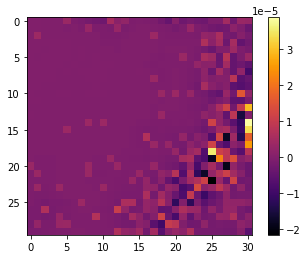

9 11


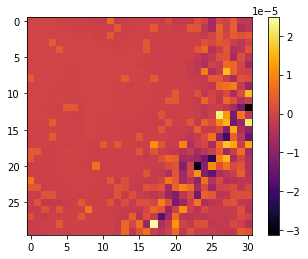

9 12


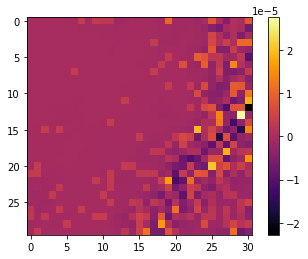

9 13


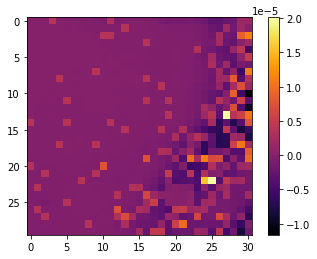

9 14


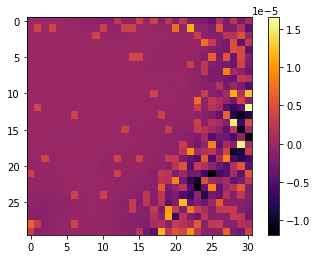

9 15


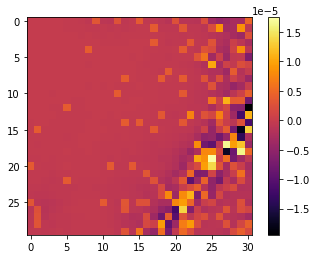

9 16


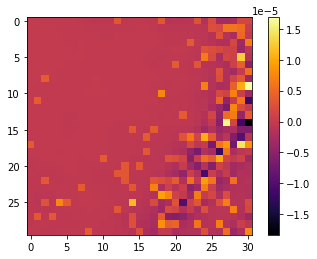

9 17


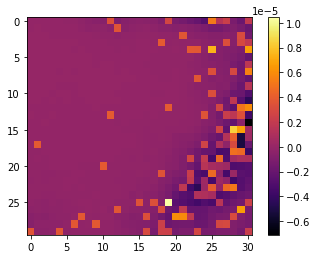

9 18


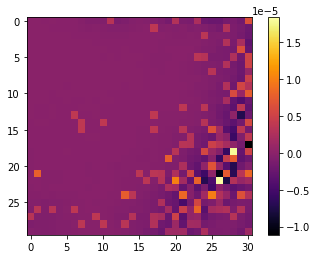

9 19


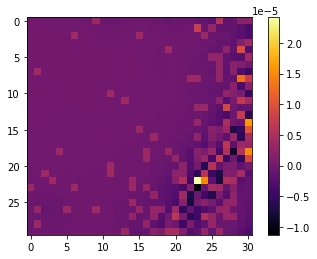

9 20


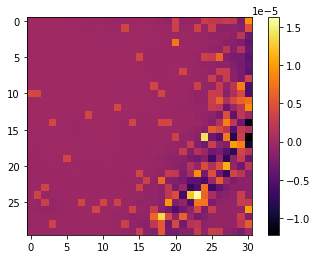

9 21


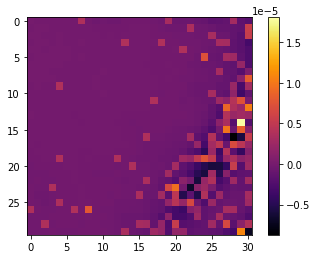

9 22


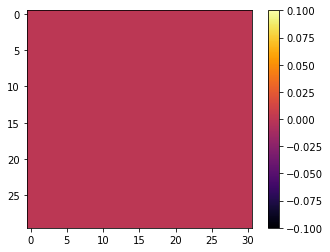

9 23


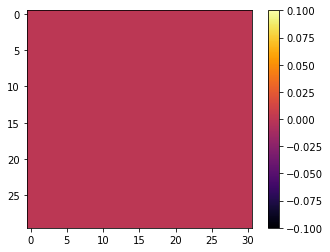

10 0


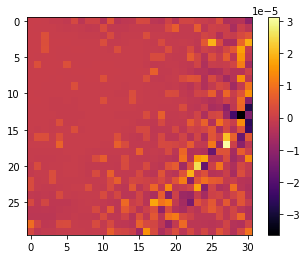

10 1


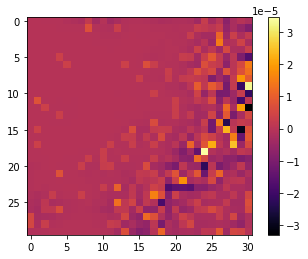

10 2


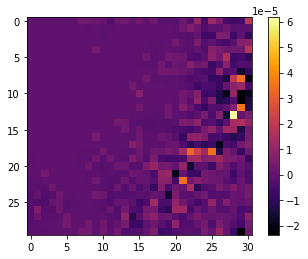

10 3


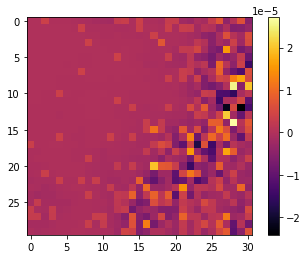

10 4


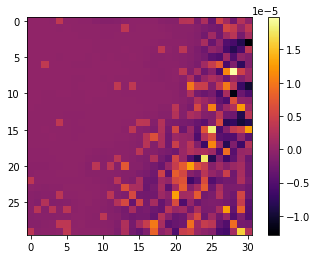

10 5


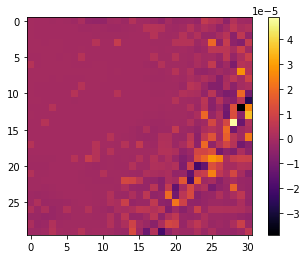

10 6


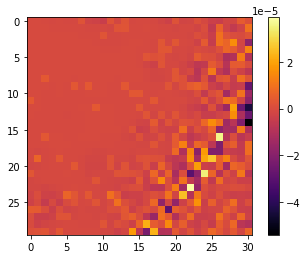

10 7


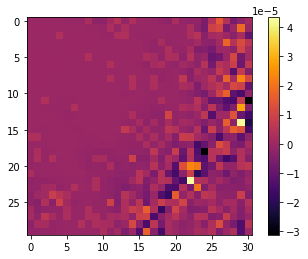

10 8


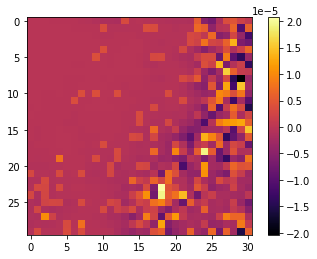

10 9


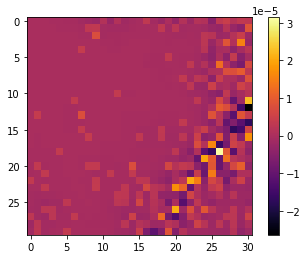

10 10


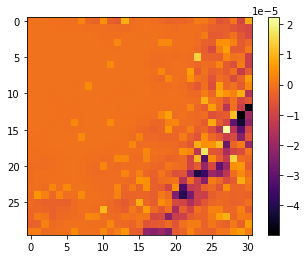

10 11


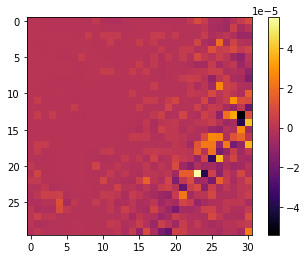

10 12


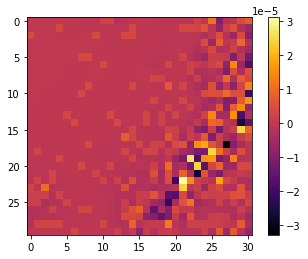

10 13


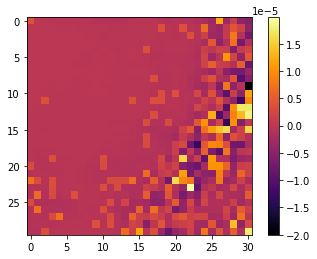

10 14


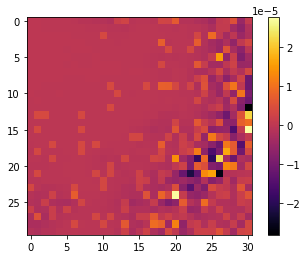

10 15


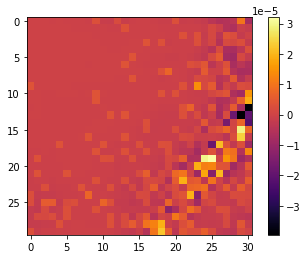

10 16


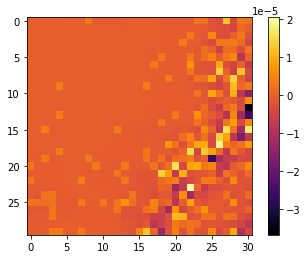

10 17


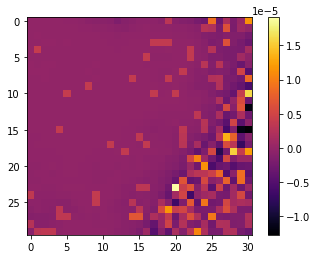

10 18


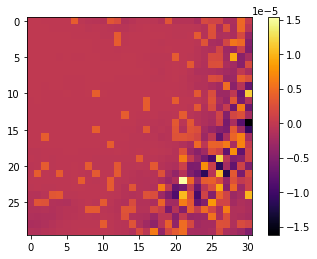

10 19


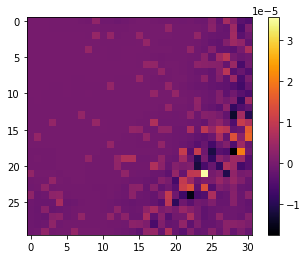

10 20


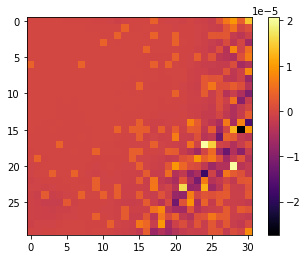

10 21


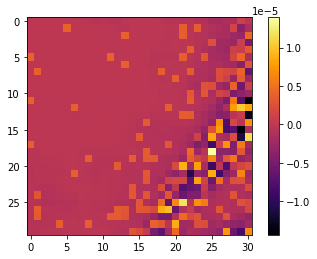

10 22


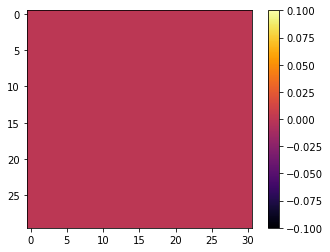

10 23


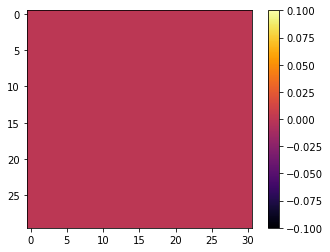

11 0


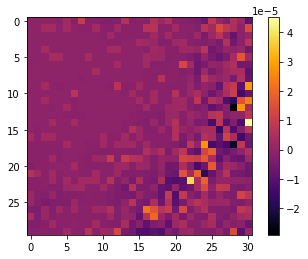

11 1


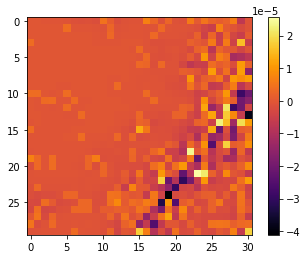

11 2


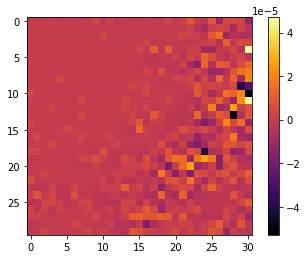

11 3


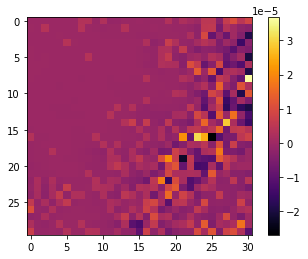

11 4


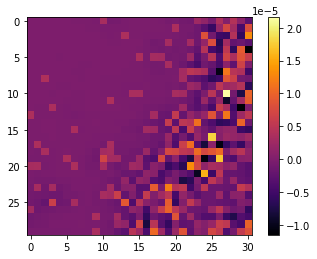

11 5


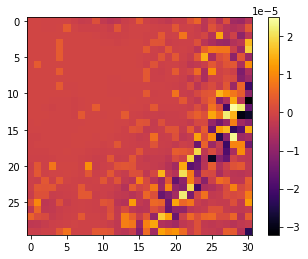

11 6


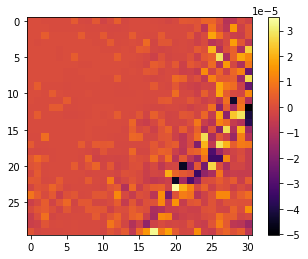

11 7


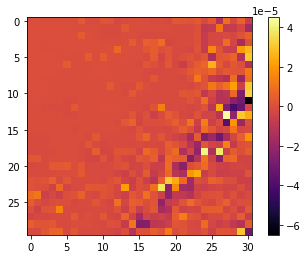

11 8


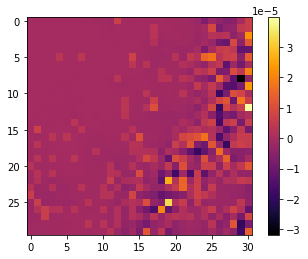

11 9


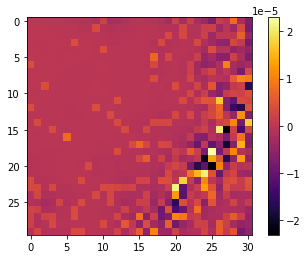

11 10


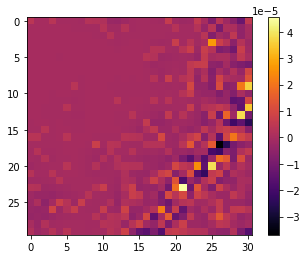

11 11


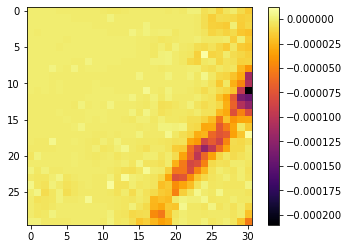

11 12


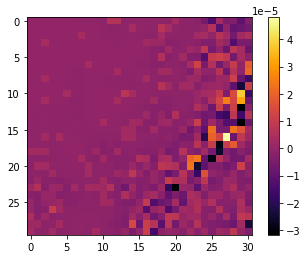

11 13


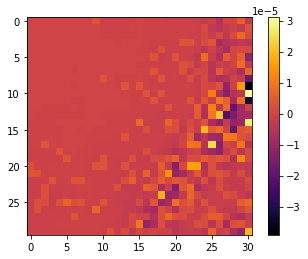

11 14


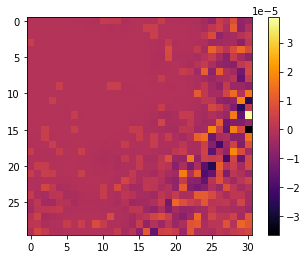

11 15


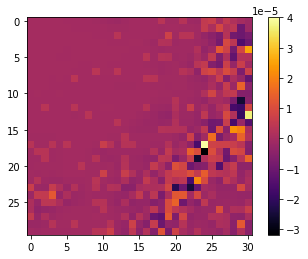

11 16


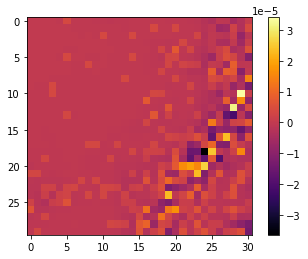

11 17


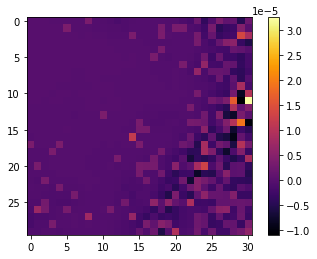

11 18


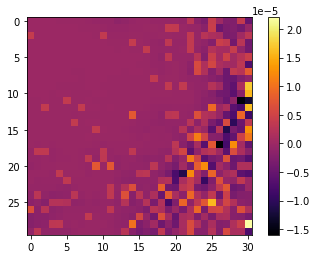

11 19


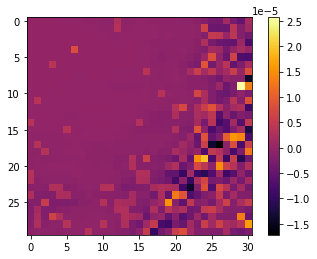

11 20


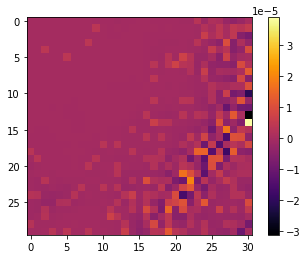

11 21


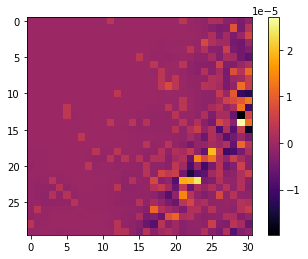

11 22


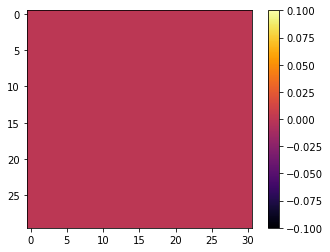

11 23


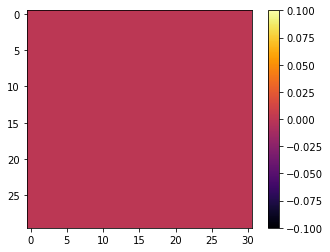

12 0


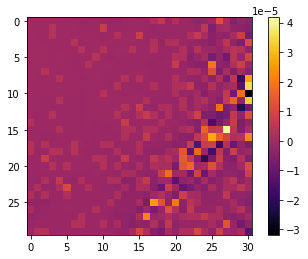

12 1


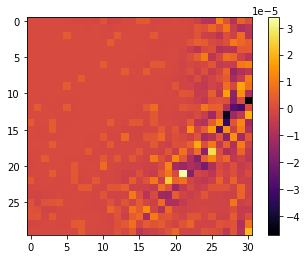

12 2


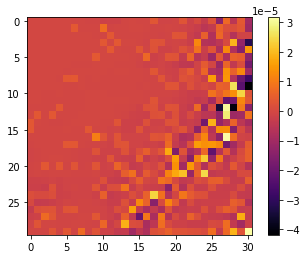

12 3


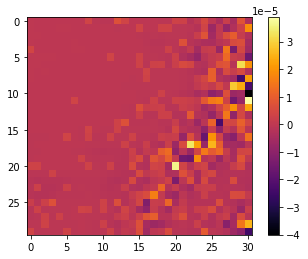

12 4


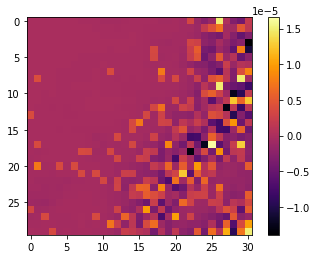

12 5


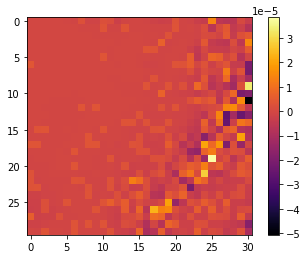

12 6


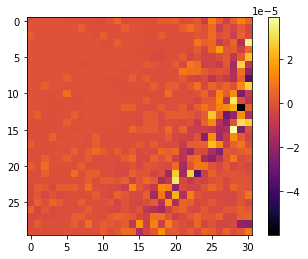

12 7


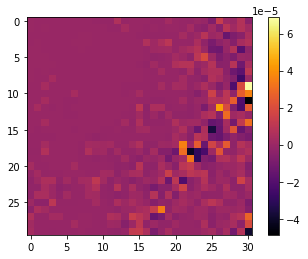

12 8


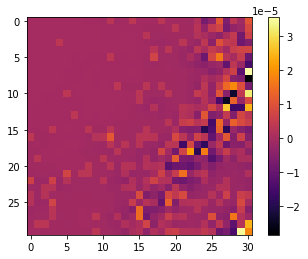

12 9


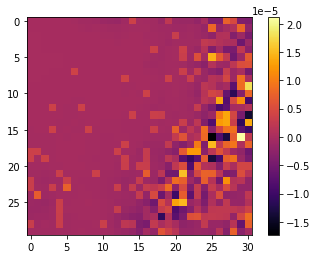

12 10


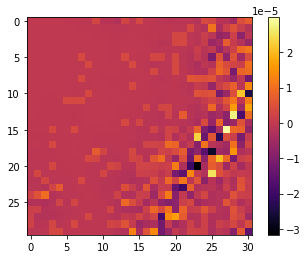

12 11


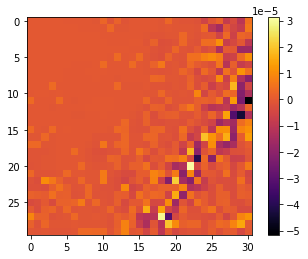

12 12


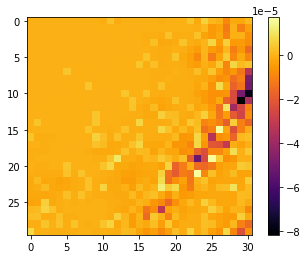

12 13


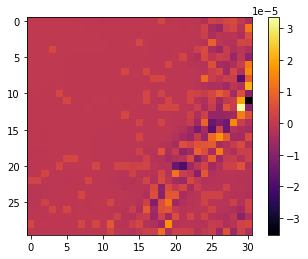

12 14


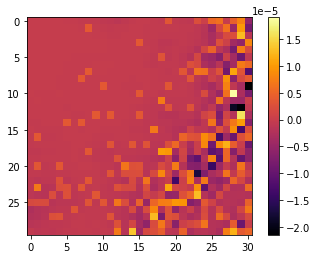

12 15


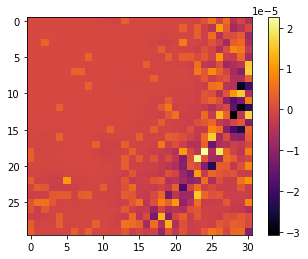

12 16


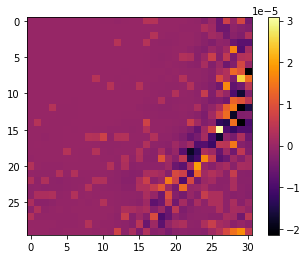

12 17


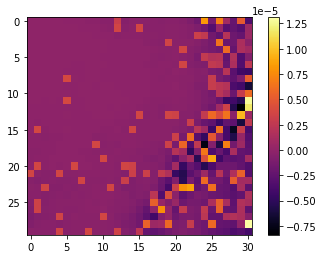

12 18


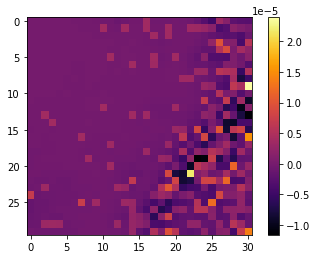

12 19


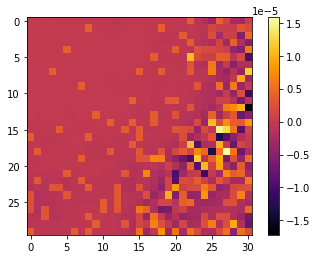

12 20


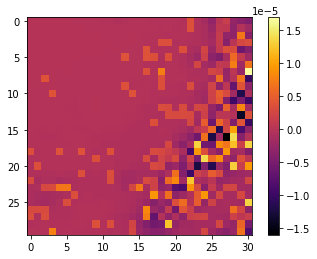

12 21


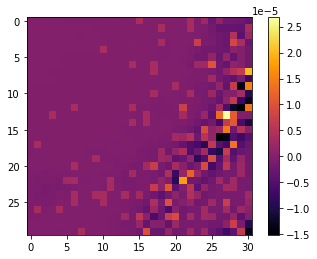

12 22


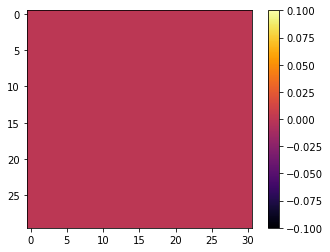

12 23


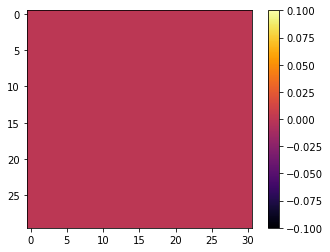

13 0


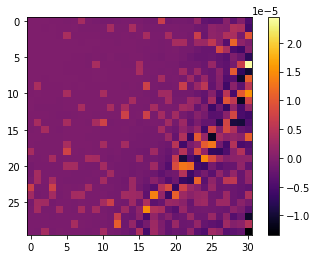

13 1


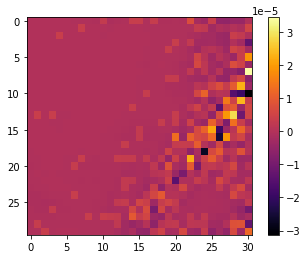

13 2


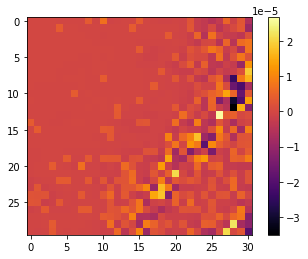

13 3


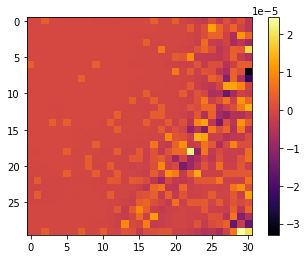

13 4


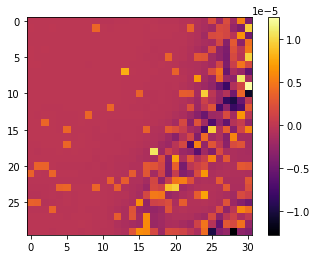

13 5


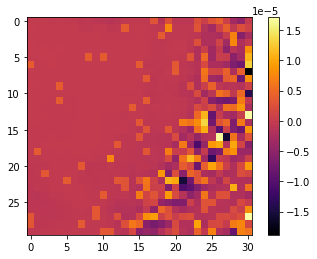

13 6


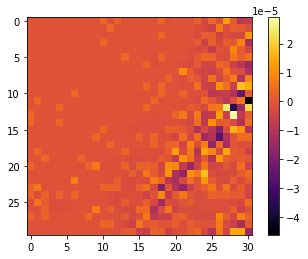

13 7


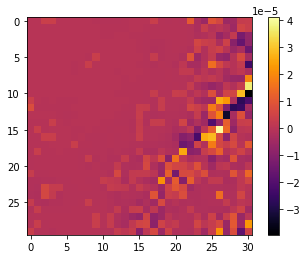

13 8


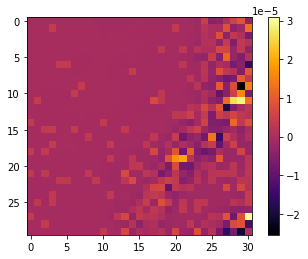

13 9


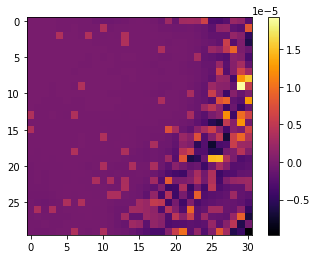

13 10


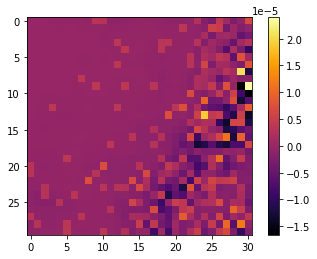

13 11


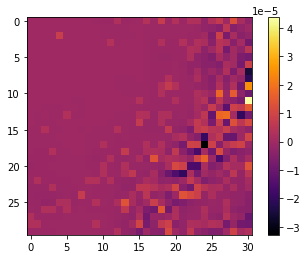

13 12


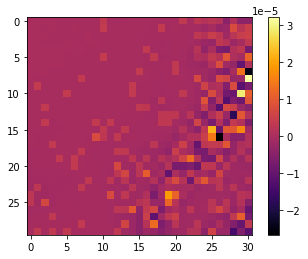

13 13


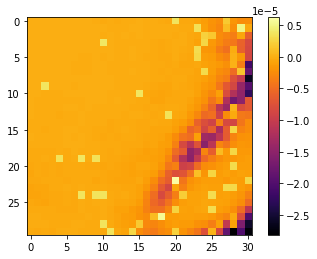

13 14


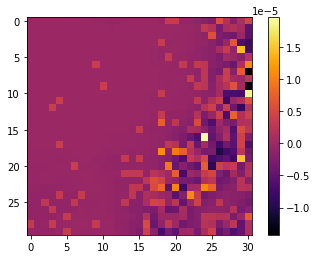

13 15


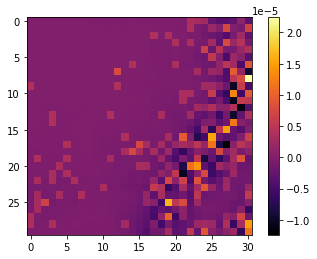

13 16


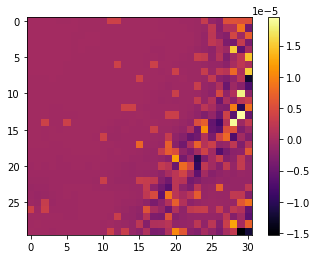

13 17


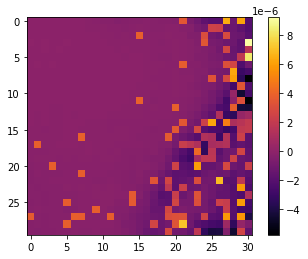

13 18


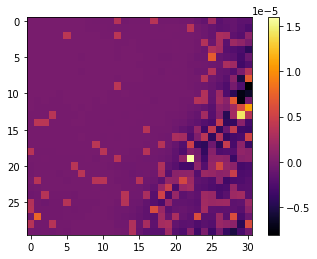

13 19


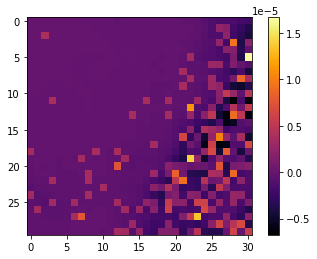

13 20


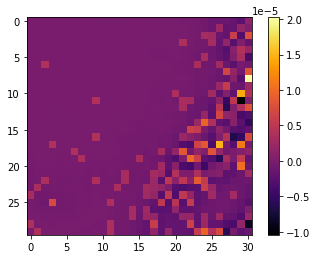

13 21


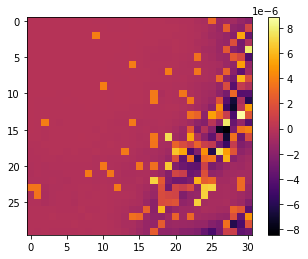

13 22


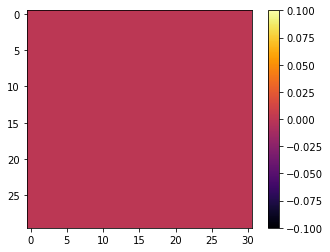

13 23


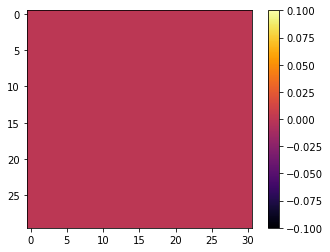

14 0


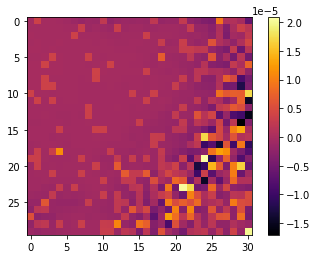

14 1


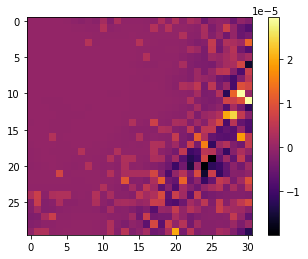

14 2


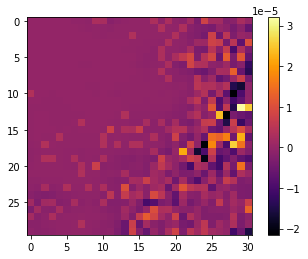

14 3


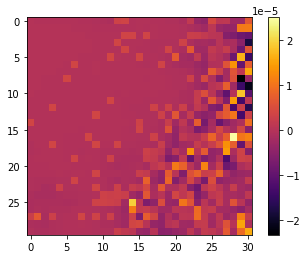

14 4


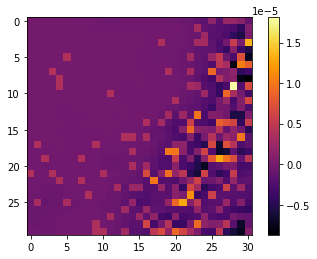

14 5


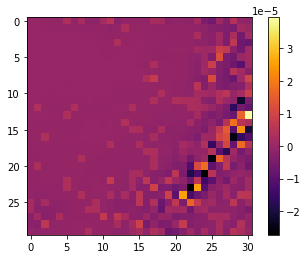

14 6


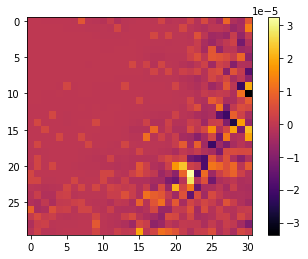

14 7


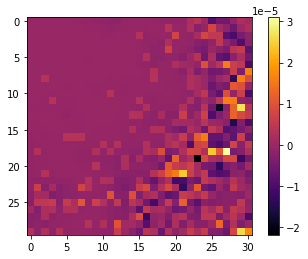

14 8


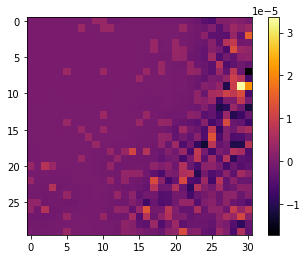

14 9


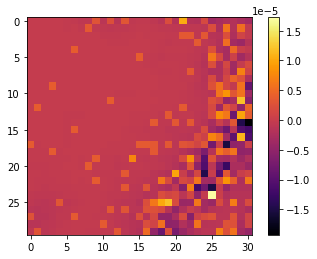

14 10


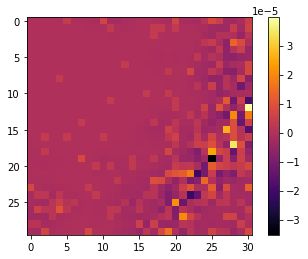

14 11


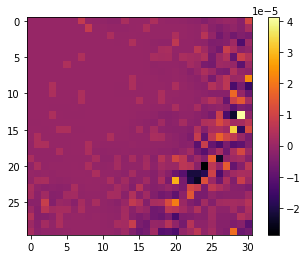

14 12


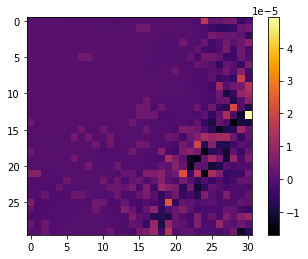

14 13


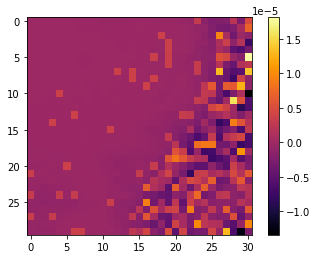

14 14


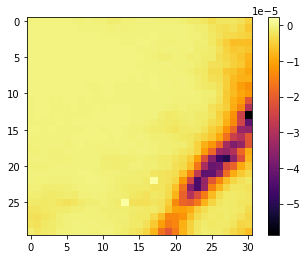

14 15


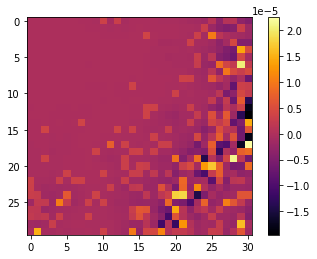

14 16


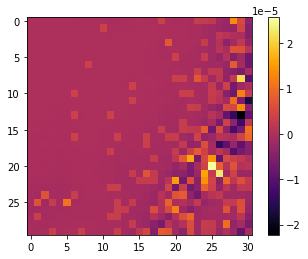

14 17


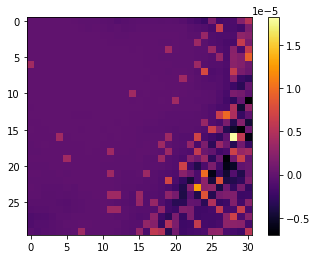

14 18


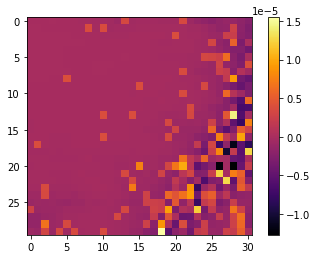

14 19


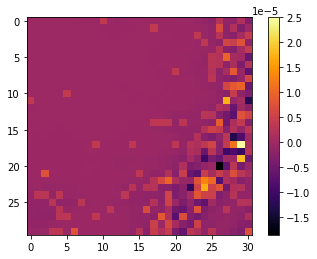

14 20


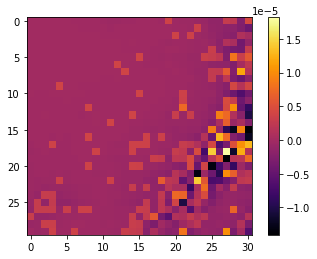

14 21


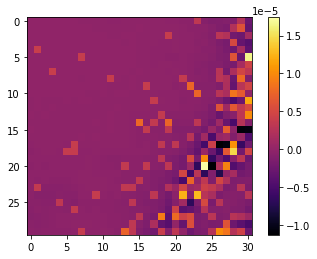

14 22


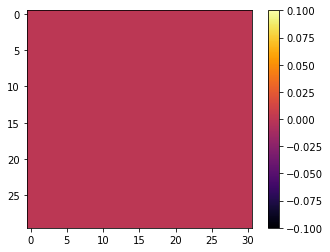

14 23


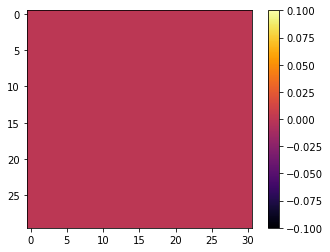

15 0


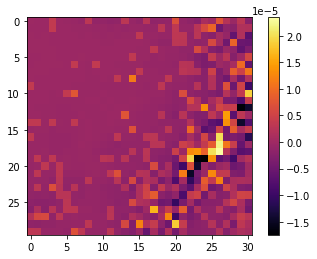

15 1


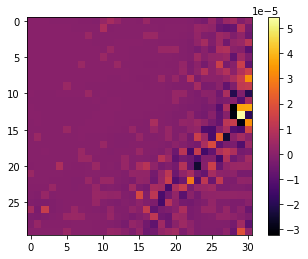

15 2


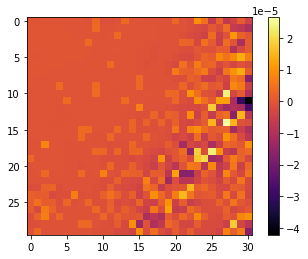

15 3


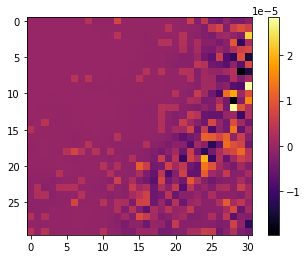

15 4


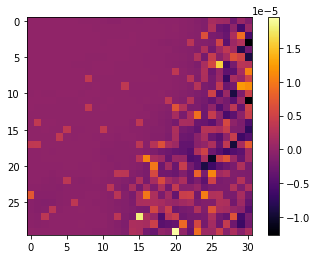

15 5


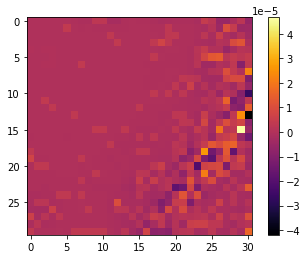

15 6


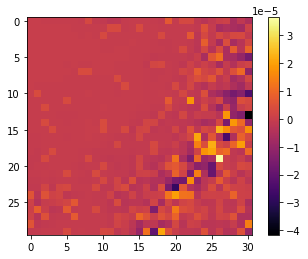

15 7


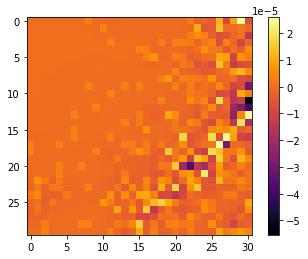

15 8


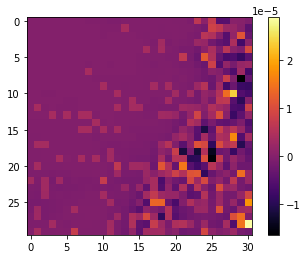

15 9


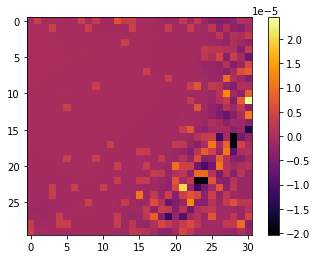

15 10


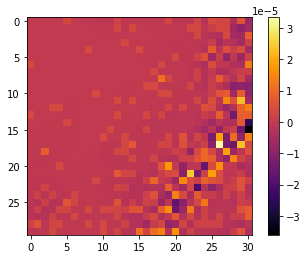

15 11


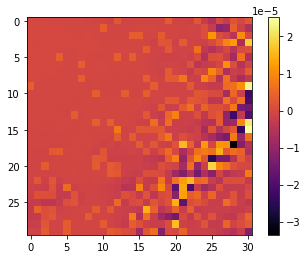

15 12


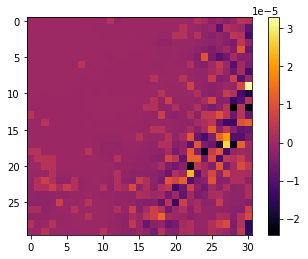

15 13


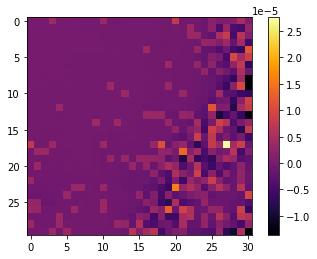

15 14


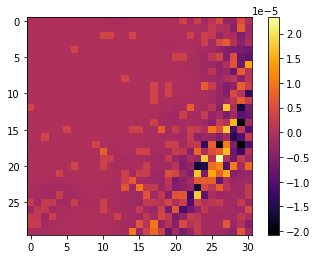

15 15


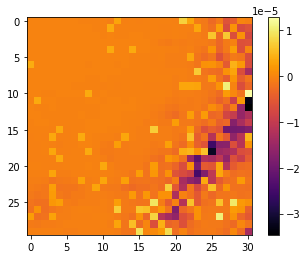

15 16


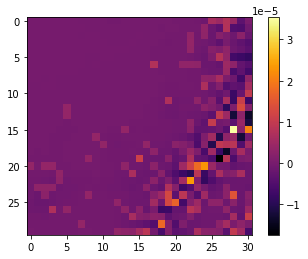

15 17


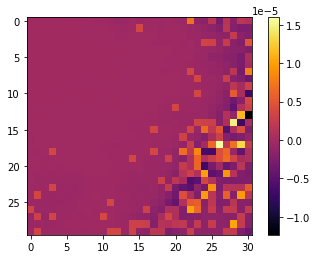

15 18


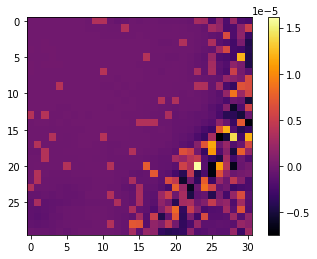

15 19


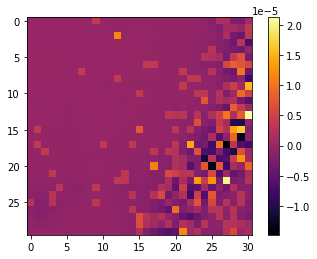

15 20


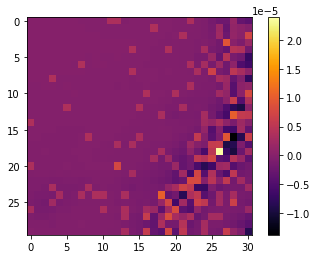

15 21


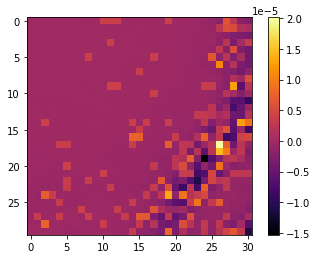

15 22


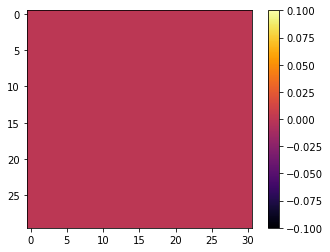

15 23


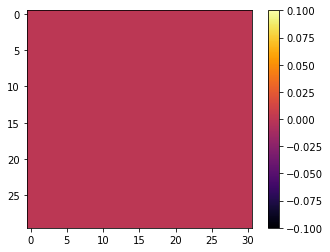

16 0


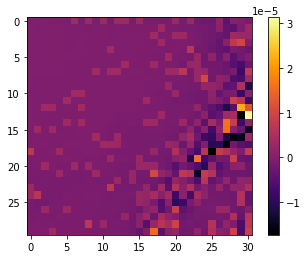

16 1


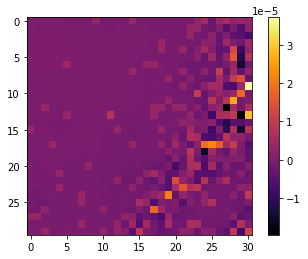

16 2


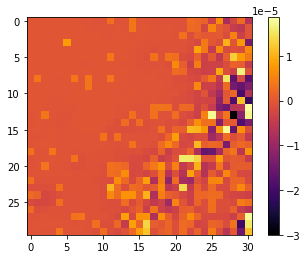

16 3


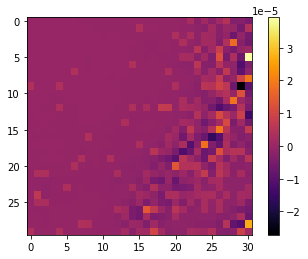

16 4


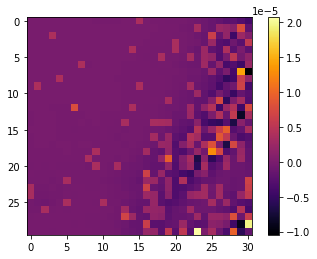

16 5


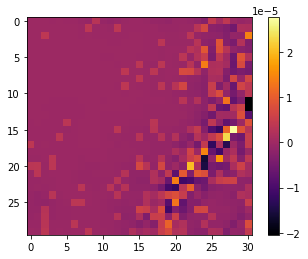

16 6


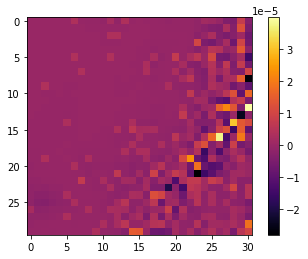

16 7


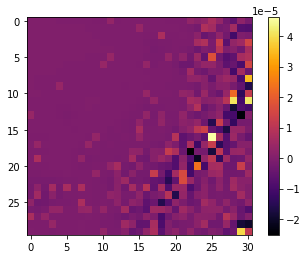

16 8


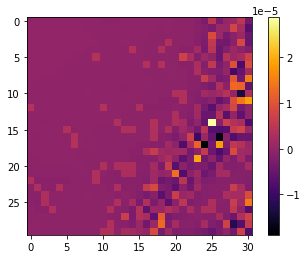

16 9


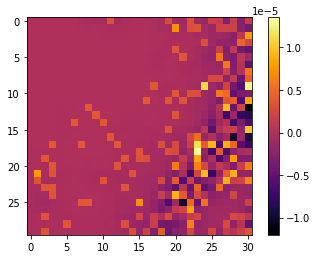

16 10


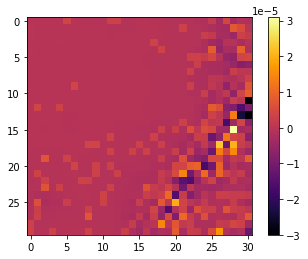

16 11


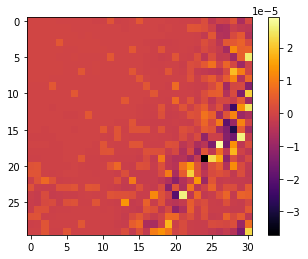

16 12


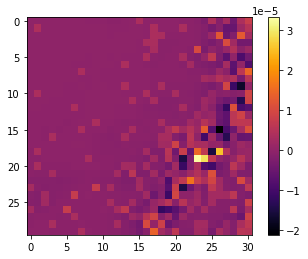

16 13


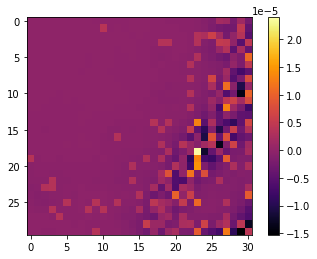

16 14


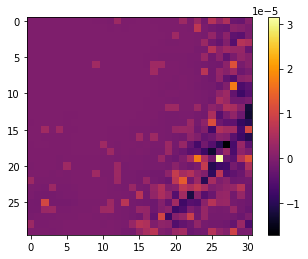

16 15


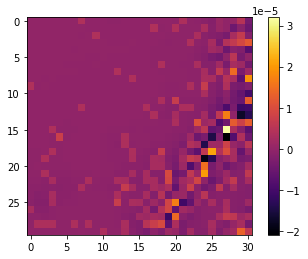

16 16


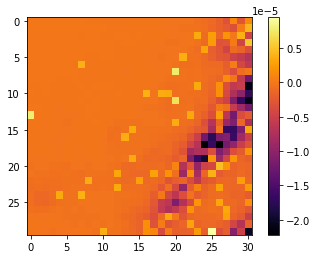

16 17


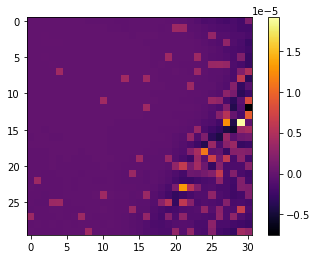

16 18


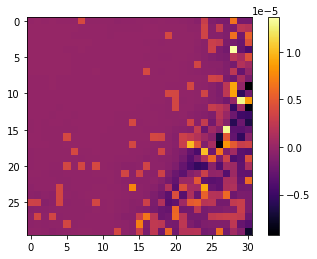

16 19


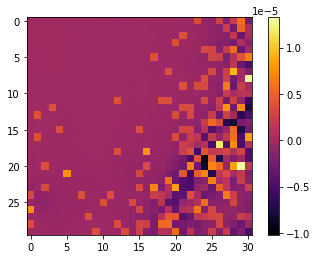

16 20


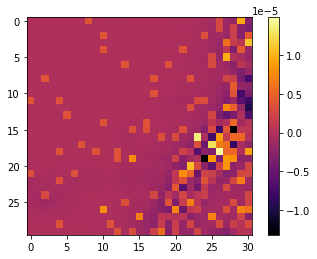

16 21


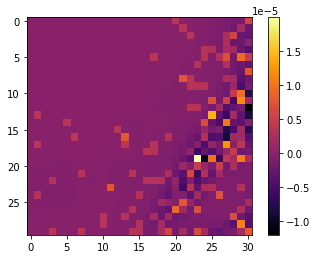

16 22


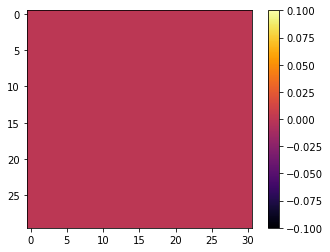

16 23


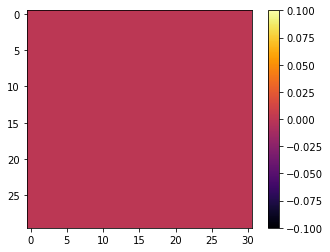

17 0


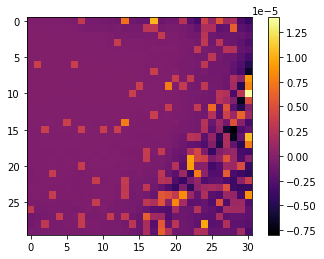

17 1


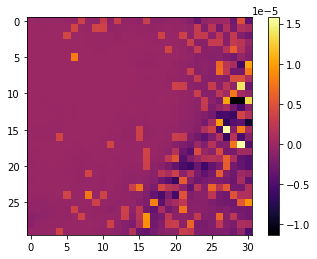

17 2


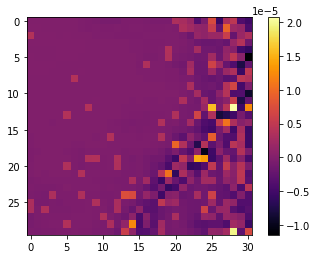

17 3


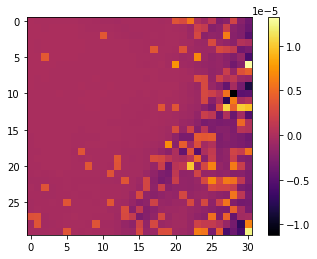

17 4


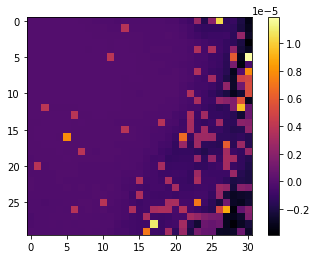

17 5


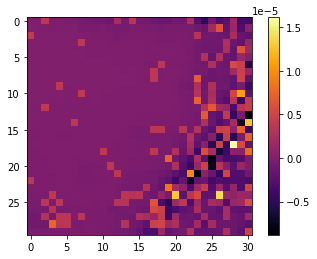

17 6


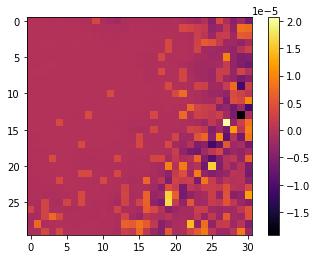

17 7


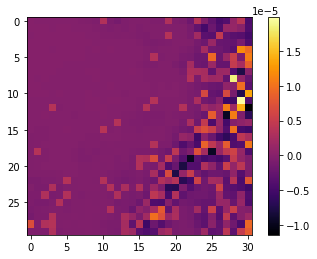

17 8


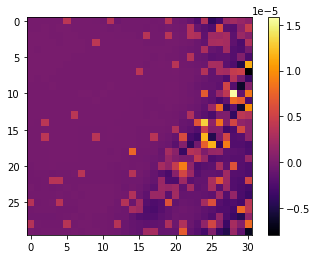

17 9


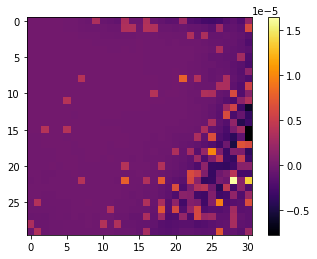

17 10


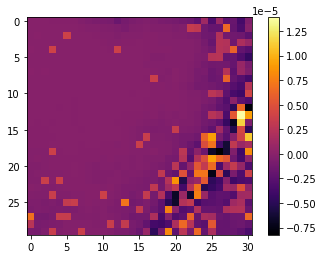

17 11


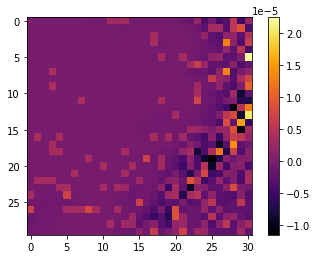

17 12


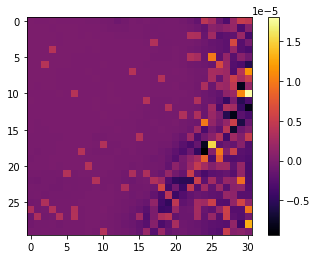

17 13


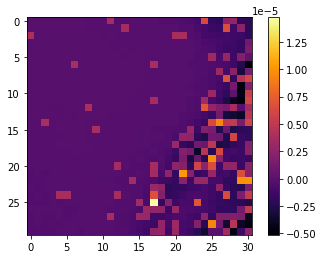

17 14


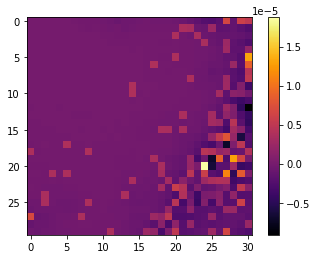

17 15


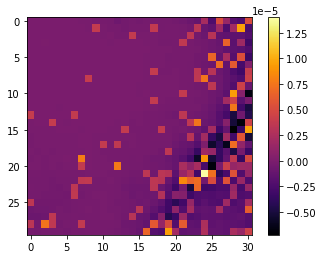

17 16


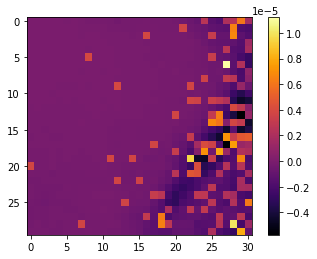

17 17


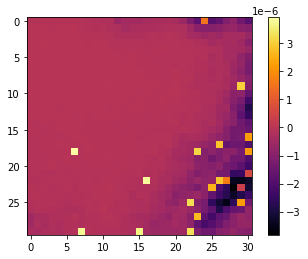

17 18


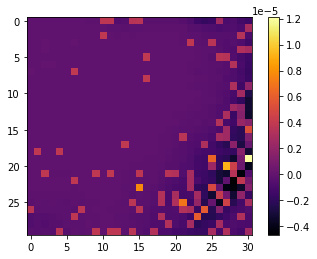

17 19


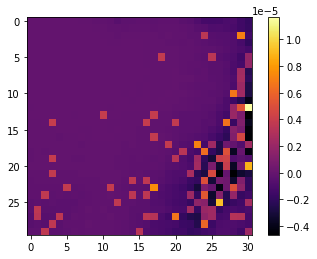

17 20


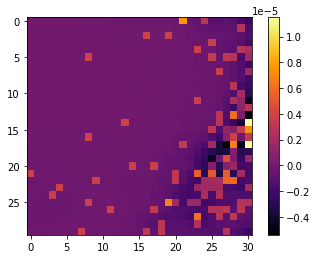

17 21


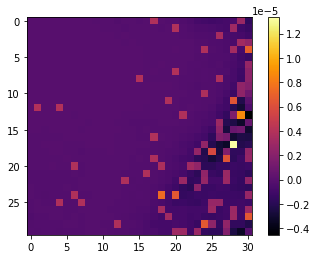

17 22


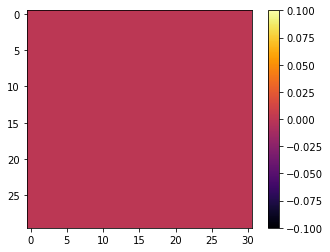

17 23


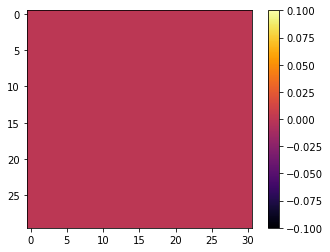

18 0


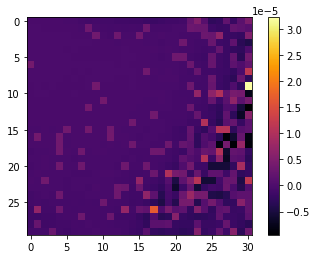

18 1


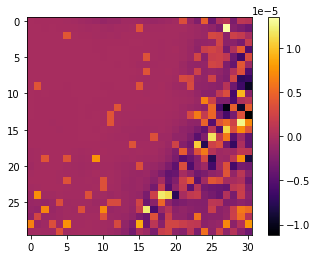

18 2


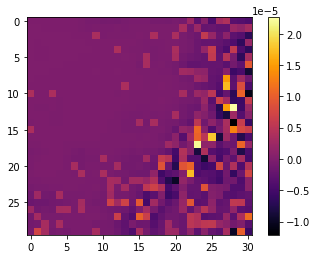

18 3


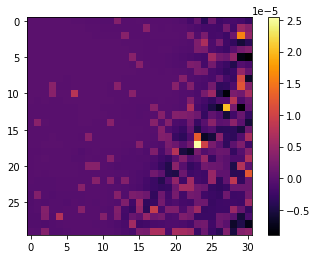

18 4


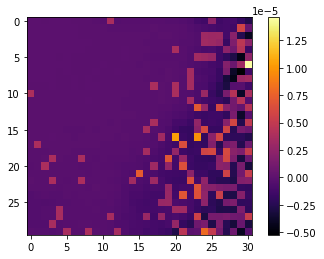

18 5


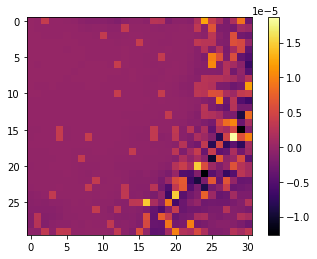

18 6


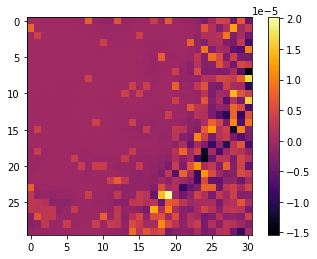

18 7


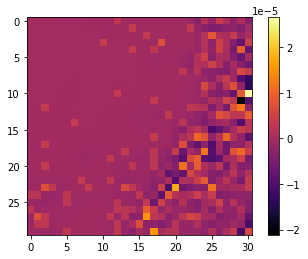

18 8


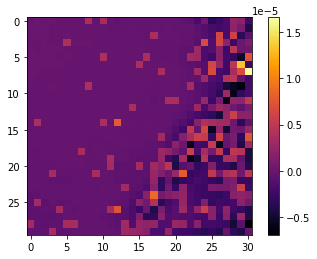

18 9


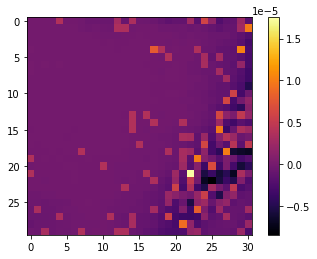

18 10


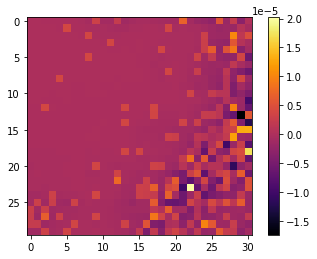

18 11


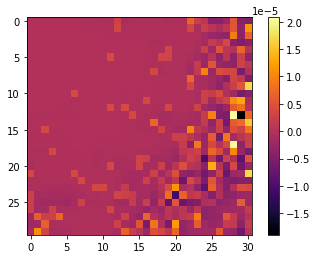

18 12


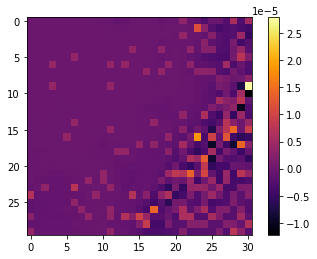

18 13


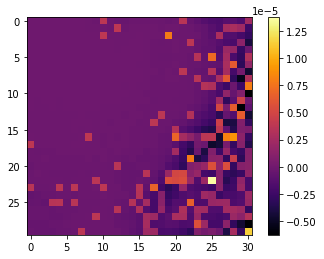

18 14


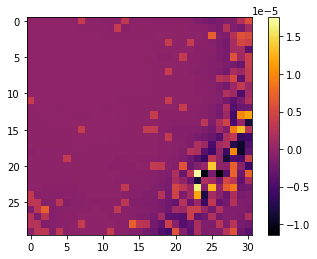

18 15


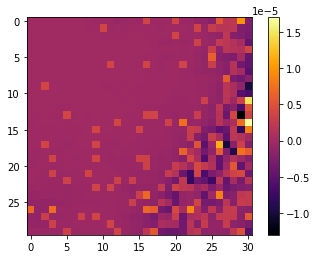

18 16


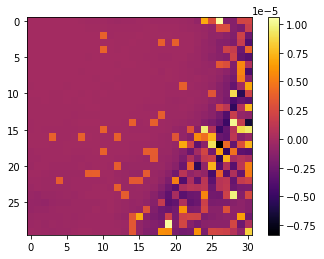

18 17


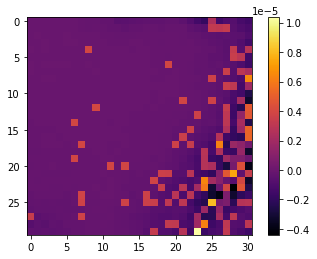

18 18


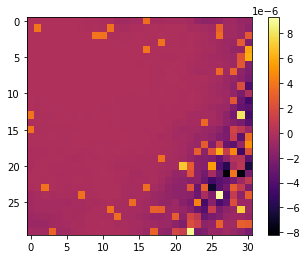

18 19


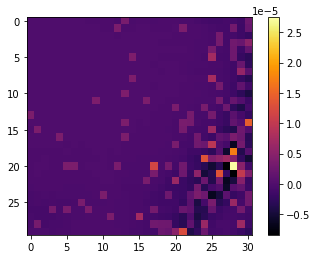

18 20


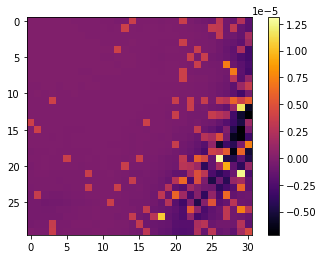

18 21


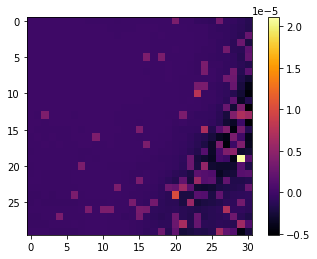

18 22


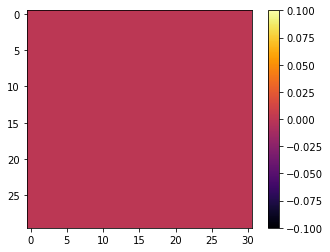

18 23


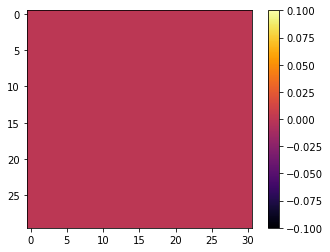

19 0


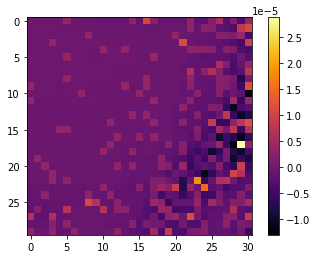

19 1


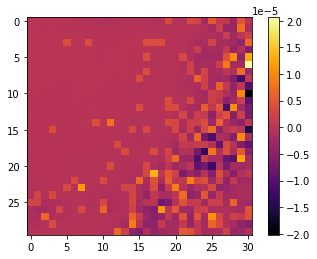

19 2


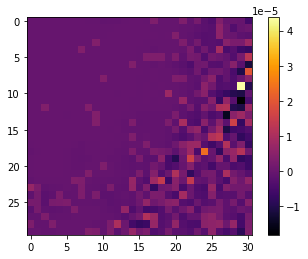

19 3


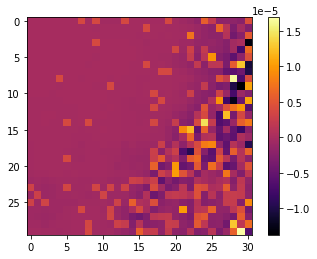

19 4


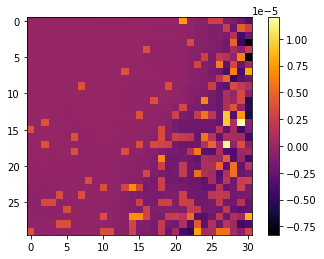

19 5


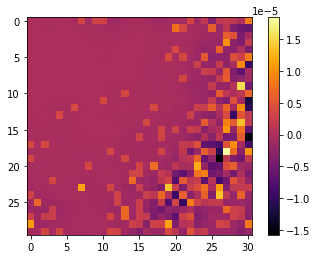

19 6


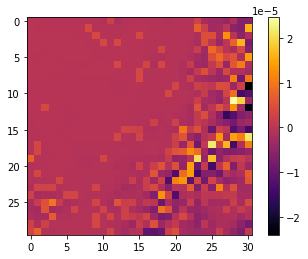

19 7


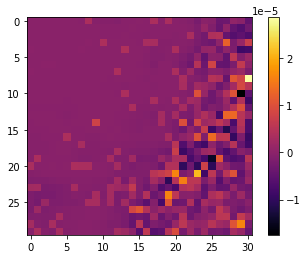

19 8


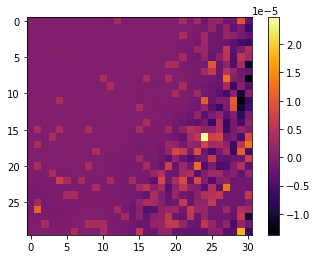

19 9


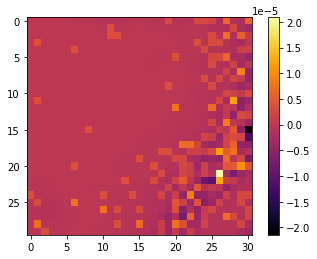

19 10


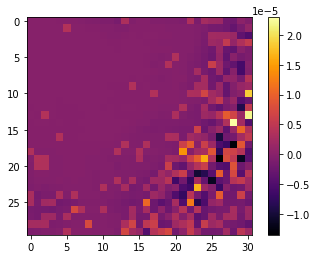

19 11


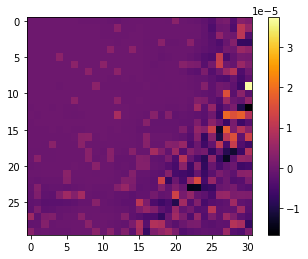

19 12


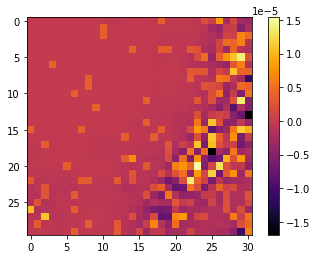

19 13


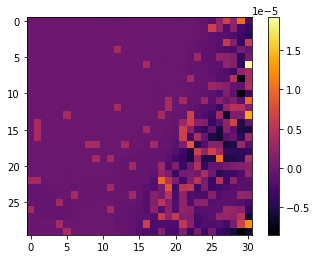

19 14


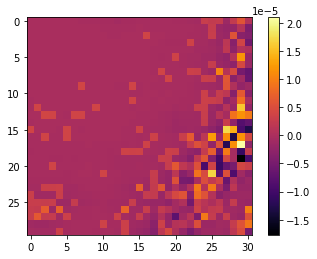

19 15


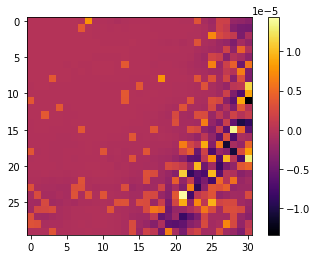

19 16


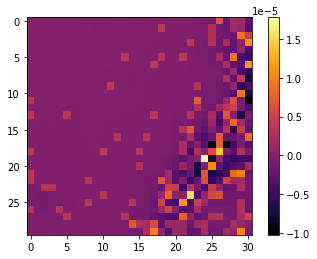

19 17


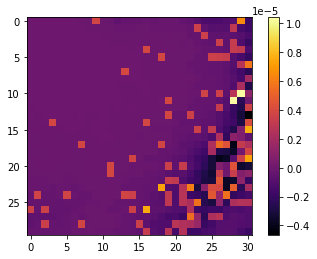

19 18


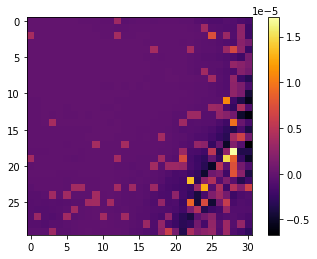

19 19


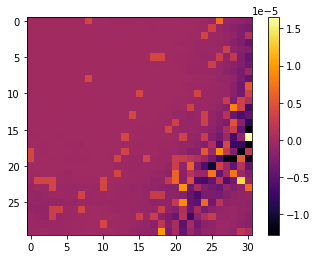

19 20


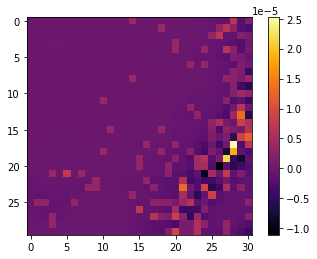

19 21


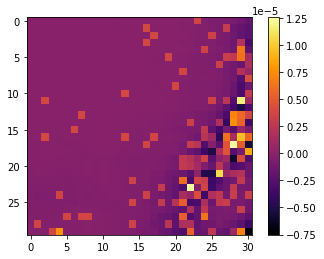

19 22


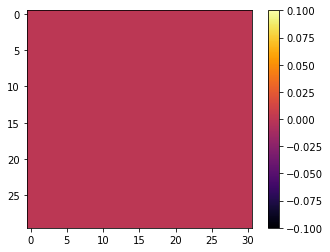

19 23


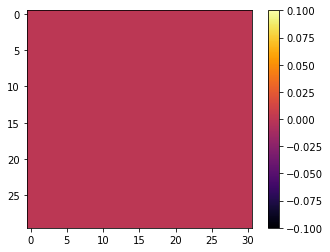

20 0


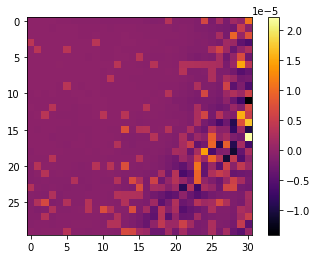

20 1


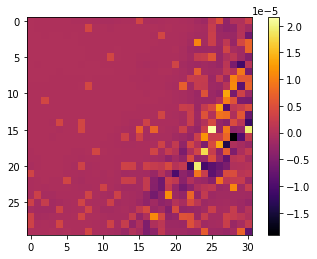

20 2


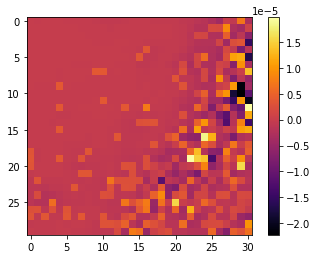

20 3


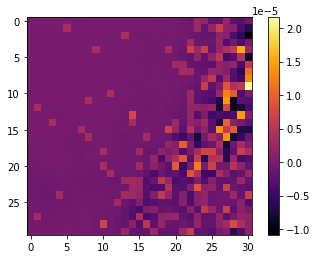

20 4


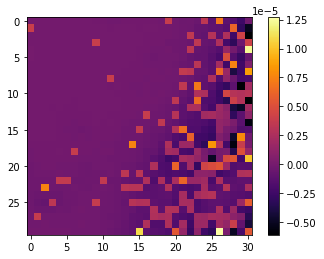

20 5


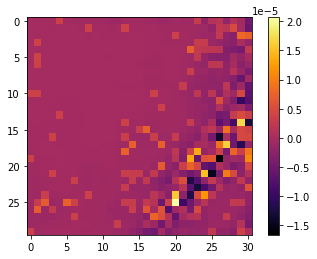

20 6


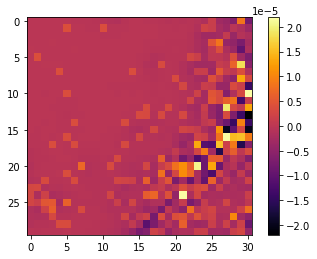

20 7


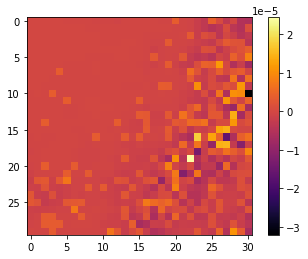

20 8


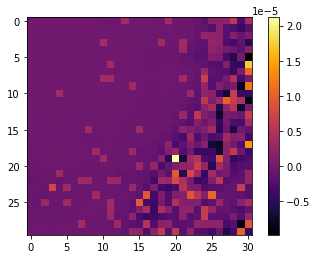

20 9


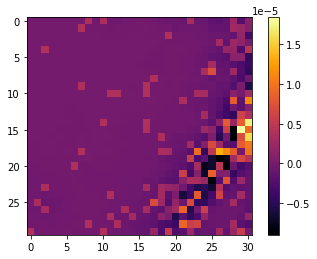

20 10


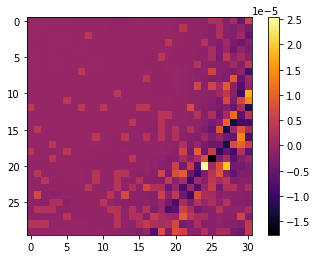

20 11


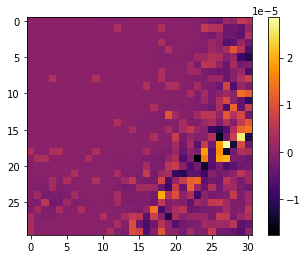

20 12


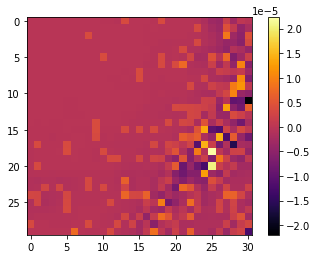

20 13


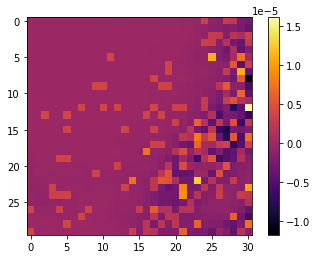

20 14


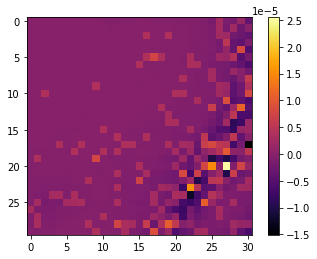

20 15


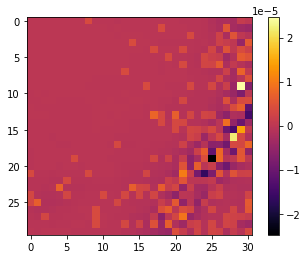

20 16


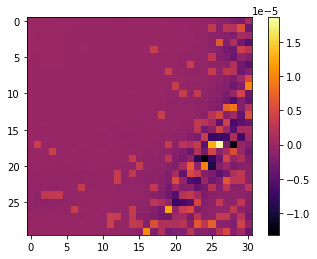

20 17


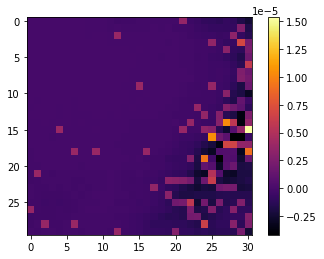

20 18


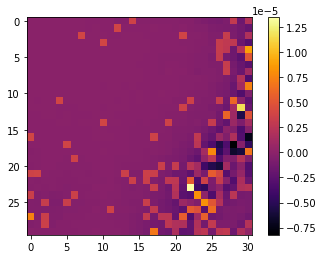

20 19


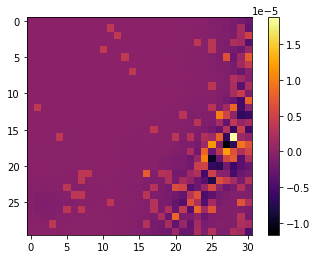

20 20


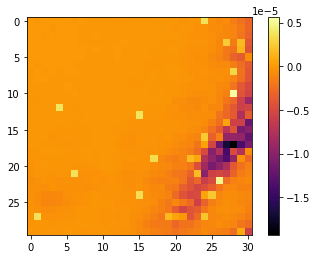

20 21


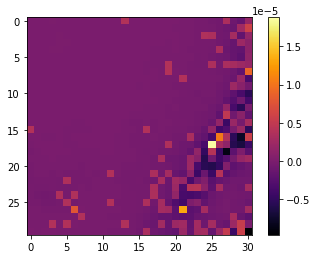

20 22


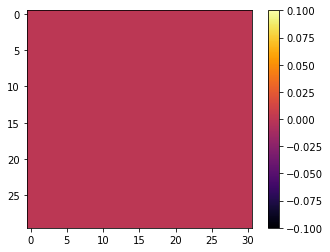

20 23


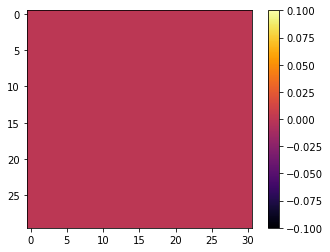

21 0


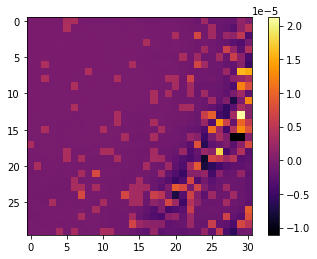

21 1


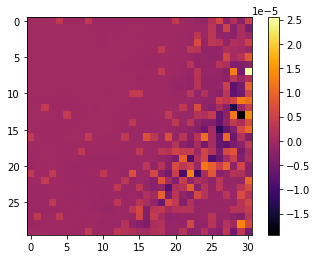

21 2


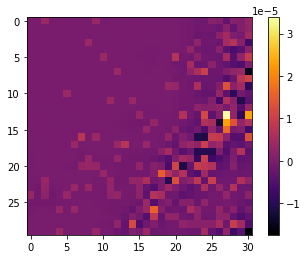

21 3


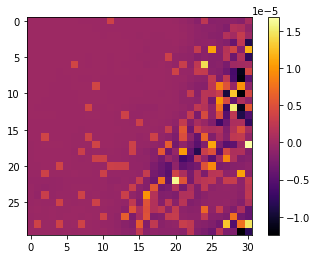

21 4


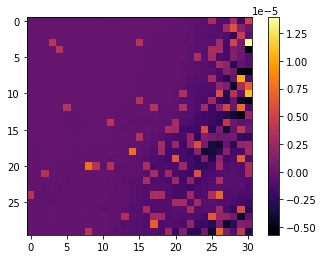

21 5


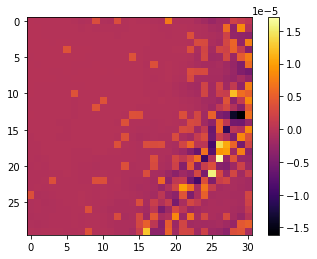

21 6


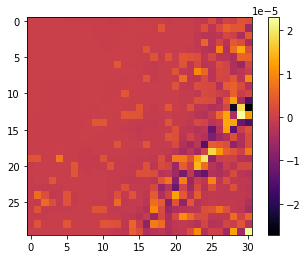

21 7


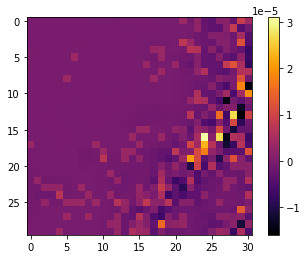

21 8


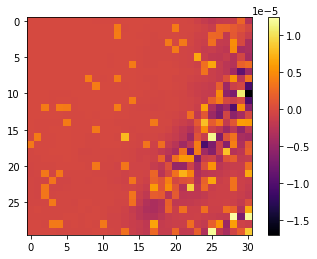

21 9


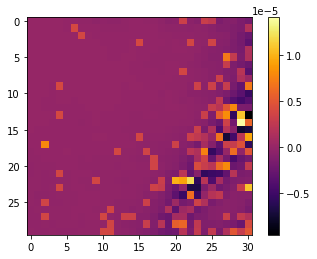

21 10


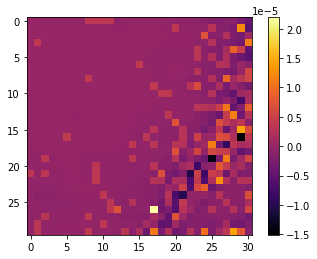

21 11


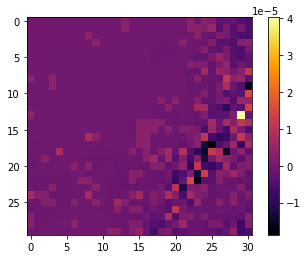

21 12


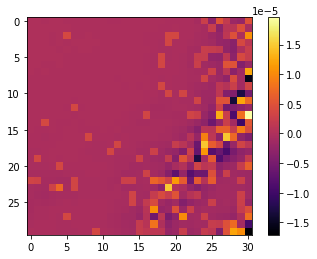

21 13


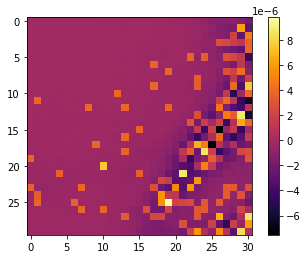

21 14


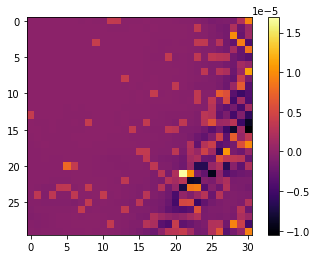

21 15


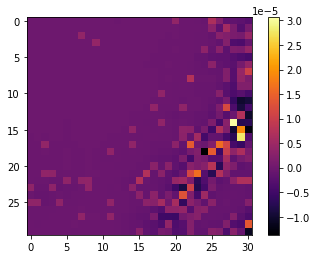

21 16


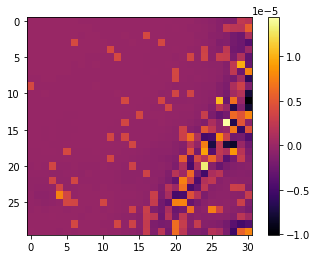

21 17


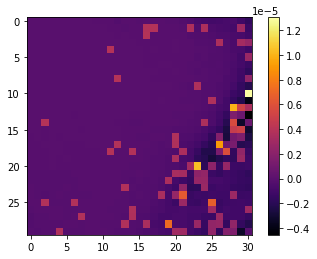

21 18


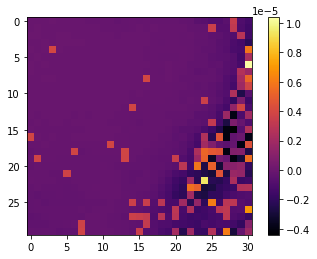

21 19


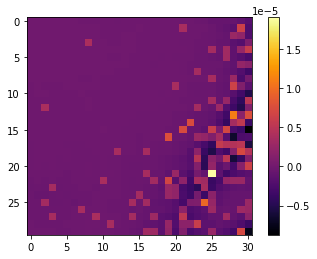

21 20


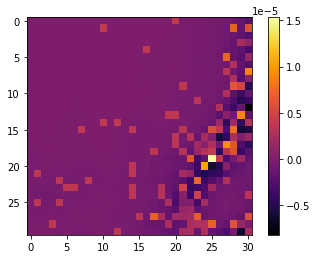

21 21


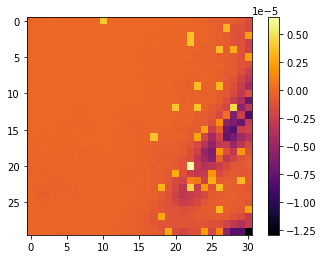

21 22


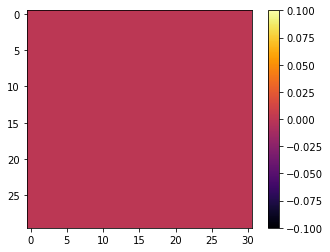

21 23


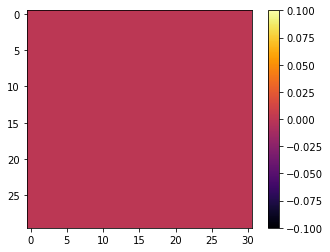

22 0


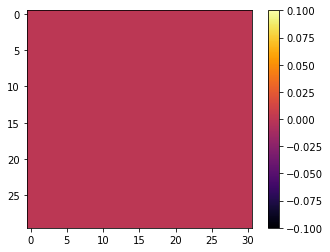

22 1


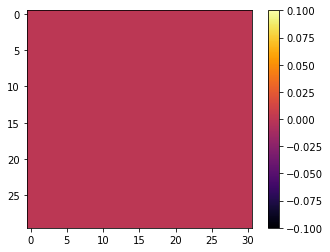

22 2


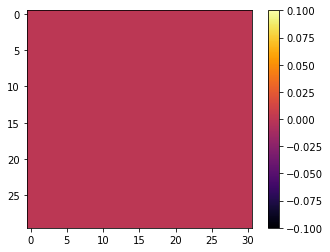

22 3


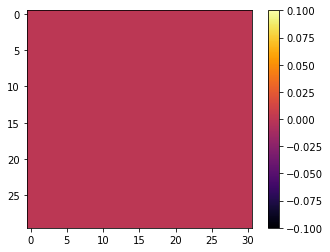

22 4


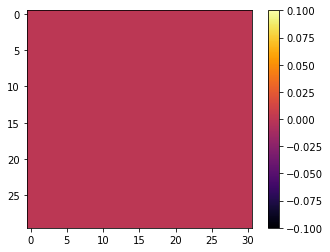

22 5


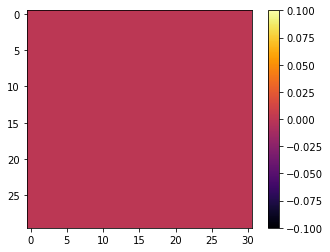

22 6


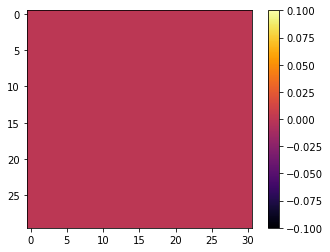

22 7


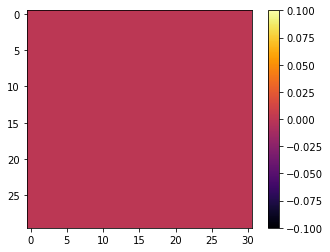

22 8


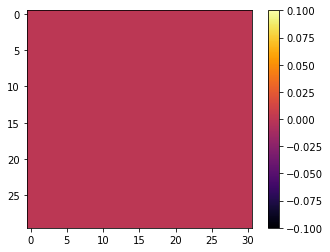

22 9


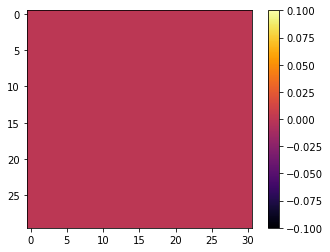

22 10


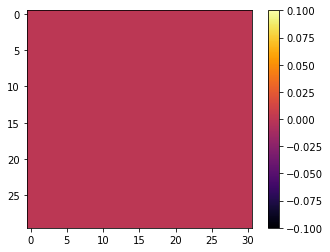

22 11


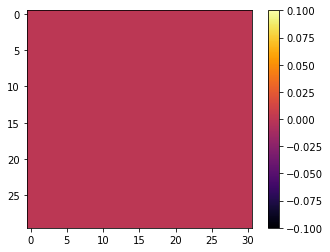

22 12


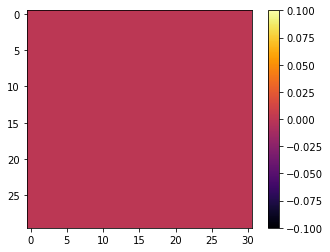

22 13


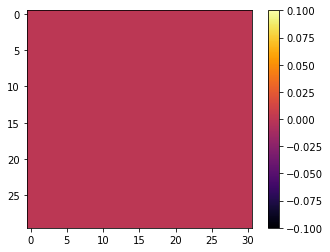

22 14


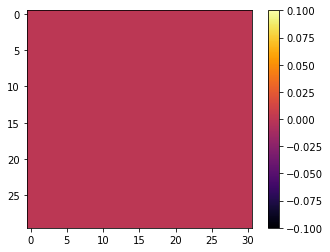

22 15


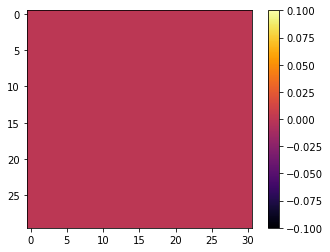

22 16


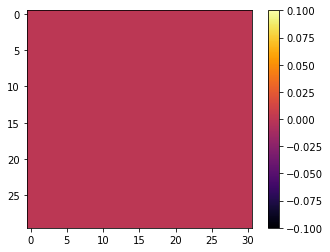

22 17


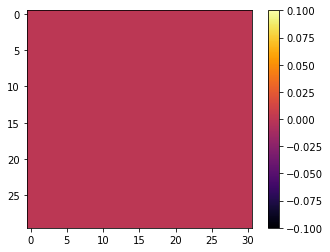

22 18


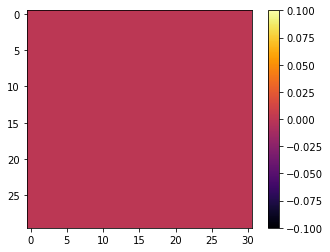

22 19


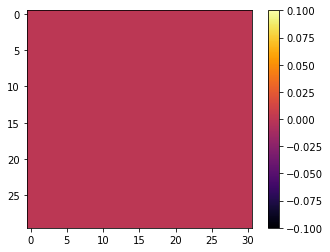

22 20


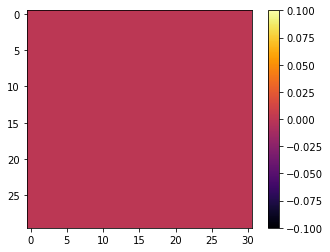

22 21


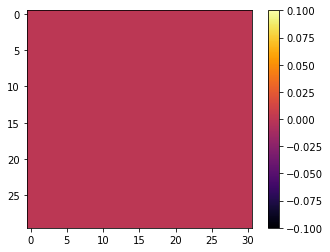

22 22


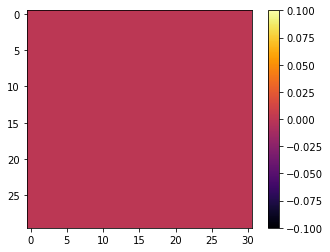

22 23


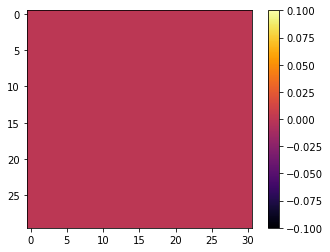

23 0


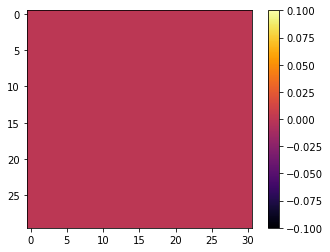

23 1


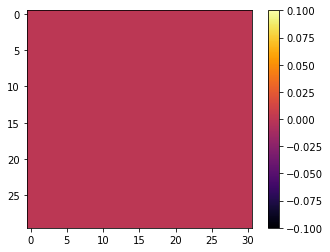

23 2


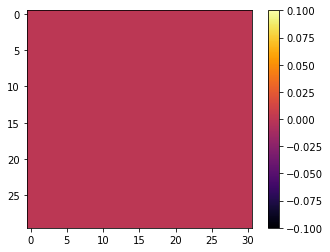

23 3


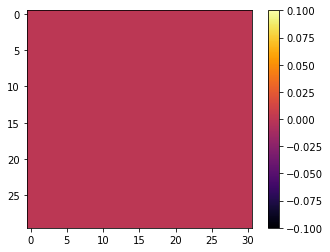

23 4


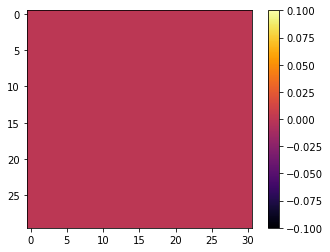

23 5


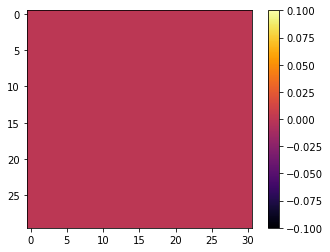

23 6


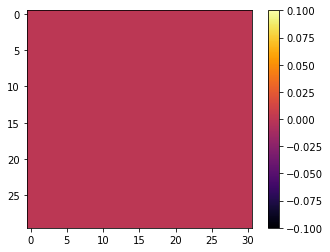

23 7


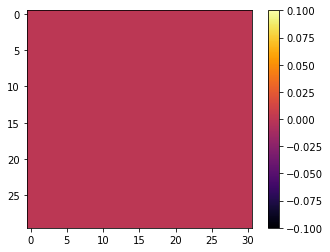

23 8


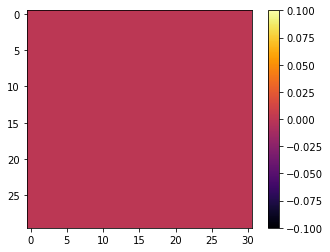

23 9


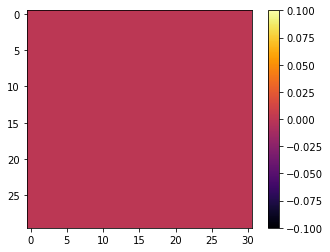

23 10


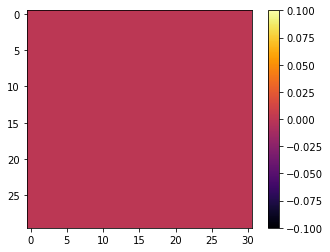

23 11


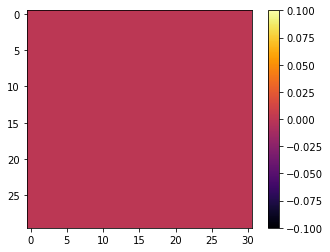

23 12


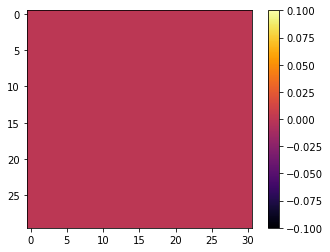

23 13


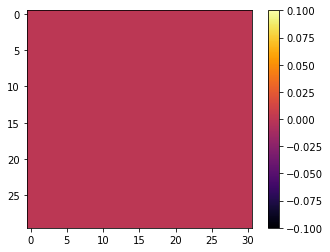

23 14


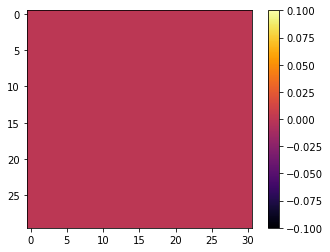

23 15


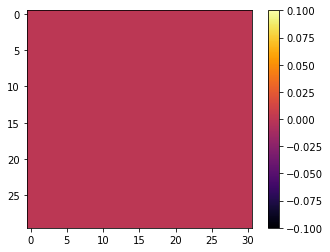

23 16


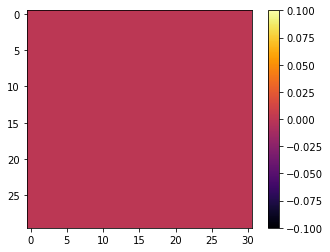

23 17


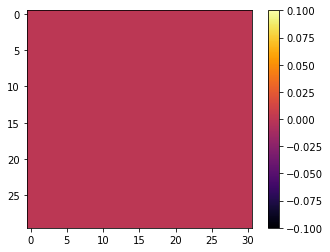

23 18


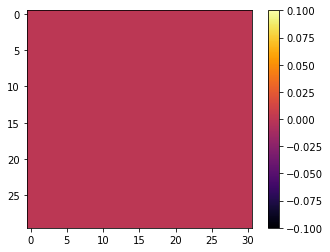

23 19


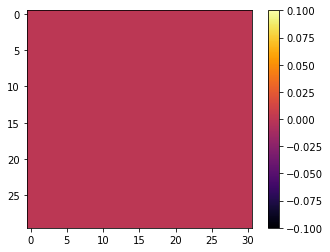

23 20


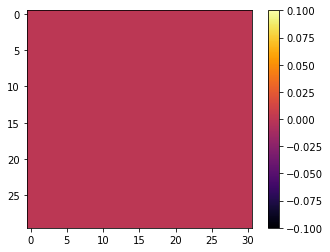

23 21


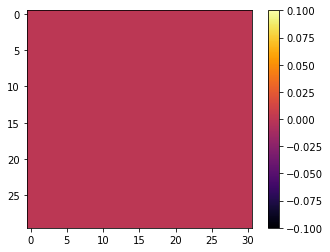

23 22


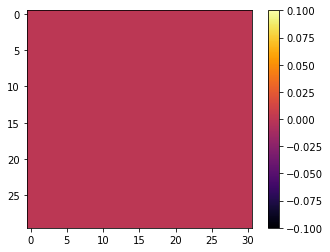

23 23


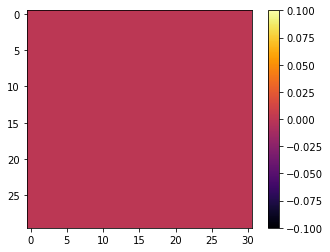

In [24]:
for i in range(scans.shape[-1]):
    for j in range(scans.shape[-1]):
        print(i,j)
        plt.imshow(A[i,j,:,:])
        plt.colorbar()
        plt.show()

In [29]:
M=[[i!=j for i in range(scans.shape[-1])]for j in range(scans.shape[-1])]
M=np.array(M)
plt.imshow(M)

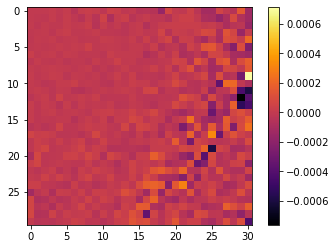

In [38]:
plt.imshow((A[M,:,:]).sum(axis=0))
plt.colorbar()

In [21]:
((scans[0,1:,:,:,0]-scans[0,1:,:,:,0].mean(axis=0))*(scans[0,:-1,:,:,0]-scans[0,:-1,:,:,0].mean(axis=0))).mean(axis=0).shape

(30, 31)

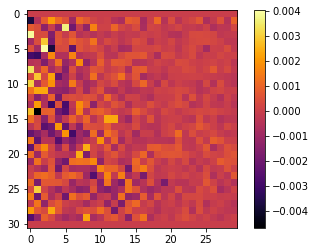

In [27]:
plt.imshow((xc2.T))
plt.colorbar()

In [20]:
xc22=si.get_xc2(scans2[0,:,:,:,:],va,vb,2)

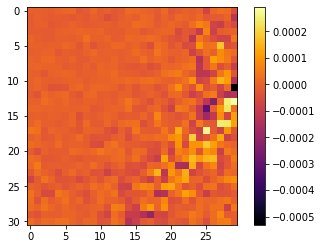

In [12]:
plt.imshow(-xc22.T)
plt.colorbar()

In [39]:
xc23=si.get_xc2(scans[0,:,:,:,:],va,vb,3)

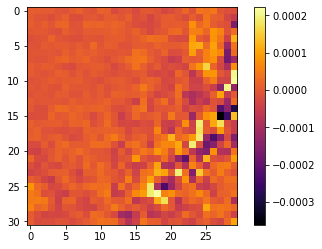

In [41]:
plt.imshow(xc23.T)
plt.colorbar()

In [22]:
def photon_finder_gaussians(image, centers):
    
    #commented for circle=1
    
    param_names = ['angle', 'd_angle', 'offset', 'd_offset', 'amplitude', 'd_amplitude', 'xo', 'd_xo', 
                   'yo', 'd_yo', 'sx', 'd_sx', 'sy', 'd_sy']
    res = {name: [] for name in param_names}
    
    for c in centers:
        xo, yo = tuple(map(int, c))
        fit, cov_p, infodict, errmsg = sofi.gaussfit(image, circle=0, return_all=1)
        N = np.size(image)
        n = len(fit)
        s_sq = (infodict['fvec']**2).sum()/ (N-n) # infodict already contains f(x)-y, which is needed
        cov = cov_p * s_sq
        stds = [np.sqrt(cov[i][i]) for i in range(len(fit))]
        #params = dict(zip(param_names, np.round(fit, 6)))
        params = dict(zip(param_names, np.round(fit, 7)))
        #const, amp, x, y, s, angle = fit
        const, amp, x, y, sx, sy, angle = fit
        #x +=5
        #y +=5
        res['offset'].append(const)
        res['amplitude'].append(amp)
        res['xo'].append(x)
        res['yo'].append(y)
        #res['s'].append(s)
        res['sy'].append(sy)
        res['sx'].append(sx)
        res['angle'].append(angle)
        res['d_offset'].append(stds[0])
        res['d_amplitude'].append(stds[1])
        res['d_xo'].append(stds[2])
        res['d_yo'].append(stds[3])
        res['d_sx'].append(stds[4])
        res['d_sy'].append(stds[5])
        res['d_angle'].append(stds[6])
        
        
    #fits = pd.DataFrame(res)
    #positions = pd.DataFrame(centers, columns=['xo', 'yo'])
        
    return res

In [5]:
scans=np.zeros((1,scans.shape[0],scans.shape[1],scans.shape[2],scans.shape[3]+2))
scans[0,:,:,:,:-2]=np.load('scans/Adrian_v3_19_6_1uW_5Mhz.npy')


In [6]:
scans.shape

(1, 100000, 30, 31, 25)

In [7]:
scans.var(axis=(1,2,3))

array([[0.00447016, 0.00162538, 0.00169473, 0.00163407, 0.00153236,
        0.00177867, 0.00181808, 0.0018782 , 0.00181295, 0.00177909,
        0.00210213, 0.00225072, 0.00214878, 0.00186607, 0.        ,
        0.00241727, 0.0024497 , 0.00216013, 0.00178695, 0.00219879,
        0.00241598, 0.00228192, 0.00193958, 0.        , 0.        ]])

In [8]:
0.45*633/2.8

101.73214285714288

In [9]:
0.45*647/2.8

103.98214285714288

In [63]:
IMG=np.loadtxt('psf_beads_06_07_2020_2.asc')

NameError: name 'figsize' is not defined

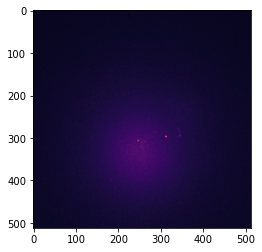

In [64]:
plt.imshow(IMG)
figsize

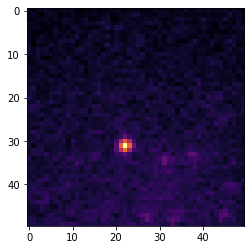

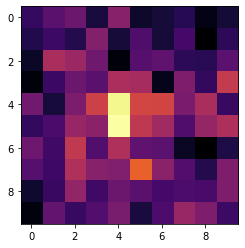

In [65]:
plt.imshow(IMG[275:325,225:275])
plt.show()
plt.imshow(IMG[305:315,252:262])
plt.show()

In [66]:
h=IMG[275:325,225:275]
centers=si.find_max_index(h)
res=photon_finder_gaussians(h, centers)

In [67]:
print(res)

{'angle': [287.2571613486235], 'd_angle': [11.173691974032634], 'offset': [2249.5013578148396], 'd_offset': [47.11050674488541], 'amplitude': [917.1197618675262], 'd_amplitude': [44.747535557348215], 'xo': [42.02369747268365], 'd_xo': [1.194859425686565], 'yo': [27.07969941864868], 'd_yo': [0.7022932778719834], 'sx': [22.517356442053952], 'd_sx': [1.4263906602004006], 'sy': [19.331082165652653], 'd_sy': [1.7002835564800516]}


In [68]:
sigma=(abs(res['sx'][0])+abs(res['sy'][0]))/2

In [69]:
#new new
1000*sigma*16/100

3347.8750886165285

In [114]:
#new1
1000*sigma*16/100

198.85672081776124

In [124]:
#new2
1000*sigma*16/100

167.1885616914207

In [28]:
1000*sigma*16/100

381.17547943034754

In [35]:
1000*sigma*16/100

373.2451735020535

In [42]:
1000*sigma*16/100

401.36025721865803

In [48]:
1000*sigma*16/100

397.9268689255921

In [54]:
1000*sigma*16/100

339.4170045934915

In [61]:
1000*sigma*16/100

316.73265024398887

In [67]:
1000*sigma*16/100

283.6832184786303

In [73]:
1000*sigma*16/100

375.2720574024053

In [79]:
1000*sigma*16/100

336.85023347492273

In [85]:
1000*sigma*16/100

416.8510184841773

In [91]:
1000*sigma*16/100

365.8124286404636

In [128]:
1000*sigma*16/100

167.1885616914207

In [ ]:
5

In [157]:
'\t'

'\t'

In [216]:
film=np.loadtxt('data/IXON/blinking_10ms_AF647_v5.asc')

In [217]:
film.shape

(307200, 257)

In [206]:
307200/256

1200.0

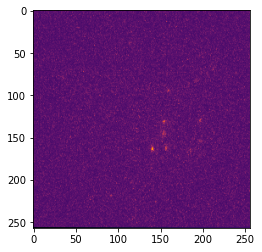

In [178]:
i=100

plt.imshow(film[256*i:256*(i+1),:].T[::-1,:])

In [218]:
film2=np.zeros((film.shape[0]//256,257,256))
for i in range((film.shape[0]//256)):
    film2[i,:,:]=film[256*i:256*(i+1),:].T[::-1,:]


In [213]:
for i in range(100):
    sofi2+=sofi.autocumulant_2(film2,2+i)

In [211]:
sofi2=np.array(sofi2)

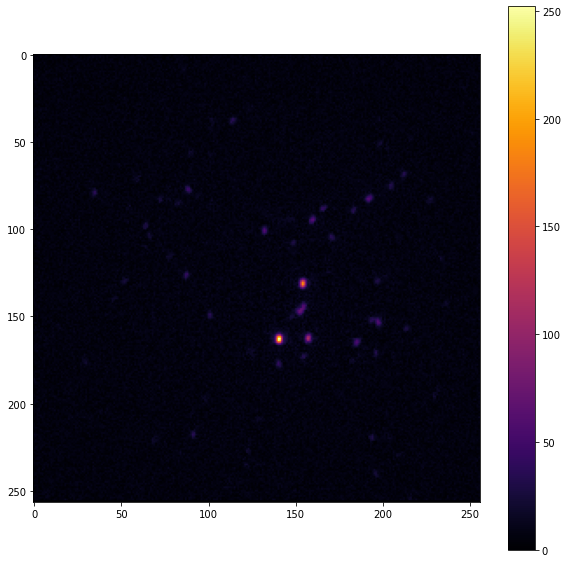

In [202]:
plt.figure(figsize=(10,10)) 
plt.imshow(np.abs(sofi2)**0.5)
plt.colorbar()

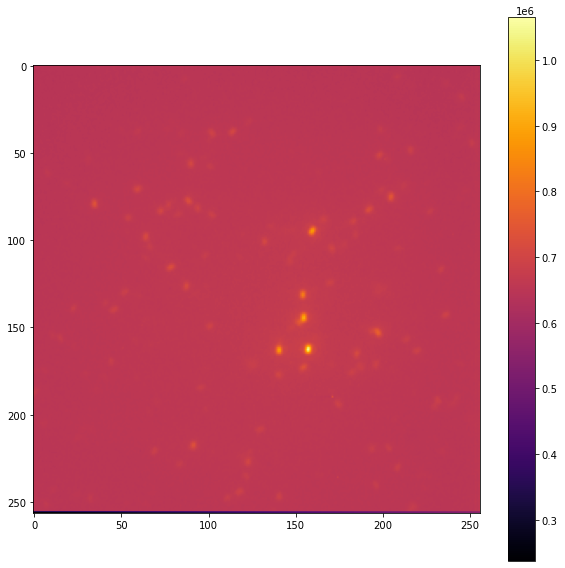

In [191]:
plt.figure(figsize=(10,10))
plt.imshow(film2.sum(axis=0)[1:,:])
plt.colorbar()

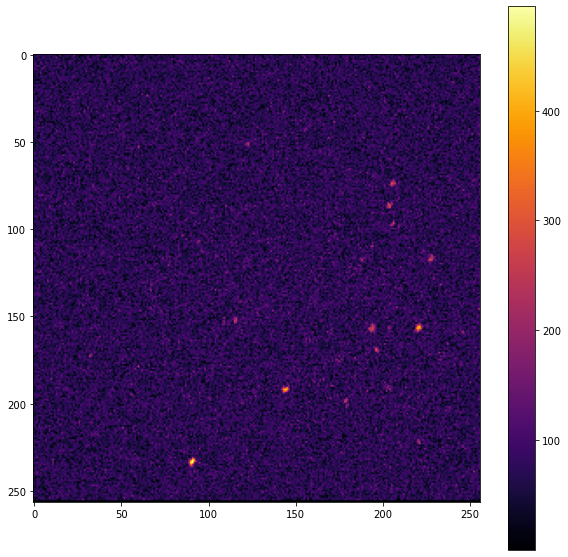

In [214]:
plt.figure(figsize=(10,10)) 
plt.imshow(np.abs(sofi2)**0.5)
plt.colorbar()

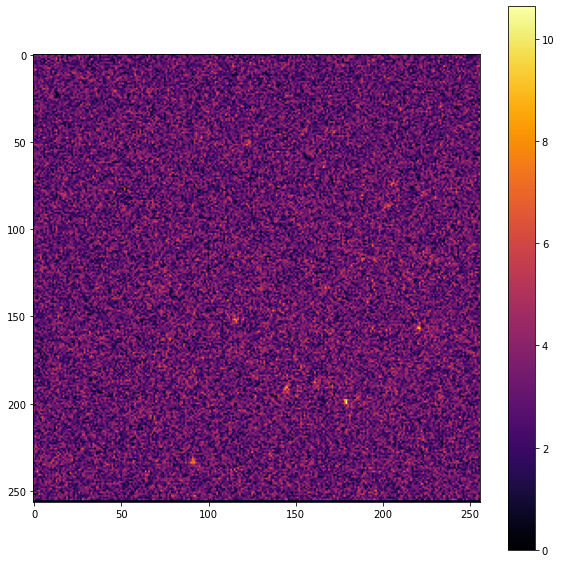

In [212]:
plt.figure(figsize=(10,10)) 
plt.imshow(np.abs(sofi2)**0.5)
plt.colorbar()

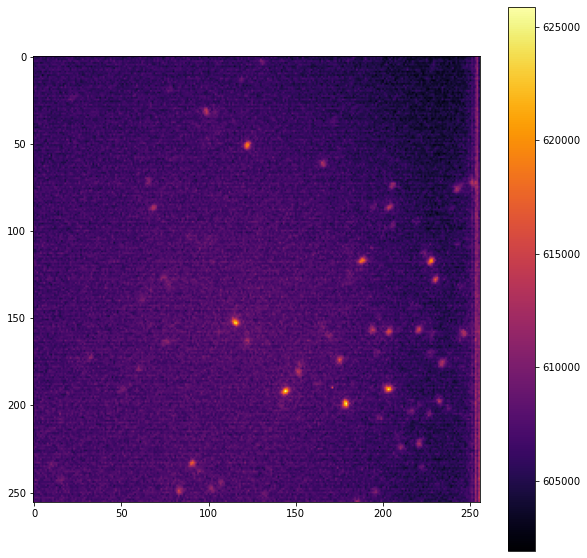

In [215]:
plt.figure(figsize=(10,10))
plt.imshow(film2.sum(axis=0)[:-1,:])
plt.colorbar()